# Analyis for the Dark Machines Collider Unsupervised Challenge
This notebook examines the results for the [hackathon dataset](https://zenodo.org/record/3961917#.X2tooJNKhQM). The methods were trained on background only samples and then applied to a mix of background and signal. In this step of the challenge, truth information was available. This was used to determine the receiver operating characteristic (ROC) curve, the area under the ROC curve (AUC), and the signal effeficency at different fixed background rejection working points.

There are 1041 different models which were submitted. They are applied to 19 different dark matter signals across 4 channels, for a combined 34 unique channel + signature combinations.

Notebook author: Bryan Ostdiek (bostdiek at g.harvard.edu)

In [1]:
import pickle
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gs
from matplotlib.patches import Patch

from scipy.interpolate import interp1d

from os import walk, path

from sklearn.metrics import roc_curve, auc
from sklearn.cluster import KMeans, DBSCAN
from sklearn.preprocessing import MinMaxScaler

In [2]:
plt.rcParams.update({'font.family': 'cmr10',
                     'font.size': 12,
                     'axes.unicode_minus': False,
                     'axes.labelsize': 12,
                     'axes.labelsize': 12,
                     'figure.figsize': (4, 4),
                     'figure.dpi': 160,
                     'mathtext.fontset': 'cm',
                     'mathtext.rm': 'serif',
                     'xtick.direction': 'in',
                     'ytick.direction': 'in',
                     'xtick.top': True,
                     'ytick.right': True
                     })

# Load Data Files
## Adam Leinweber - Traditional VAE

In [3]:
AL = pd.read_csv('../data/all_csv/Adam_Leinweber_latent_combined_scores_all.csv',
            names=['Signal', 'Model', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
           )

## Pratik Jawahar - Normalizing Flows

In [4]:
PJ = pd.read_csv('../data/all_csv/VAEwNormFlows_Results.csv',
                 names=['Signal', 'Model', 'AUC', '1e-2', '1e-3', '1e-4']
           )
snames = list(PJ['Signal'])
chan = [s.split('/')[0].replace('chan', '').replace('_sig', '') for s in snames]
snames = [s.split('/')[-1] for s in snames]

snames = ['_'.join(s.split('_')[:-1]) for s in snames]
PJ['Signal'] = snames
PJ['Chan'] = chan

## Alessandro Morandini - Density based models

In [5]:
AM = pd.read_csv('../data/all_csv/DE_scores.csv',
                 names=['Signal', 'Model', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
                )

## Luc Hendrix - VAE_AUC

In [6]:
LH_VAE = pd.read_csv('../data/all_csv/vae_auc_scores.csv',
                     names=['Signal', 'Modelt', 'Metric', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
                    )
LH_VAE['Model'] = LH_VAE['Modelt'] + '_' + LH_VAE['Metric']
LH_VAE['Model'] = [s.replace('VAE Radius', 'Fixed target KL') for s in list(LH_VAE['Model'])]

## Luc Hendrix - Flow

In [7]:
LH_Flow = pd.read_csv('../data/all_csv/flow_auc_scores.csv',
                     names=['Signal', 'Modelt', 'Metric', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
                    )
LH_Flow['Model'] = LH_Flow['Modelt'] + '_' + LH_Flow['Metric']
LH_Flow['Model'] = [s.replace('VAE Radius', 'Fixed target KL') for s in list(LH_Flow['Model'])]

## Luc Hendrix - Combined

In [8]:
LH_Combined = pd.read_csv('../data/all_csv/combined_scores.csv',
                     names=['Signal', 'Modelt', 'Metric', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
                    )
LH_Combined['Model'] = LH_Combined['Modelt'] + '_' + LH_Combined['Metric']
LH_Combined['Model'] = [s.replace('VAE Radius', 'Fixed target KL') for s in list(LH_Combined['Model'])]

In [9]:
LH_Combined2 = pd.read_csv('../data/all_csv/LH_combined_scores_2.csv',
                     names=['Signal', 'Modelt', 'Metric', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
                    )
LH_Combined2['Model'] = LH_Combined2['Modelt'] + '_' + LH_Combined2['Metric']
LH_Combined2['Model'] = [s.replace('VAE Radius', 'Fixed target KL') for s in list(LH_Combined2['Model'])]

## Luc Hendrix - Fixed Target

In [10]:
LH_Fixed = pd.read_csv('../data/all_csv/results-fixed-target.csv',
                     names=['Signal', 'Modelt', 'Metric', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
                    )
LH_Fixed['Model'] = LH_Fixed['Modelt'] + '_' + LH_Fixed['Metric']

## Bryan Ostdiek - Deep Sets

In [11]:
BO = pd.read_csv('../data/all_csv/DeepSetsVAE_8d_results_combined.csv')
snames = list(BO['Signal'])
chan = [s.split('_')[-1].replace('chan', '') for s in snames]
sig = ['_'.join(s.split('_')[:-1]) for s in snames]
BO['Signal'] = sig
BO['Chan'] = chan
BO['Model'] = BO['ModelName']
BO['1e-2'] = BO['S1e-2']
BO['1e-3'] = BO['S1e-3']
BO['1e-4'] = BO['S1e-4']

In [12]:
BO['Model'] = [s.replace('VAE_beta_1.0_', ' Fixed target KL ') for s in list(BO['Model'])]

## Baptiste Ravina - Standard Autoencoder

In [13]:
BR = pd.read_csv('../data/all_csv/CrudeAE_data.csv')
snames = list(BR['Signal'])
chan = [s.split('_')[-1].replace('chan', '') for s in snames]
sig = ['_'.join(s.split('_')[:-1]) for s in snames]
BR['Signal'] = sig
BR['Chan'] = chan
BR['Model'] = BR['ModelName']
BR['1e-2'] = BR['S1e-2']
BR['1e-3'] = BR['S1e-3']
BR['1e-4'] = BR['S1e-4']

## Joe Davies - CNN BVAE

In [14]:
JD_BVAE = pd.read_csv('../data/all_csv/cnn_bvae_results.csv')
JD_BVAE['Channel'] = JD_BVAE['Channel'].fillna(method='ffill')
JD_BVAE.fillna(0, inplace=True)
JD_BVAE['Chan'] = JD_BVAE['Channel']
JD_BVAE['1e-2'] = JD_BVAE['epsilon1']
JD_BVAE['1e-3'] = JD_BVAE['epsilon2']

# fix bad file format
JD_BVAE['1e-4'] = [float(x.strip().split(',')[0].replace('E', 'e')) for x in JD_BVAE['epsilon3']]

JD_BVAE['Model'] = 'CNN_BVAE'

In [15]:
# find singals with non-standardized notation to fix
l1 = list(JD_BVAE['Signal'].unique())
lall = list(BO['Signal'].unique())

for s in lall:
    if s not in l1:
        print(f'New signal {s}')
        
print()
for s in l1:
    if s not in lall:
        print(f'New signal {s}')

New signal monoV_Zp2000.0_DM_1.0

New signal monotop_200
New signal stop2b1000
New signal sqsq1_sq1400
New signal monoV_Zp2000.0_DM_1.0 


In [16]:
for s in lall:
    if 'sqsq1_sq1400' in s: print(s)

sqsq1_sq1400_neut800


In [17]:
JD_BVAE.loc[JD_BVAE['Signal'] == 'monoV_Zp2000.0_DM_1.0 ', 'Signal'] = 'monoV_Zp2000.0_DM_1.0'
JD_BVAE.loc[JD_BVAE['Signal'] == 'monotop_200', 'Signal'] = 'monotop_200_A'
JD_BVAE.loc[JD_BVAE['Signal'] == 'stop2b1000', 'Signal'] = 'stop2b1000_neutralino300'
JD_BVAE.loc[JD_BVAE['Signal'] == 'sqsq1_sq1400', 'Signal'] = 'sqsq1_sq1400_neut800'

l1 = list(JD_BVAE['Signal'].unique())
lall = list(BO['Signal'].unique())

for s in lall:
    if s not in l1:
        print(f'New signal {s}')
        
print()
for s in l1:
    if s not in lall:
        print(f'New signal {s}')

## JD - CNN Variational Autoencoder

In [18]:
JD_VAE = pd.read_csv('../data/all_csv/cnnvae_results.csv')
JD_VAE.fillna(method='ffill', inplace=True)
JD_VAE.fillna(0, inplace=True)
JD_VAE['Chan'] = JD_VAE['Channel']
JD_VAE['1e-2'] = JD_VAE['epsilon1']
JD_VAE['1e-3'] = JD_VAE['epsilon2']
JD_VAE['1e-4'] = JD_VAE['epsilon3']
JD_VAE['Model'] = 'CNN_VAE'

# Clean up extra spaces in signal name
JD_VAE.loc[JD_VAE['Signal'] == 'stlp_st1000 ', 'Signal'] = 'stlp_st1000'
JD_VAE.loc[JD_VAE['Signal'] == 'stop2b1000', 'Signal'] = 'stop2b1000_neutralino300'
JD_VAE.loc[JD_VAE['Signal'] == 'sqsq1_sq1400', 'Signal'] = 'sqsq1_sq1400_neut800'
JD_VAE.loc[JD_VAE['Signal'] == 'chaneut_cha250_neut150 ', 'Signal'] = 'chaneut_cha250_neut150'
JD_VAE.loc[JD_VAE['Signal'] == 'monotop_200_A ', 'Signal'] = 'monotop_200_A'

In [19]:
for s in lall:
    if 'chaneut_cha250_neut150' in s: print(s)

chaneut_cha250_neut150


In [20]:
l1 = list(JD_VAE['Signal'].unique())
lall = list(BO['Signal'].unique())

for s in lall:
    if s not in l1:
        print(f'New signal {s}')
        
        
print('in VAE but not in group')
for s in l1:
    if s not in lall:
        print(f'New signal {s}')

in VAE but not in group


## Roberto Ruiz - ALAD

In [21]:
RR_ALAD = pd.read_csv('../data/all_csv/alad_scores.csv',
                      names=['Signal', 'Modelt', 'Chan', 'Metric', 'AUC', '1e-2', '1e-3', '1e-4']
                     )
RR_ALAD['Model'] = RR_ALAD['Modelt'] + '_' + RR_ALAD['Metric']
chan = [s.split('_')[-1].replace('chan', '') for s in list(RR_ALAD['Chan'])]
RR_ALAD['Chan'] = chan
RR_ALAD.loc[RR_ALAD['Signal'] == 'monoV_Zp2000', 'Signal'] = 'monoV_Zp2000.0_DM_1.0'
RR_ALAD.loc[RR_ALAD['Signal'] == 'monojet_Zp2000.0_DM_50', 'Signal'] = 'monojet_Zp2000.0_DM_50.0'


There were incomplete section in a previous version, this code checks for those.

In [23]:
incomplete_models = []
for Chan in ['1', '2a' ,'2b', '3']:
    with open(f'Missing_ALAD_chan{Chan}.txt', 'w') as f:
        for mod in list(RR_ALAD['Model'].unique()):
            if mod not in list(RR_ALAD[RR_ALAD['Chan'] == Chan]['Model']):
                print(f'Missing Chan {Chan} for {mod}')
                f.write(f'Missing Chan {Chan} for {mod}')
                f.write('\n')
                incomplete_models.append(mod)

## Roberto Ruiz - DAGMM

In [24]:
RR_DAGM = pd.read_csv('../data/all_csv/dagmm_scores.csv',
                      names=['Signal', 'Model', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
                     )
chan = [s.replace('chan', '') for s in list(RR_DAGM['Chan'])]
RR_DAGM['Chan'] = chan

In [25]:
incomplete_models = []
for Chan in ['1', '2a' ,'2b', '3']:
    with open(f'Missing_DAGM_chan{Chan}.txt', 'w') as f:
        for mod in list(RR_DAGM['Model'].unique()):
            if mod not in list(RR_DAGM[RR_DAGM['Chan'] == Chan]['Model']):
                print(f'Missing Chan {Chan} for {mod}')
                f.write(f'Missing Chan {Chan} for {mod}')
                f.write('\n')
                incomplete_models.append(mod)

## Combine All Submissions

In [26]:
names = ['Signal', 'Model', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
AllCombined = np.array(AL[names])
AllCombined = np.vstack([AllCombined, PJ[names]])
AllCombined = np.vstack([AllCombined, AM[names]])
AllCombined = np.vstack([AllCombined, LH_VAE[names]])
AllCombined = np.vstack([AllCombined, LH_Flow[names]])
AllCombined = np.vstack([AllCombined, LH_Combined[names]])
AllCombined = np.vstack([AllCombined, LH_Combined2[names]])
AllCombined = np.vstack([AllCombined, LH_Fixed[names]])
AllCombined = np.vstack([AllCombined, BO[names]])
AllCombined = np.vstack([AllCombined, RR_ALAD[names]])  
AllCombined = np.vstack([AllCombined, RR_DAGM[names]]) 
AllCombined = np.vstack([AllCombined, BR[names]])
AllCombined = np.vstack([AllCombined, JD_VAE[names]])
AllCombined = np.vstack([AllCombined, JD_BVAE[names]])
AllCombined = pd.DataFrame(AllCombined, columns=names)

Check for models which were not applied to all of the signals.

In [27]:
incomplete_models = []
for Chan in ['1', '2a', '2b', '3']:
    for mod in list(AllCombined['Model'].unique()):
        if mod not in list(AllCombined[AllCombined['Chan'] == Chan]['Model']):
            print(f'Missing Chan {Chan} for {mod}')
            incomplete_models.append(mod)

Missing Chan 3 for Fixed-combined-z377_MSE
Missing Chan 3 for Fixed-MSE0-z377_MSE
Missing Chan 3 for Fixed-MSE1-z377_MSE
Missing Chan 3 for Fixed-MSE2-z377_MSE
Missing Chan 3 for Fixed-MSE3-z377_MSE
Missing Chan 3 for Fixed-MSE4-z377_MSE
Missing Chan 3 for Fixed-MSE10-z377_MSE
Missing Chan 3 for Fixed-MSE25-z377_MSE


Remove the incomplete models

In [28]:
AllCombined = AllCombined[~AllCombined['Model'].isin(incomplete_models)]

In [29]:
AllCombined.Model.unique().shape

(1041,)

There are over 1000 models which are being analyzed

In [30]:
AllCombined['Signal'].unique().shape

(19,)

In [31]:
(AllCombined['Chan'] + AllCombined['Signal']).unique().shape

(34,)

There are 19 different signals across the 4 channels, with 34 unique chan + signal combinations.

In [32]:
chansiglist = []
for chan in list(AllCombined['Chan'].unique()):
    tmpdf = AllCombined[AllCombined['Chan'] == chan]
    for sig in list(tmpdf['Signal'].unique()):
        chansiglist.append(f'{chan}/{sig}')

# Build Analysis Function
It is not obvious what the best metric is to use for quantifying which model performs the best. This will examine the area under the ROC curve (AUC), and the signal efficiency at three different background efficiencies $\epsilon_{s}\big(\epsilon_b = 10^{-2(-3)[-4]}\big)$. For each metric, we will then find the model which has the highest score for each signal, the models which have the top 5 scores for each signal, the average rank, the average score, and the minimum score.

The plots will combine the best models under each metric into a single plot, then the plot is iterated, for each metric, highlighting the specific models that are best under that metric.

In [33]:
def Analyze(CombinedDataFrame, Chan, Metric, MetricNumberDict, Plot):
    """
    Inputs:
        CombineedDataFrame: Pandas dataframe with columns ['Model', 'Signal', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
        Chan: String with which signal chanel is being analyzed. Must be one of ['1', '2a', '2b', '3', 'All']
        Metric: String indicating the metric to use, must be one of ['AUC', '1e-2', '1e-3', '1e-4']
        MetricNumberDict: The number of models to include for each sorting. Will usually include 5, 
            but some of the rankings need different numbers.
            example: MetricNumberDict = {'top1': 5, 
                                         'top5': 5,
                                         'AverageRank': 5,
                                         'MeanScore': 5,
                                         'MedianScore': 5,
                                         'MinScore': 5}
        Plot: Boolean if to make bar plots or not
        
    """
    for col in ['Model', 'Signal', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']:
        if col not in CombinedDataFrame.columns:
            print(f'CombinedDataFrame is missing column {col}')
            return 0
    if Chan not in ['1', '2a', '2b', '3', 'All']:
        print(f'Invalid "Chan" selection: {Chan}')
        return 0
    if Metric not in ['AUC', '1e-2', '1e-3', '1e-4']:
        print(f'Invalid "Metric" selection: {Metric}')
        return 0
    
    if Chan != 'All':
        AnalyzeFrame = CombinedDataFrame[CombinedDataFrame['Chan'] == Chan]
    else:
        AnalyzeFrame = CombinedDataFrame
    
    # This helper variable combines the channel and signal since some signals appear in multiple channels
    chansig = AnalyzeFrame['Chan'] + '/' + AnalyzeFrame['Signal']
    chansig = np.unique(chansig)
    sigs = AnalyzeFrame.Signal.unique()
    mods = AnalyzeFrame.Model.unique()
    SortedScores = pd.DataFrame()
    SortedScores['Model'] = mods
    
    # Go through each of the signals to find the ranking of the models
    for sig in chansig:
        chan, sig = sig.split('/')
        print(chan, sig )
        cs = AnalyzeFrame[(AnalyzeFrame['Signal'] == sig) & (AnalyzeFrame['Chan']==chan)]
        scorelist = cs[Metric]
        score_ranking = np.zeros_like(scorelist)
        for i, score in enumerate(np.argsort(-scorelist)):  # argsort gives the ordering to sort them, we want the orthogonal information
            score_ranking[score] = i
        SortedScores[sig] = score_ranking
    SortedScores['AverageRank'] = SortedScores[[col for col in SortedScores.columns if 'Model' not in col]].mean(axis=1)
    SortedScores['top1'] = (SortedScores[[col for col in SortedScores.columns if (('AverageRank' not in col)
                                                                                  and ('Model' not in col)
                                                                                 )]] < 1).sum(axis=1)
    SortedScores['top5'] = (SortedScores[[col for col in SortedScores.columns if (('AverageRank' not in col) and 
                                                                                  ('top1' not in col) and
                                                                                  ('Model' not in col)
                                                                                 )]] < 5).sum(axis=1)

    meanscore = []
    medianscore = []
    minscore = []
    for m in mods:
        tmpdf = AnalyzeFrame[AnalyzeFrame['Model'] == m]
        tmpscores = tmpdf[Metric]
        meanscore.append(tmpscores.mean())
        medianscore.append(tmpscores.median())
        minscore.append(tmpscores.min())
    SortedScores['MeanScore'] = meanscore
    SortedScores['MedianScore'] = medianscore
    SortedScores['MinScore'] = minscore
    
    BestC = []
    TopDict = {}

    for key in ['top1', 'top5', 'AverageRank', 'MeanScore', 'MedianScore', 'MinScore']:
        num = MetricNumberDict[key]
        if num == 0: continue
        TopDict[key] = SortedScores.sort_values(by=key,ascending=True if key =='AverageRank' else False)[['Model']][:num].to_numpy().reshape(num)
        BestC += list(TopDict[key])
        print('*'*40)
        print(f'Models from chan={Chan} ranked by metric={Metric} sorted by {key}')
        print(SortedScores.sort_values(by=key,ascending=True if key =='AverageRank' else False)[['Model', key]][:num])
        print('*'*40)
        print()
        
    if Plot:
        BestC = np.array(BestC).flatten()
        BestCU = np.unique(BestC)
        
        Criteria = [['Top score on a signal', TopDict['top1']],
                    ['Top 5 score on a signal', TopDict['top5']],
                    ['Average Rank', TopDict['AverageRank']],
                    ['Mean Score', TopDict['MeanScore']],
                    ['Median Score', TopDict['MedianScore']],
                    ['Minimum Score', TopDict['MinScore'] if MetricNumberDict['MinScore'] else []]
                   ]
        if MetricNumberDict['MinScore'] == 0:
            Criteria=Criteria[:-1]

        for (name, crit) in Criteria:
            plt.figure(figsize=(8, 5))
            colors = ['grey' if m not in crit else 'C0' for m in BestCU]

            for colnum, col in enumerate(['AUC', '1e-2', '1e-3', '1e-4']):
                ax = plt.subplot(1, 4, colnum + 1)
                if col == Metric:
                    ax.set_facecolor('lavenderblush')
                yvs=[]
                names = []
                data_all = []
                for i,m in enumerate(BestCU):
                    tmp_data = []
                    tmpdf = AnalyzeFrame[AnalyzeFrame['Model']==m].copy()
                    for s in chansig:
                        chan, s = s.split('/')
                        tmpauc = tmpdf[(tmpdf['Signal'] == s) & (tmpdf['Chan']==chan)][col]
                        tmp_data.append(tmpauc)
                    data_all.append(np.array([float(x) for x in tmp_data]).reshape(len(chansig)))
                    yvs.append(i)
                    names.append(m)
                databp = np.array(data_all).reshape(len(BestCU), len(chansig))
                databp[databp == 0] = 1e-10
                bbox1 = plt.boxplot(databp.T,
                            vert=False,
                            manage_ticks=False,
                            patch_artist=True,
                            medianprops={'color':'k'},
                            positions=yvs
                           )

                if colnum == 0:
                    plt.yticks(yvs, [n.replace('_', r'$\_$') for n in names])
                    plt.xlim(0, 1)
                else:
                    plt.yticks(yvs, [])
                    plt.xscale('log')
                    plt.xlim(1e-4, 1)
                    plt.xticks([1e-4, 1e-3, 1e-2, 1e-1, 1e0])


                for patch, color in zip(bbox1['boxes'], colors):
                    patch.set_facecolor(color)
                    plt.minorticks_on()
                plt.grid()
                plt.xlabel(col)

            plt.suptitle(f'Best Models on Chan:{Chan} based on {Metric}: {name}')
            plt.savefig(f'../reports/Plots/TopChan{Chan}_{Metric}_{name.replace(" ", "_")}_boxplot.pdf', bbox_inches='tight')   

# Do the analysis
## Chan 1
### AUC

1 glgl1400_neutralino1100
1 glgl1600_neutralino800
1 monojet_Zp2000.0_DM_50.0
1 monotop_200_A
1 sqsq1_sq1400_neut800
1 sqsq_sq1800_neut800
1 stlp_st1000
1 stop2b1000_neutralino300
****************************************
Models from chan=1 ranked by metric=AUC sorted by top1
                                                  Model  top1
481   Combined-FixedTarget-Flow-AVG_Fixed target MSE...     5
294                               VAE_ConvolutionalFlow     1
1038                                           crude_AE     1
479   Combined-FixedTarget-Flow-OR_Fixed target MSE ...     1
****************************************

****************************************
Models from chan=1 ranked by metric=AUC sorted by top5
                                                  Model  top5
481   Combined-FixedTarget-Flow-AVG_Fixed target MSE...     7
477      Combined-AVG_Fixed target KL + Flow Likelihood     5
479   Combined-FixedTarget-Flow-OR_Fixed target MSE ...     4
476     Combined-PROD_Fixed 

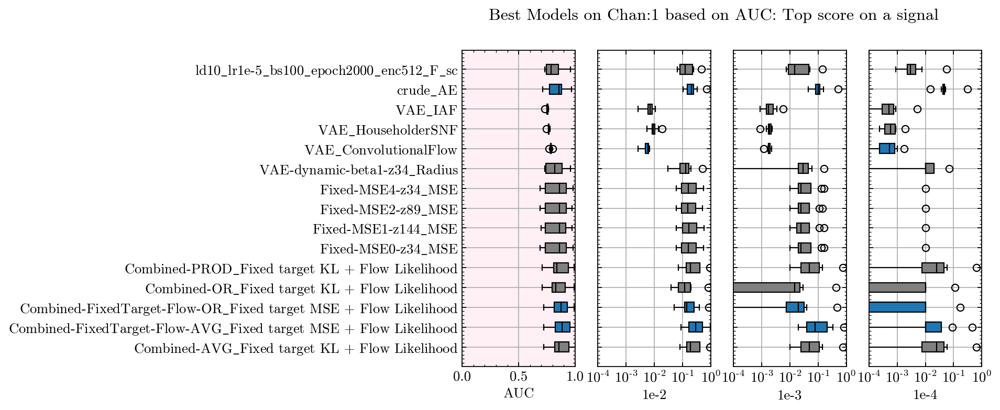

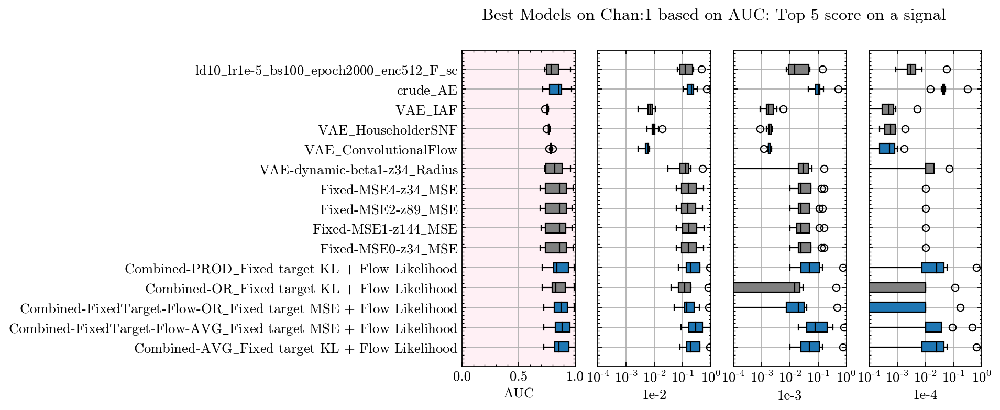

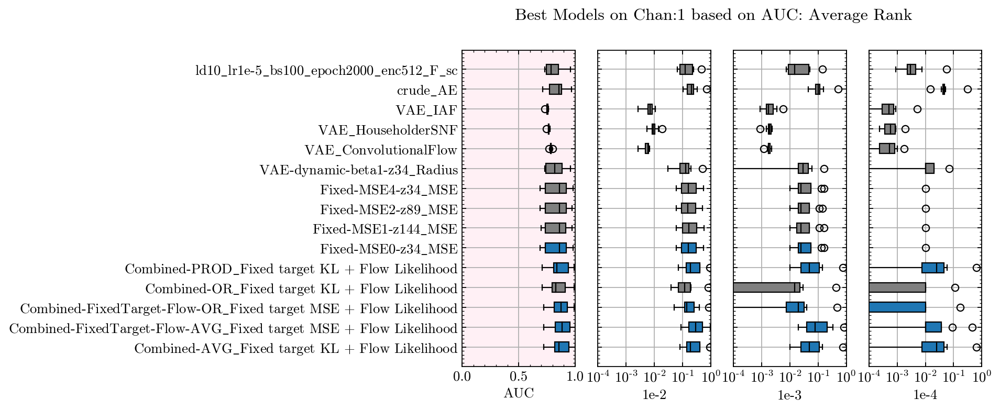

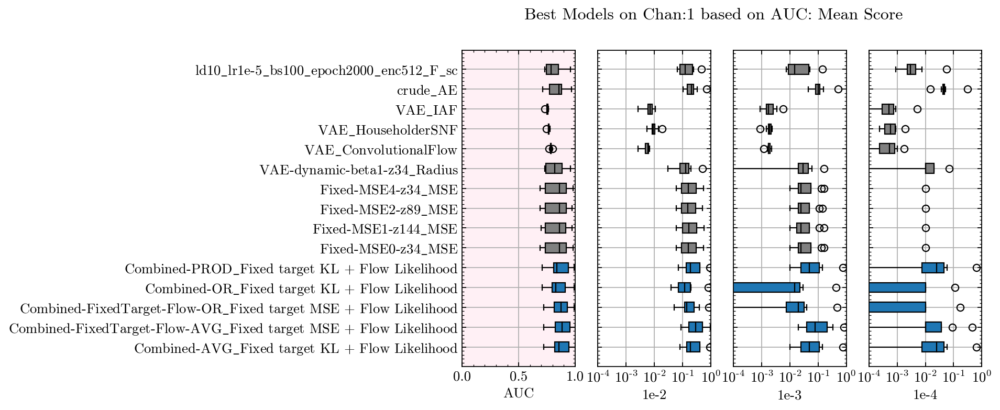

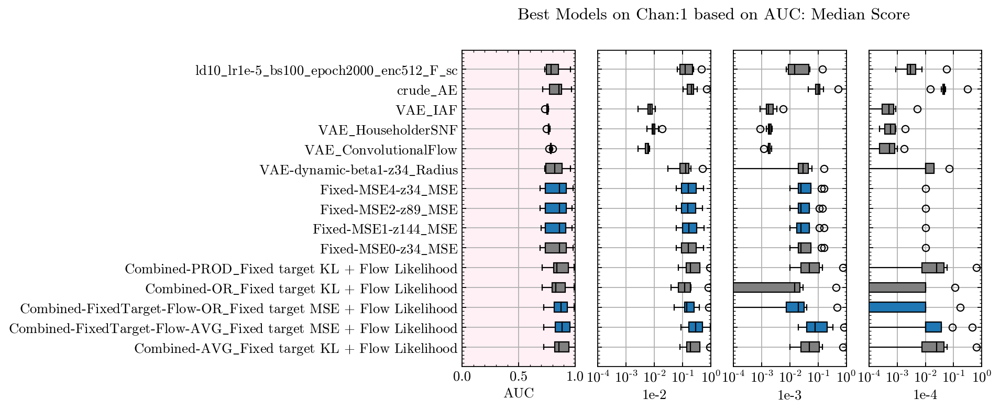

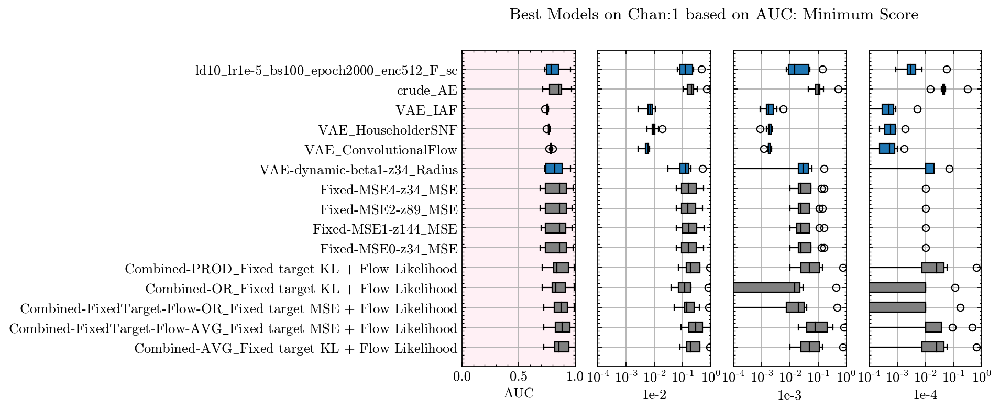

In [34]:
Analyze(AllCombined, 
        Chan='1', 
        Metric='AUC',
        MetricNumberDict = {'top1': 4,
                            'top5': 6,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-2

1 glgl1400_neutralino1100
1 glgl1600_neutralino800
1 monojet_Zp2000.0_DM_50.0
1 monotop_200_A
1 sqsq1_sq1400_neut800
1 sqsq_sq1800_neut800
1 stlp_st1000
1 stop2b1000_neutralino300
****************************************
Models from chan=1 ranked by metric=1e-2 sorted by top1
                                                  Model  top1
481   Combined-FixedTarget-Flow-AVG_Fixed target MSE...     6
1038                                           crude_AE     1
1028                   10_1e-06_1000_0.01_0.01_100_10_8     1
0                                      IF_13_0.001_1000     0
691                    20_1e-07_5000_0.001_0.01_50_10_8     0
****************************************

****************************************
Models from chan=1 ranked by metric=1e-2 sorted by top5
                                                 Model  top5
481  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     6
478  Combined-FixedTarget-Flow-AND_Fixed target MSE...     5
476    Combined-PROD_Fixed ta

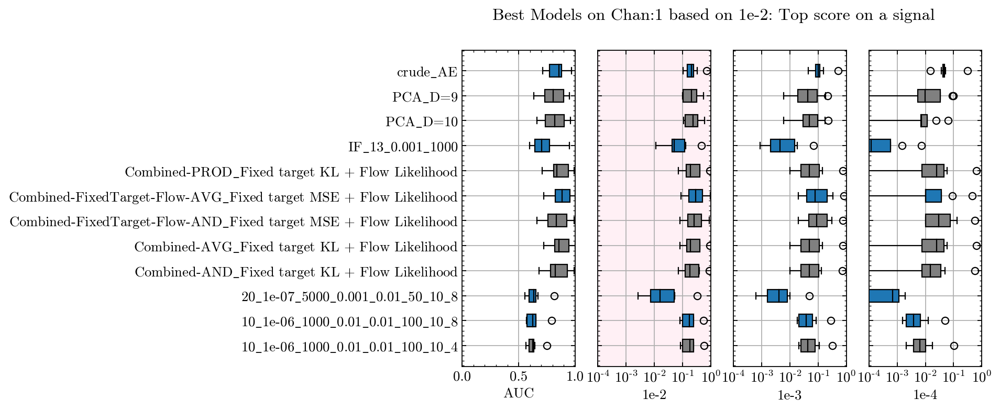

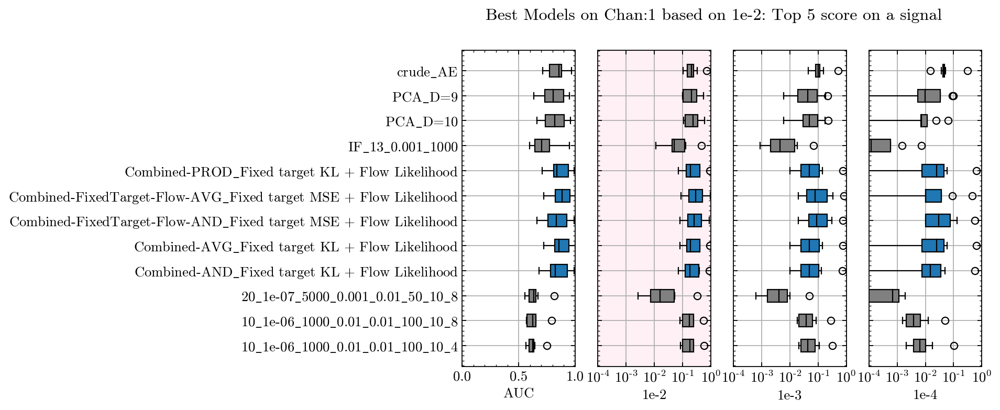

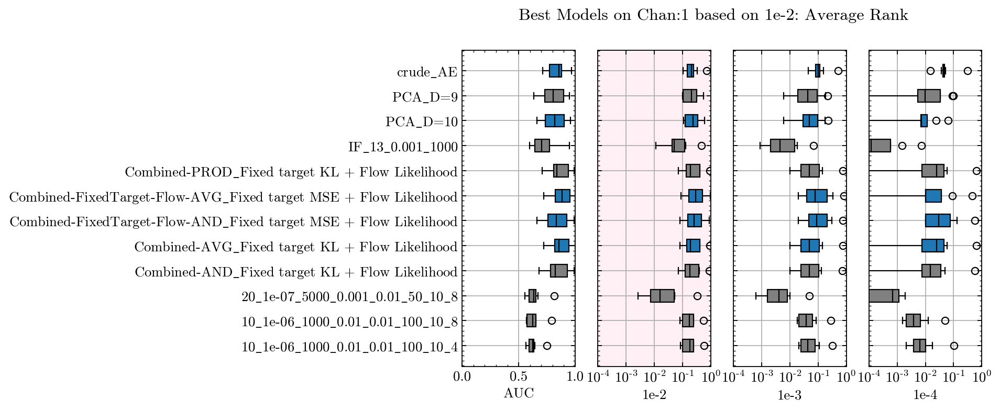

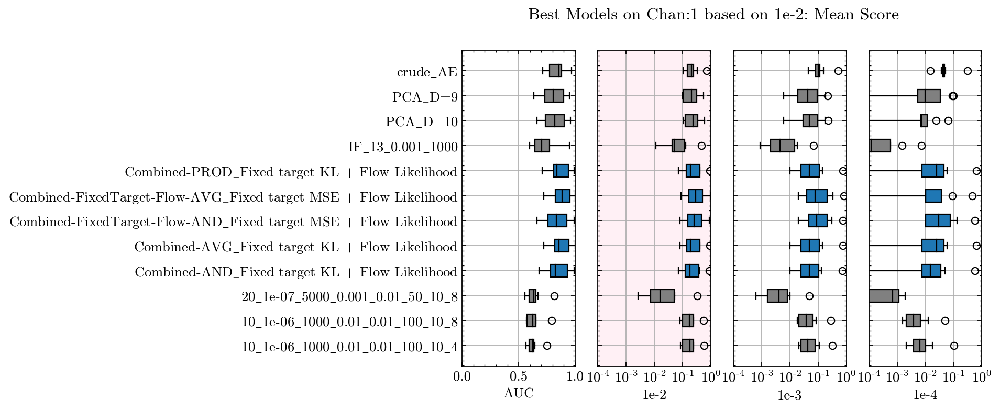

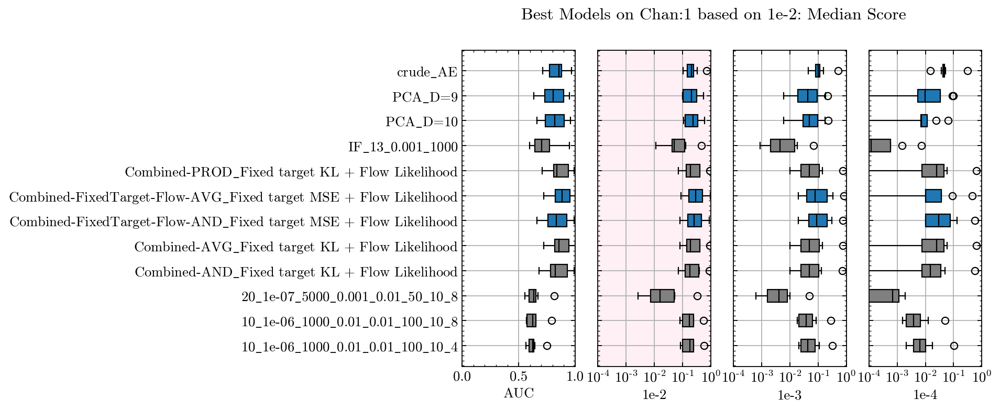

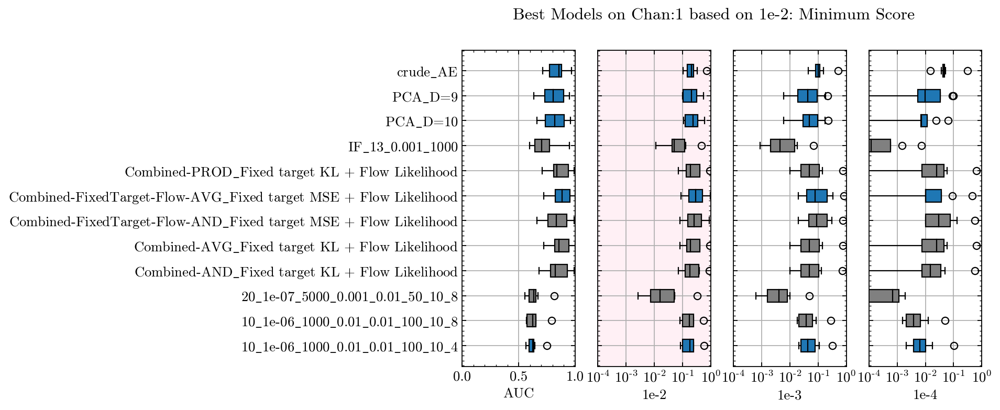

In [35]:
Analyze(AllCombined, 
        Chan='1', 
        Metric='1e-2',
        MetricNumberDict = {'top1': 5,
                            'top5': 5,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-3

1 glgl1400_neutralino1100
1 glgl1600_neutralino800
1 monojet_Zp2000.0_DM_50.0
1 monotop_200_A
1 sqsq1_sq1400_neut800
1 sqsq_sq1800_neut800
1 stlp_st1000
1 stop2b1000_neutralino300
****************************************
Models from chan=1 ranked by metric=1e-3 sorted by top1
                                                  Model  top1
1038                                           crude_AE     4
481   Combined-FixedTarget-Flow-AVG_Fixed target MSE...     2
478   Combined-FixedTarget-Flow-AND_Fixed target MSE...     1
894                   10_1e-06_1000_0.001_0.01_100_10_4     1
0                                      IF_13_0.001_1000     0
696                    10_1e-06_1000_0.001_0.01_50_15_4     0
****************************************

****************************************
Models from chan=1 ranked by metric=1e-3 sorted by top5
                                                  Model  top5
481   Combined-FixedTarget-Flow-AVG_Fixed target MSE...     5
478   Combined-FixedTarget

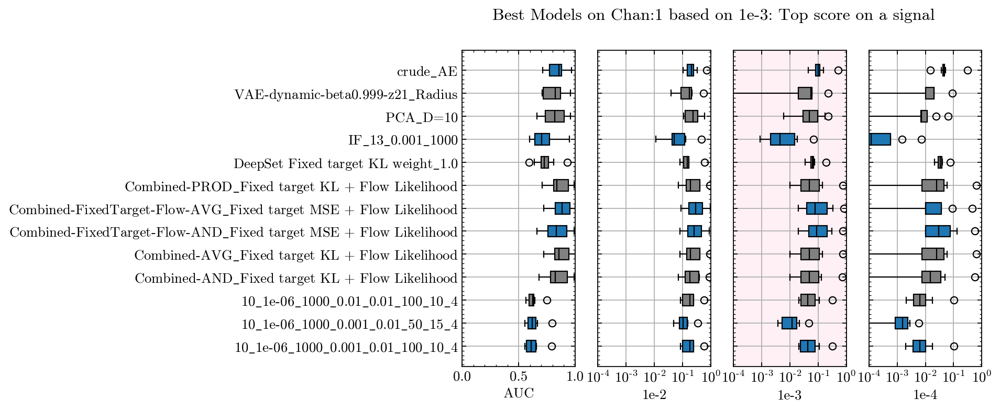

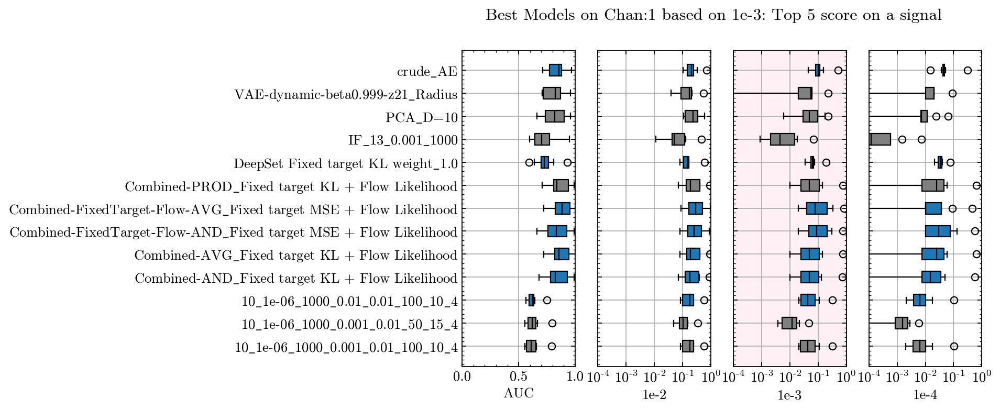

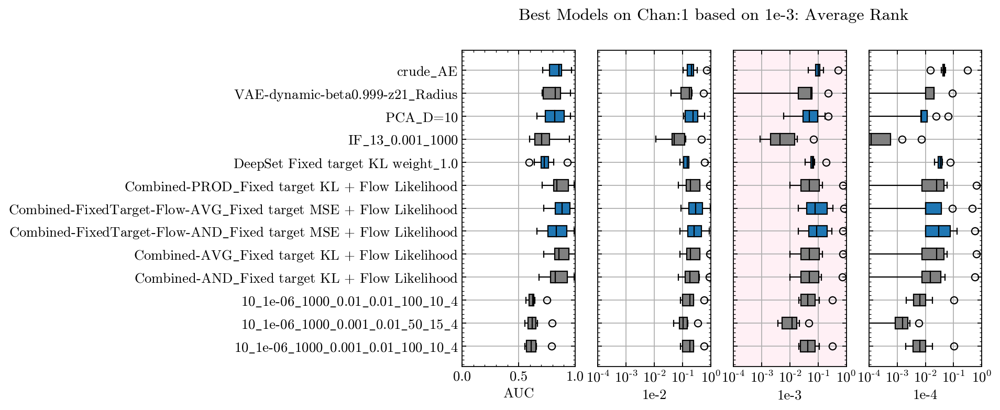

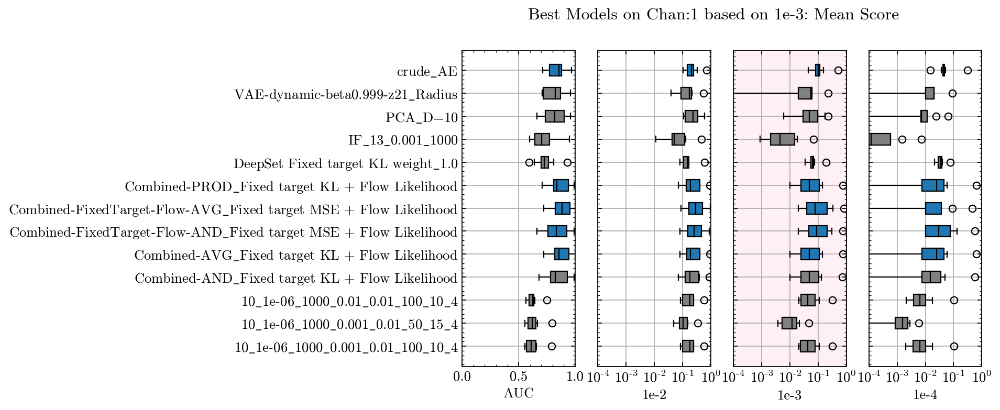

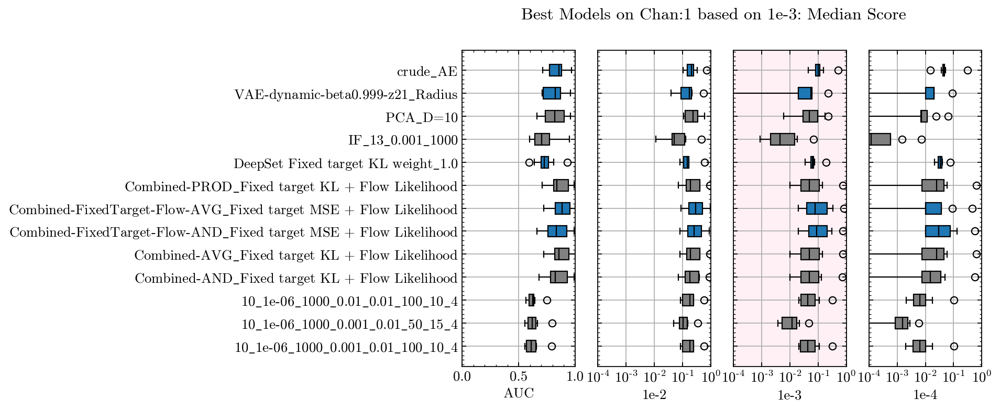

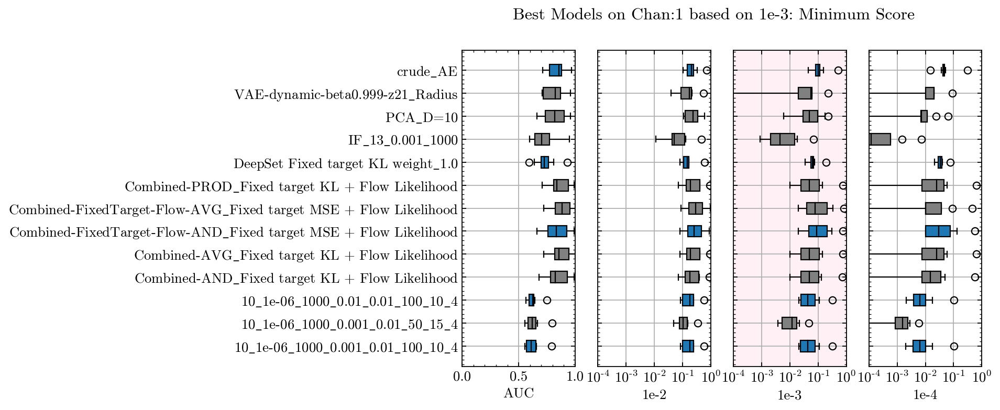

In [36]:
Analyze(AllCombined, 
        Chan='1', 
        Metric='1e-3',
        MetricNumberDict = {'top1': 6,
                            'top5': 7,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-4

1 glgl1400_neutralino1100
1 glgl1600_neutralino800
1 monojet_Zp2000.0_DM_50.0
1 monotop_200_A
1 sqsq1_sq1400_neut800
1 sqsq_sq1800_neut800
1 stlp_st1000
1 stop2b1000_neutralino300
****************************************
Models from chan=1 ranked by metric=1e-4 sorted by top1
                                                  Model  top1
1038                                           crude_AE     3
478   Combined-FixedTarget-Flow-AND_Fixed target MSE...     2
477      Combined-AVG_Fixed target KL + Flow Likelihood     1
554                  DeepSet Fixed target KL weight_1.0     1
****************************************

****************************************
Models from chan=1 ranked by metric=1e-4 sorted by top5
                                                  Model  top5
478   Combined-FixedTarget-Flow-AND_Fixed target MSE...     6
1038                                           crude_AE     5
554                  DeepSet Fixed target KL weight_1.0     5
477      Combined-AVG_Fixe

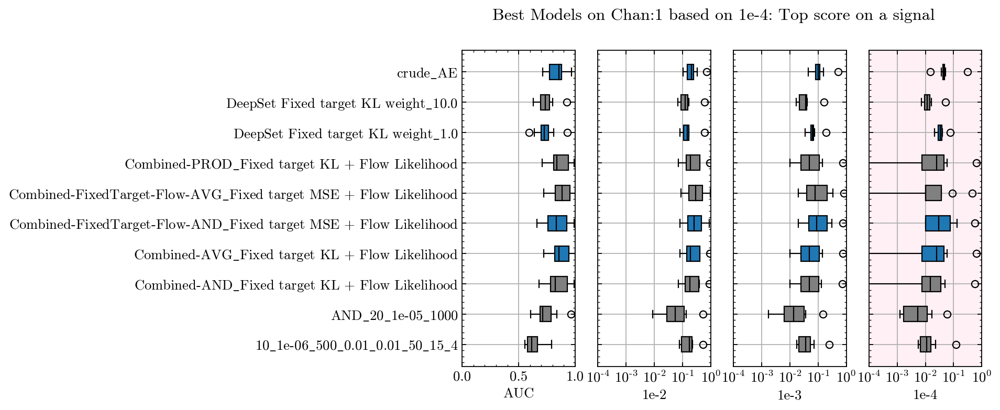

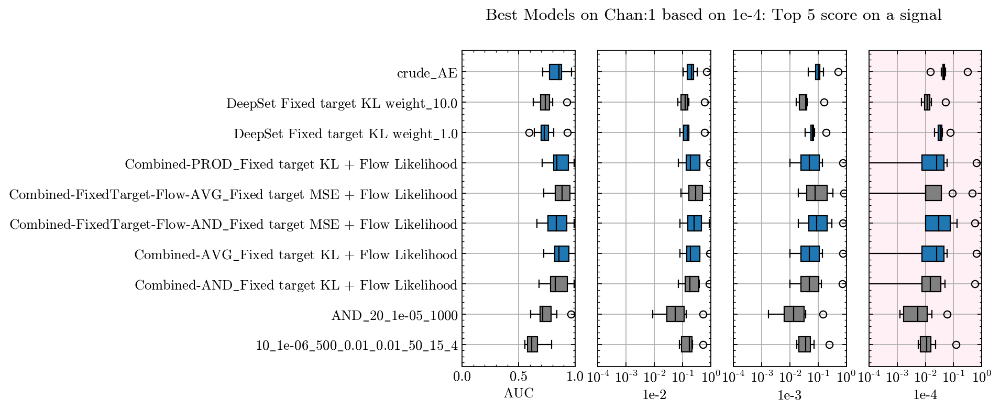

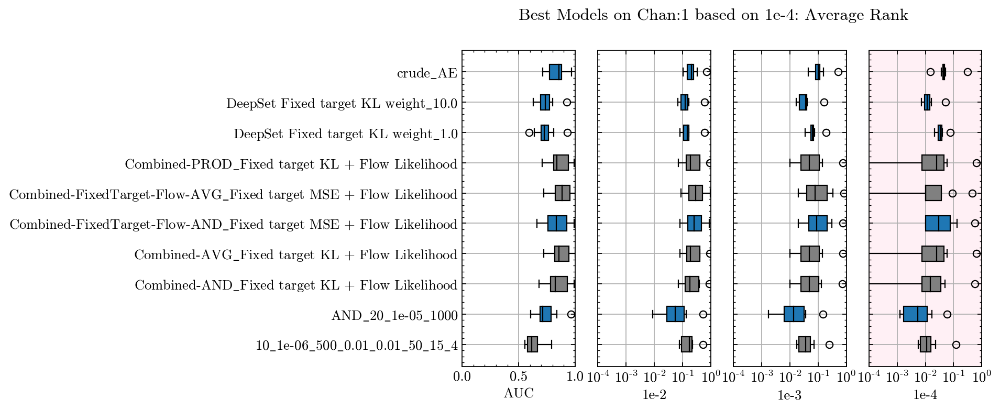

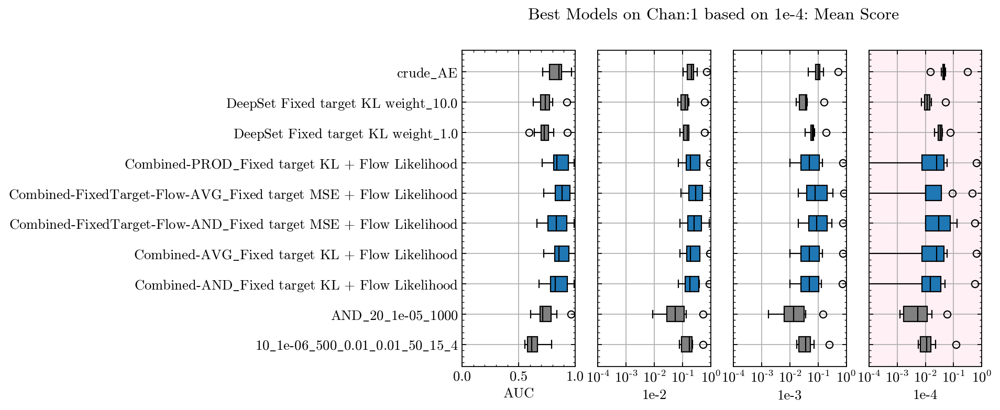

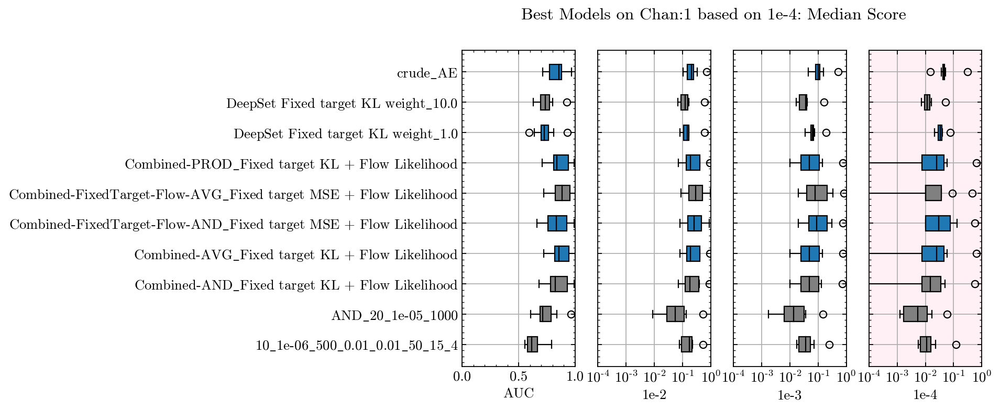

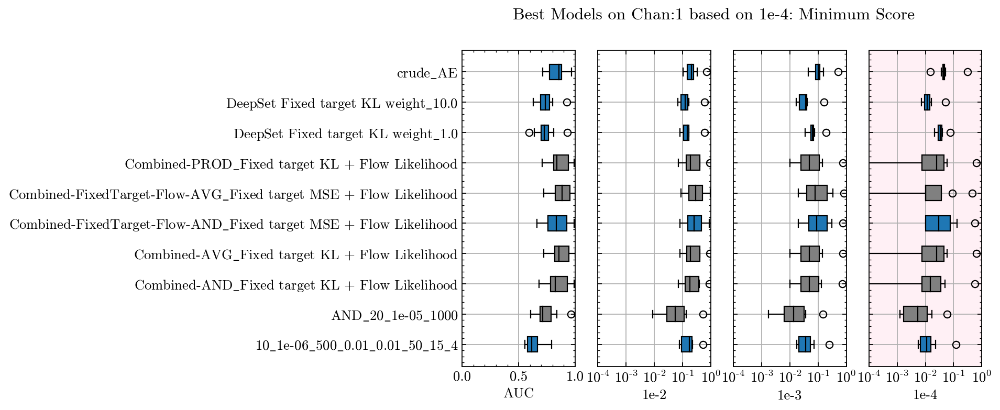

In [37]:
Analyze(AllCombined, 
        Chan='1', 
        Metric='1e-4',
        MetricNumberDict = {'top1': 4,
                            'top5': 5,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

## Chan 2a
### AUC

2a chaneut_cha200_neut50
2a chaneut_cha250_neut150
2a chaneut_cha300_neut100
2a chaneut_cha400_neut200
2a gluino_1000.0_neutralino_1.0
2a pp23mt_50
2a pp24mt_50
****************************************
Models from chan=2a ranked by metric=AUC sorted by top1
                                               Model  top1
291                                VAE_OrthogonalSNF     2
395                         VAE-static-beta0.5-z8_RL     1
476  Combined-PROD_Fixed target KL + Flow Likelihood     1
585         ld20_lr1e-5_bs1000_epoch2000_enc512_F_sc     1
312                                  VAE_b=1e-5_D=10     1
****************************************

****************************************
Models from chan=2a ranked by metric=AUC sorted by top5
                 Model  top5
291  VAE_OrthogonalSNF     3
292  VAE_TriangularSNF     3
293            VAE_IAF     3
****************************************

****************************************
Models from chan=2a ranked by metric=AUC sorted by

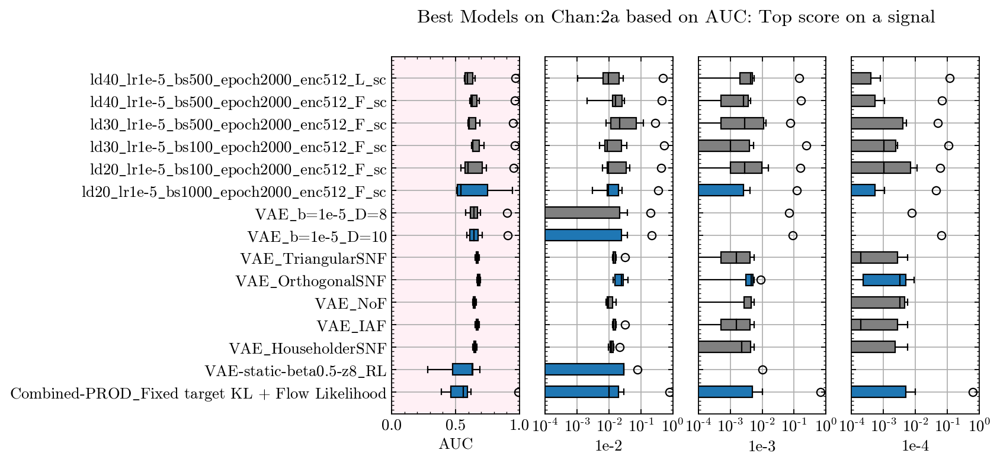

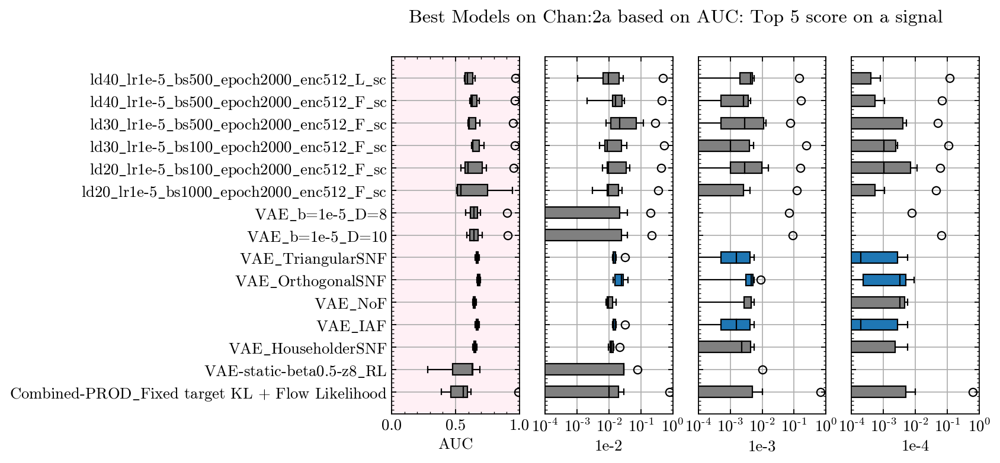

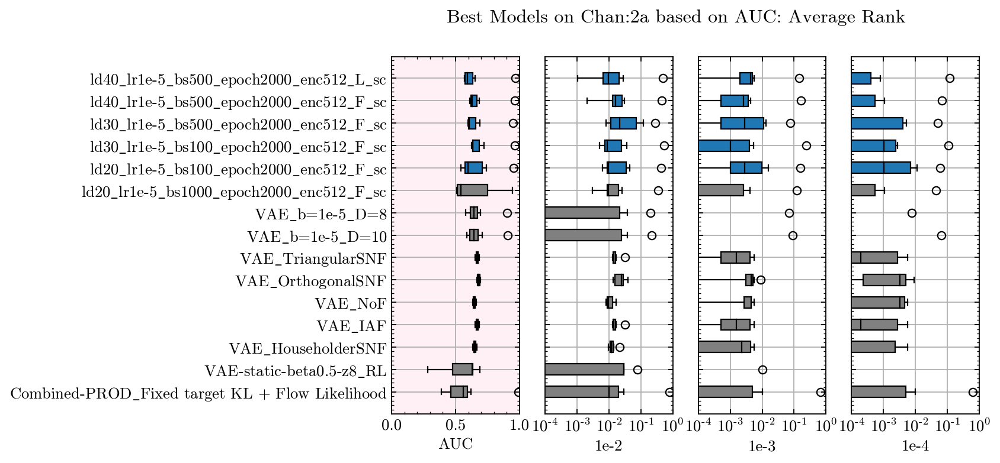

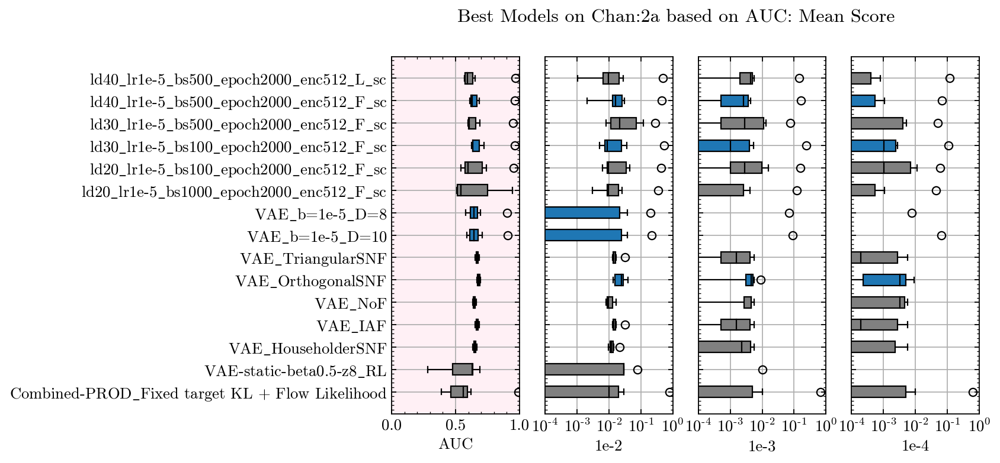

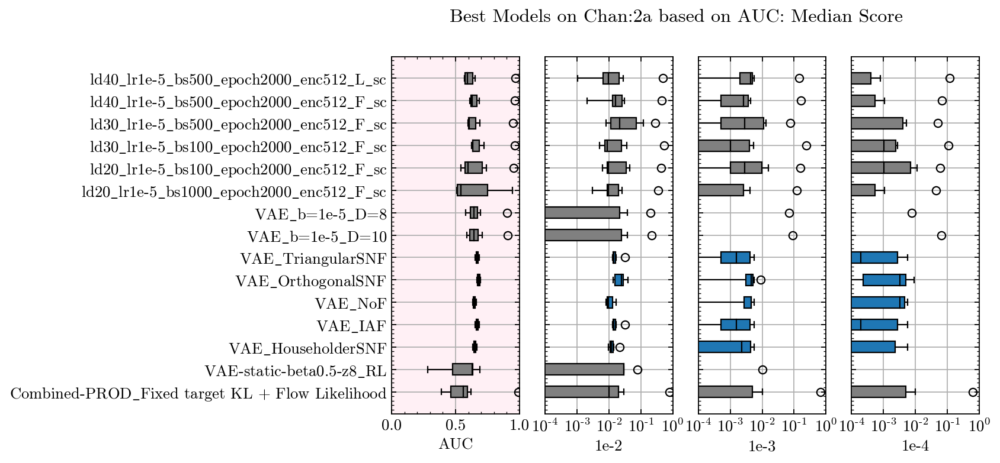

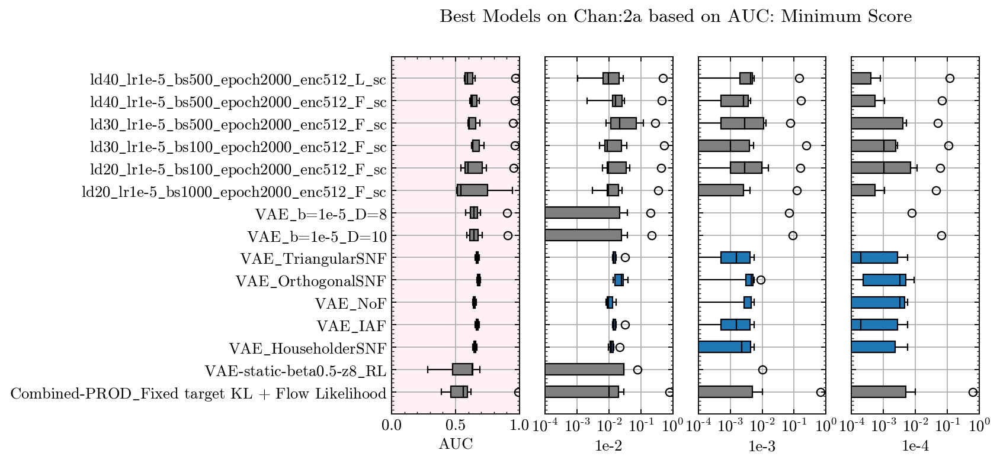

In [38]:
Analyze(AllCombined, 
        Chan='2a', 
        Metric='AUC',
        MetricNumberDict = {'top1': 5,
                            'top5': 3,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-2

2a chaneut_cha200_neut50
2a chaneut_cha250_neut150
2a chaneut_cha300_neut100
2a chaneut_cha400_neut200
2a gluino_1000.0_neutralino_1.0
2a pp23mt_50
2a pp24mt_50
****************************************
Models from chan=2a ranked by metric=1e-2 sorted by top1
                                                 Model  top1
606             ld30_lr1e-5_bs100_epoch2000_enc512_L_1     1
391                           VAE-static-beta0.5-z5_RL     1
517                                Fixed-MSE2-z233_MSE     1
395                           VAE-static-beta0.5-z8_RL     1
515                                 Fixed-MSE2-z89_MSE     1
481  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     1
407                          VAE-static-beta0.5-z34_RL     1
****************************************

****************************************
Models from chan=2a ranked by metric=1e-2 sorted by top5
                                                 Model  top5
478  Combined-FixedTarget-Flow-AND_Fixed target MSE.

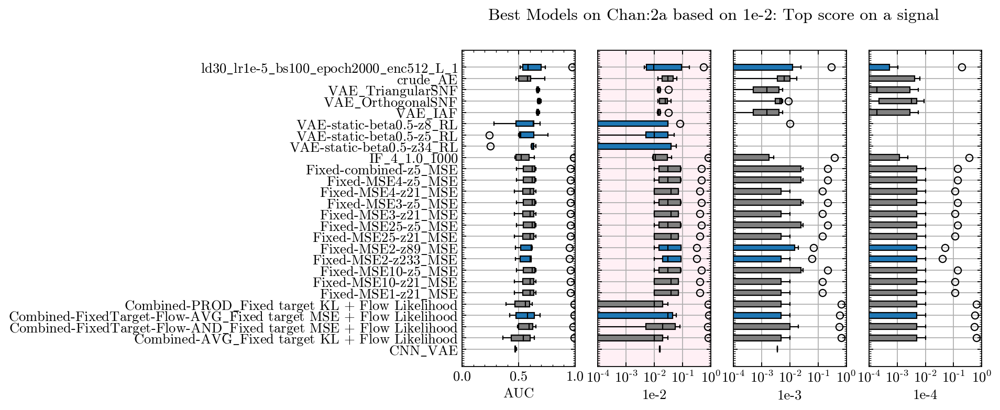

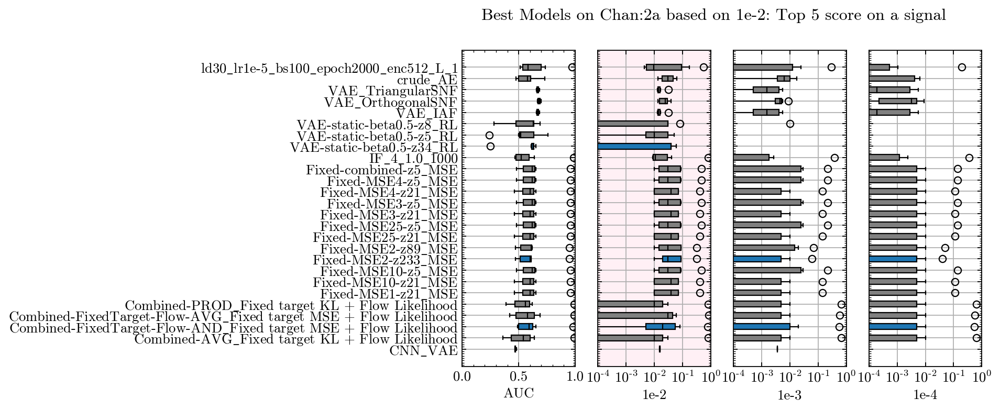

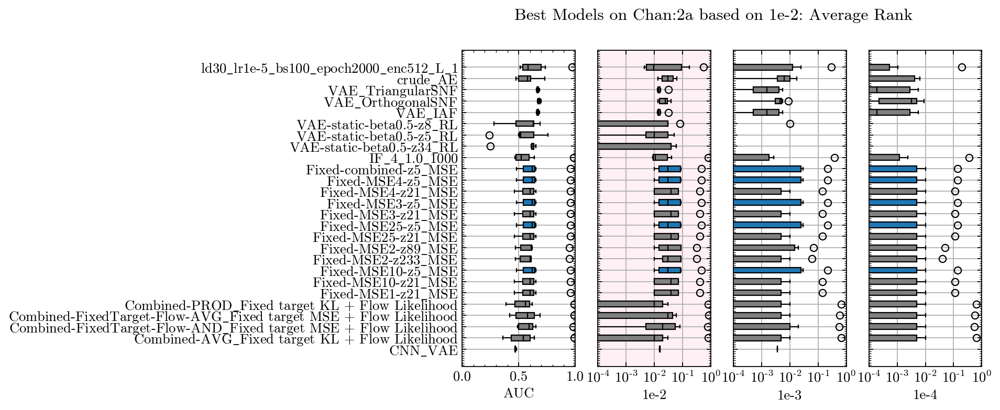

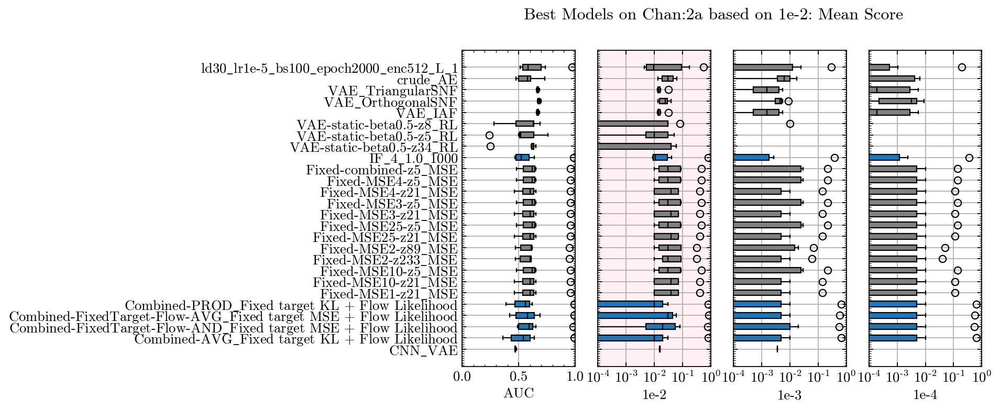

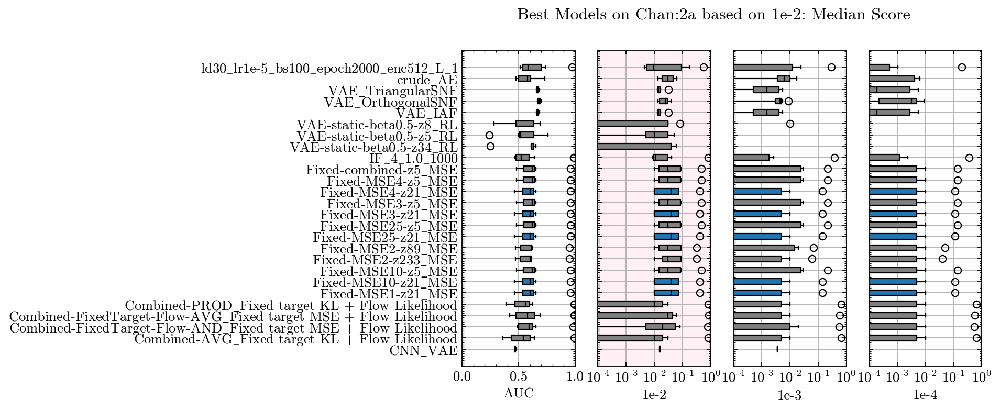

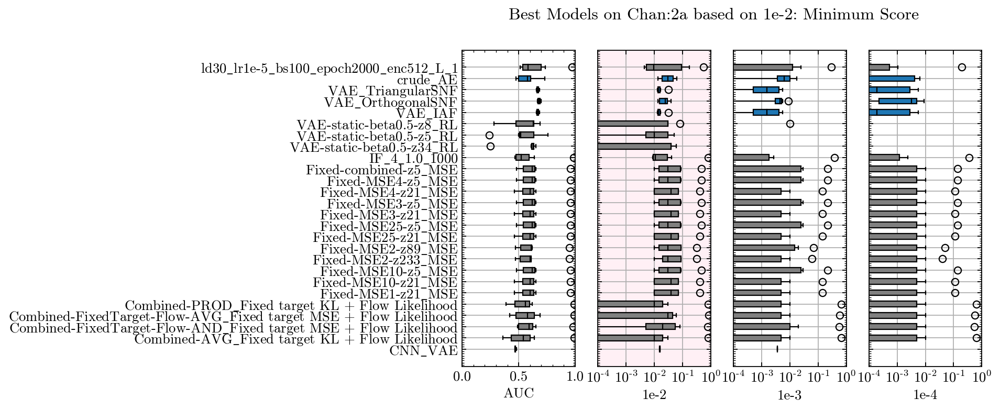

In [39]:
Analyze(AllCombined, 
        Chan='2a', 
        Metric='1e-2',
        MetricNumberDict = {'top1': 7,
                            'top5': 3,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-3

2a chaneut_cha200_neut50
2a chaneut_cha250_neut150
2a chaneut_cha300_neut100
2a chaneut_cha400_neut200
2a gluino_1000.0_neutralino_1.0
2a pp23mt_50
2a pp24mt_50
****************************************
Models from chan=2a ranked by metric=1e-3 sorted by top1
                                               Model  top1
345                     VAE-dynamic-beta1e-06-z21_RL     1
298                                          PCA_D=5     1
324                                   VAE_b=1e-1_D=4     1
387                        VAE-static-beta0.1-z34_RL     1
476  Combined-PROD_Fixed target KL + Flow Likelihood     1
509                                Fixed-MSE2-z5_MSE     1
500                                Fixed-MSE1-z5_MSE     1
****************************************

****************************************
Models from chan=2a ranked by metric=1e-3 sorted by top5
                                                 Model  top5
478  Combined-FixedTarget-Flow-AND_Fixed target MSE...     2
345    

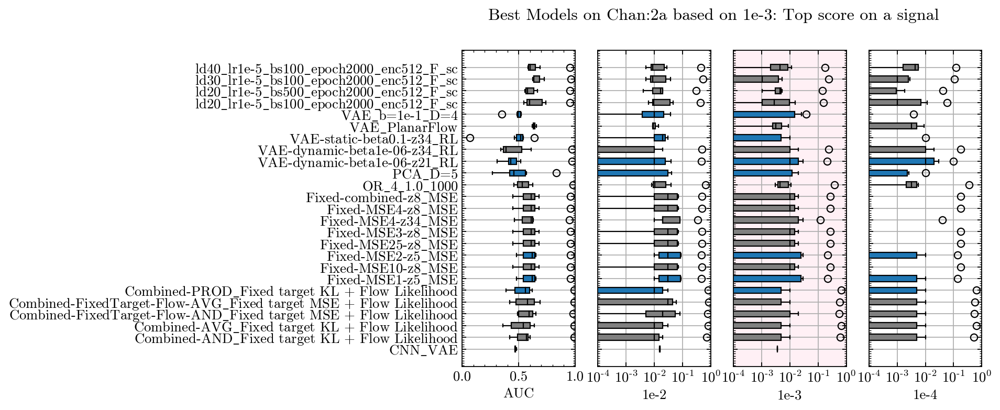

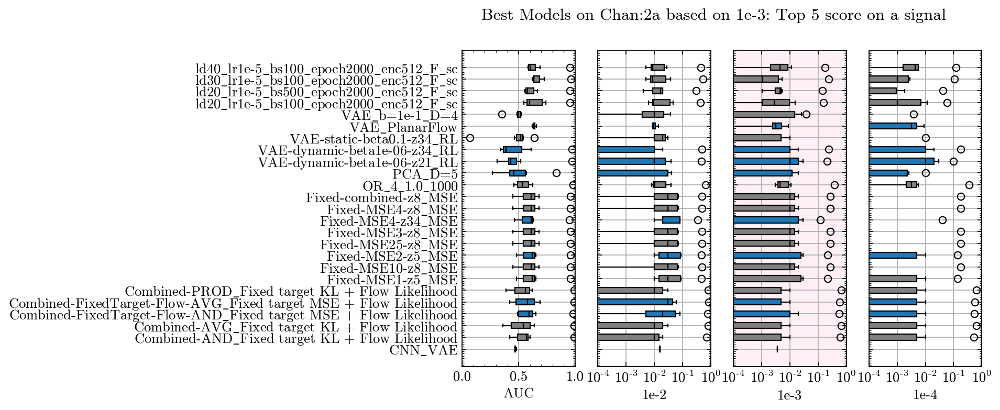

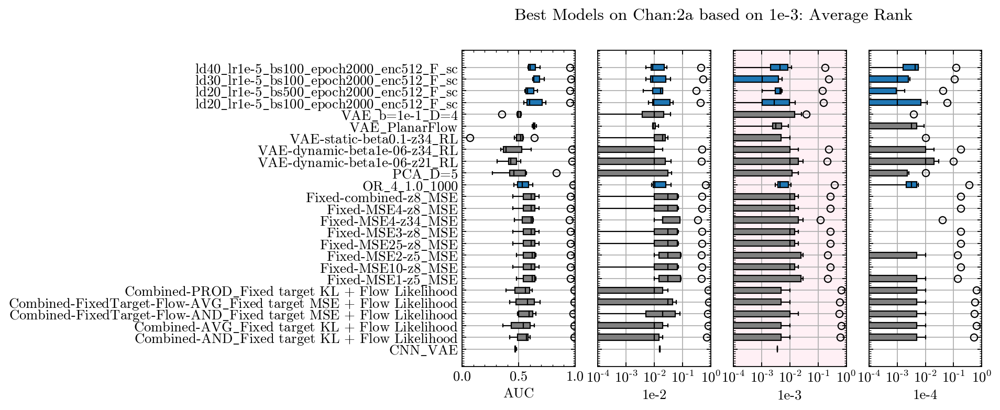

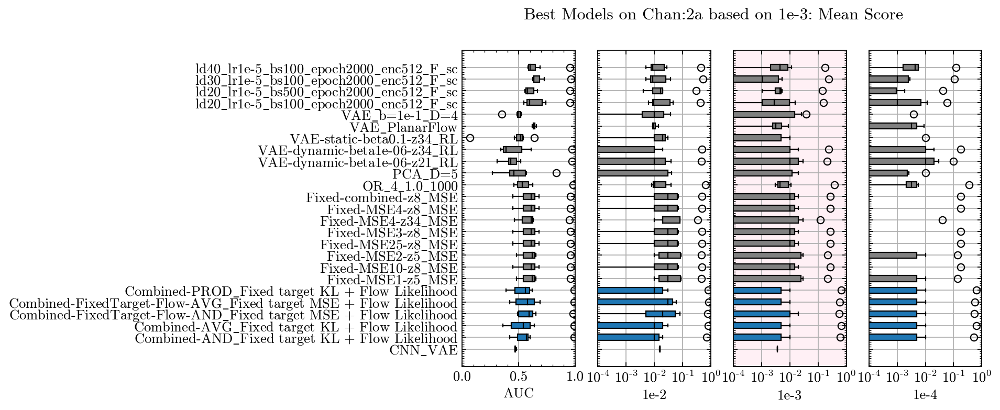

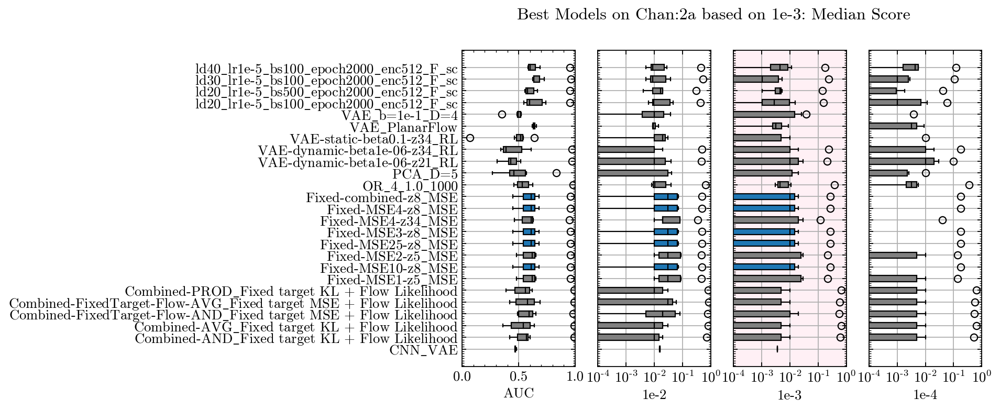

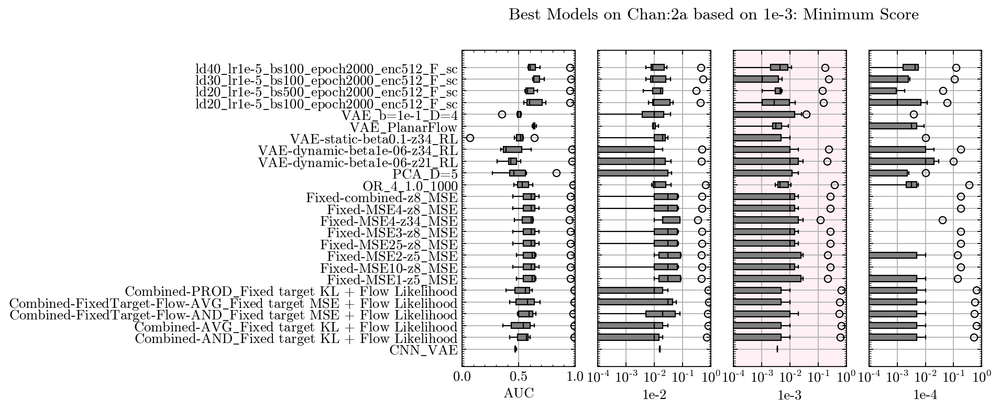

In [40]:
Analyze(AllCombined, 
        Chan='2a', 
        Metric='1e-3',
        MetricNumberDict = {'top1': 7,
                            'top5': 8,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 1},
        Plot=True
       )

### 1e-4

2a chaneut_cha200_neut50
2a chaneut_cha250_neut150
2a chaneut_cha300_neut100
2a chaneut_cha400_neut200
2a gluino_1000.0_neutralino_1.0
2a pp23mt_50
2a pp24mt_50
****************************************
Models from chan=2a ranked by metric=1e-4 sorted by top1
                                               Model  top1
345                     VAE-dynamic-beta1e-06-z21_RL     2
520                               Fixed-MSE3-z13_MSE     1
300                                          PCA_D=7     1
476  Combined-PROD_Fixed target KL + Flow Likelihood     1
387                        VAE-static-beta0.1-z34_RL     1
288                                          VAE_NoF     1
694                 10_1e-07_500_0.001_0.01_100_10_4     0
****************************************

****************************************
Models from chan=2a ranked by metric=1e-4 sorted by top5
                            Model  top5
345  VAE-dynamic-beta1e-06-z21_RL     3
291             VAE_OrthogonalSNF     2
341  VAE-

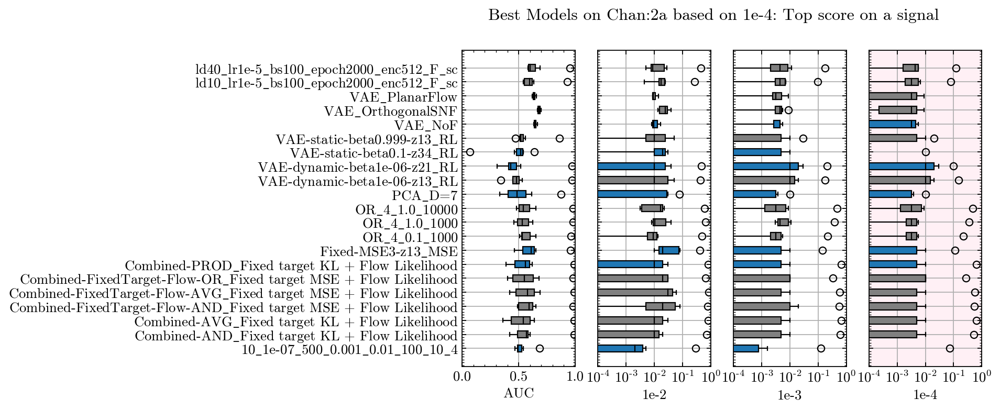

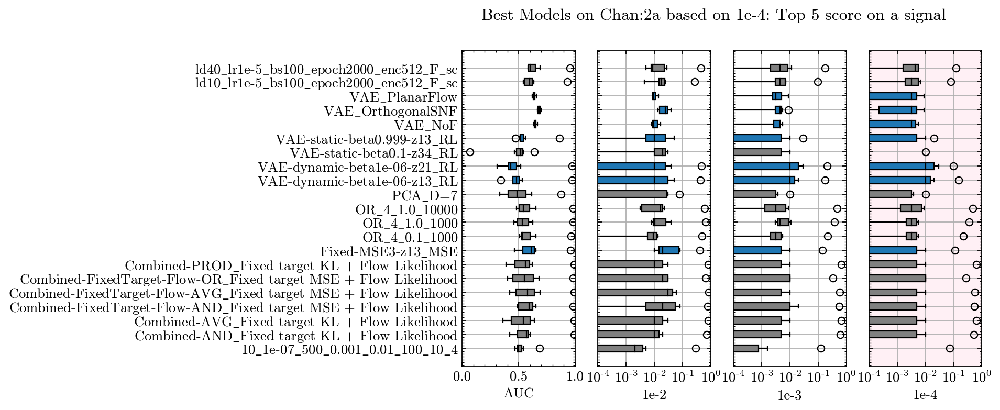

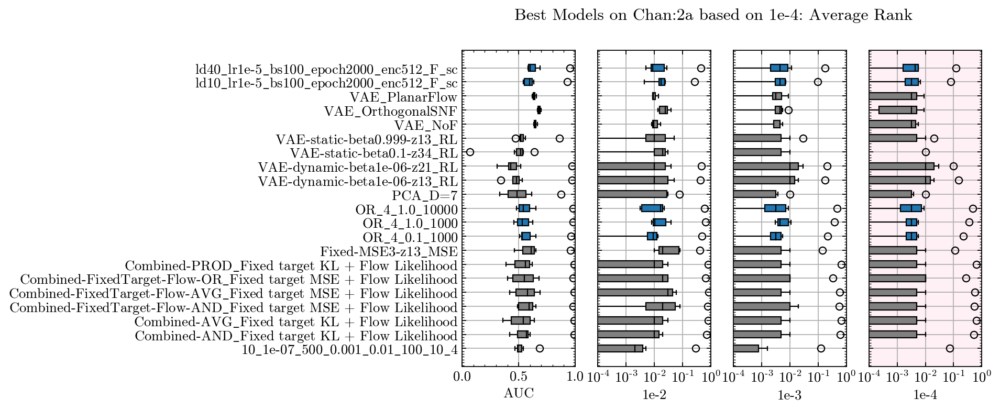

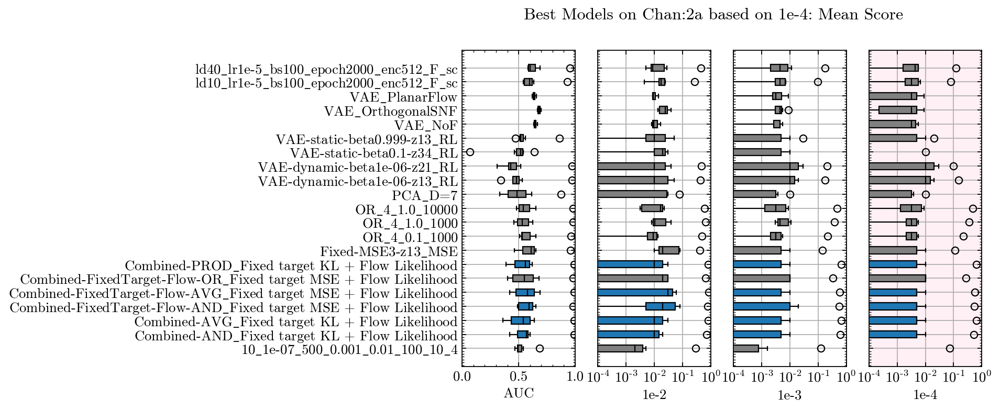

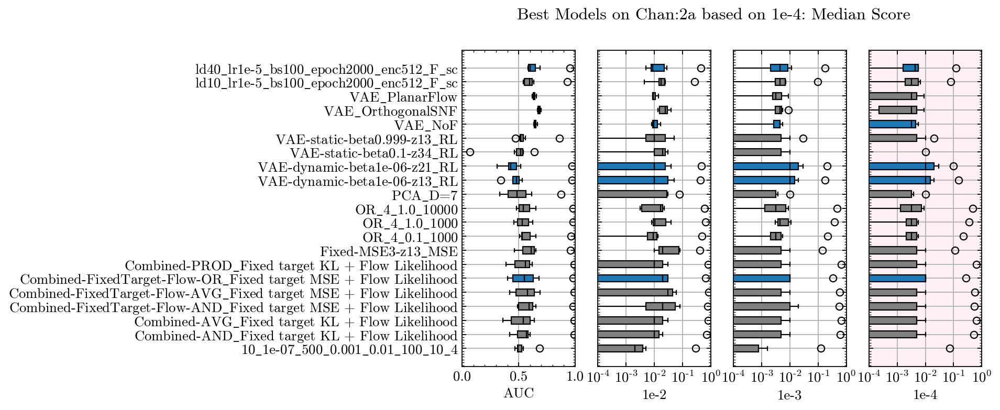

In [41]:
Analyze(AllCombined, 
        Chan='2a', 
        Metric='1e-4',
        MetricNumberDict = {'top1': 7,
                            'top5': 7,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 0},
        Plot=True
       )

## Chan 2b
### AUC

2b chacha_cha300_neut140
2b chacha_cha400_neut60
2b chacha_cha600_neut200
2b chaneut_cha200_neut50
2b chaneut_cha250_neut150
2b gluino_1000.0_neutralino_1.0
2b pp23mt_50
2b pp24mt_50
2b stlp_st1000
****************************************
Models from chan=2b ranked by metric=AUC sorted by top1
                                                 Model  top1
481  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     4
291                                  VAE_OrthogonalSNF     3
477     Combined-AVG_Fixed target KL + Flow Likelihood     1
479  Combined-FixedTarget-Flow-OR_Fixed target MSE ...     1
0                                     IF_13_0.001_1000     0
****************************************

****************************************
Models from chan=2b ranked by metric=AUC sorted by top5
                                                 Model  top5
481  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     5
293                                            VAE_IAF     4
291              

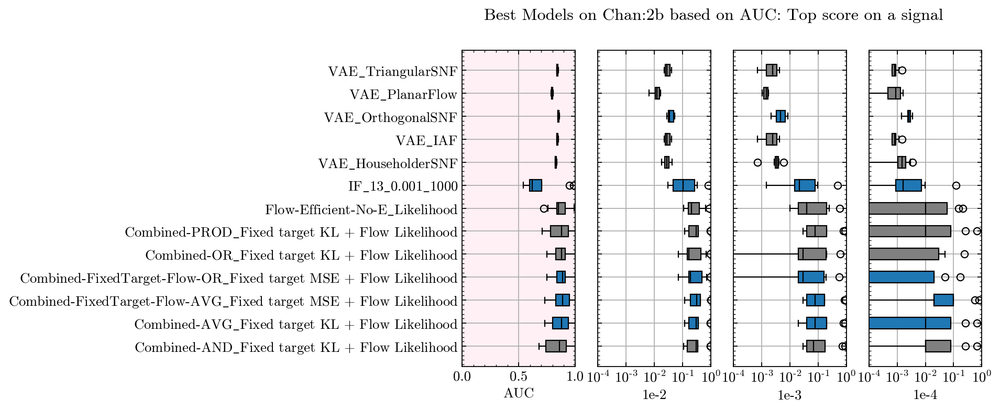

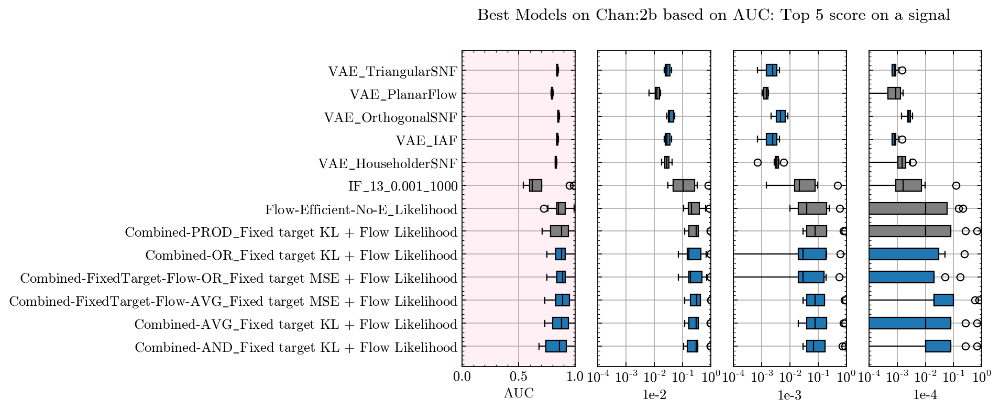

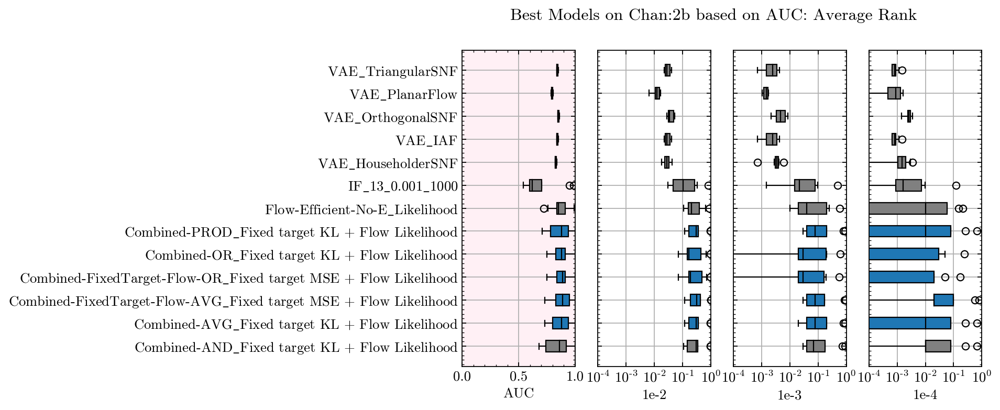

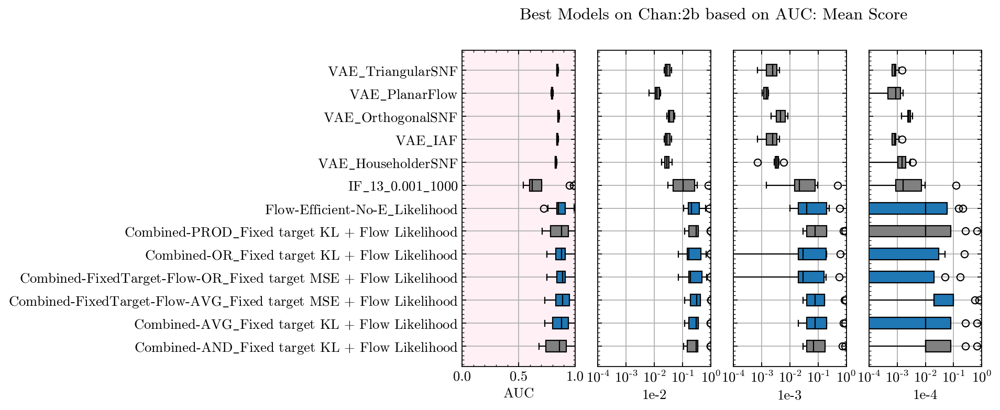

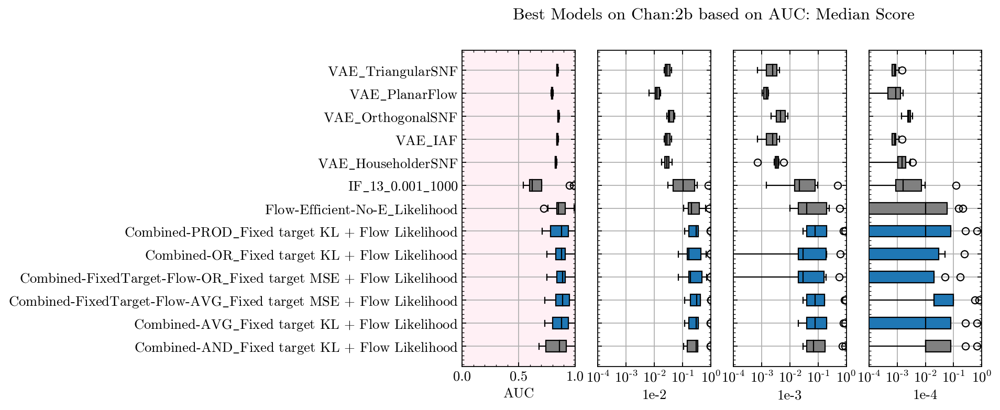

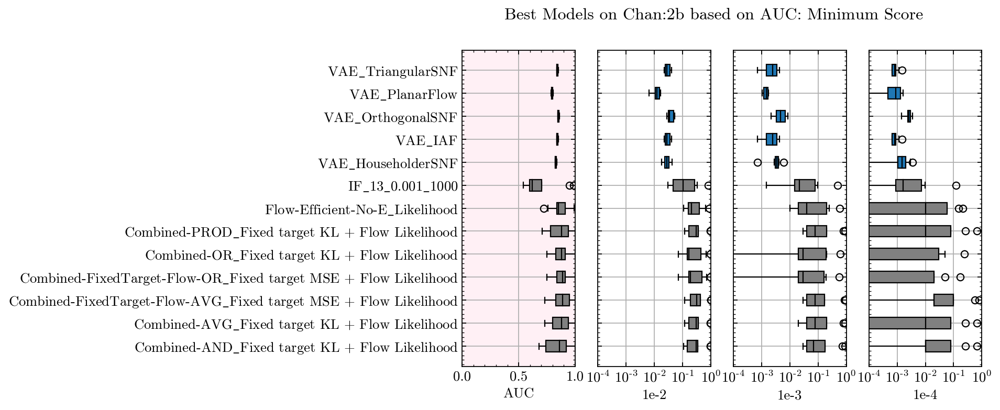

In [42]:
Analyze(AllCombined, 
        Chan='2b', 
        Metric='AUC',
        MetricNumberDict = {'top1': 5,
                            'top5': 8,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-2

2b chacha_cha300_neut140
2b chacha_cha400_neut60
2b chacha_cha600_neut200
2b chaneut_cha200_neut50
2b chaneut_cha250_neut150
2b gluino_1000.0_neutralino_1.0
2b pp23mt_50
2b pp24mt_50
2b stlp_st1000
****************************************
Models from chan=2b ranked by metric=1e-2 sorted by top1
                                                 Model  top1
481  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     5
479  Combined-FixedTarget-Flow-OR_Fixed target MSE ...     1
475      Combined-OR_Fixed target KL + Flow Likelihood     1
574             ld10_lr1e-5_bs100_epoch2000_enc512_L_1     1
609            ld30_lr1e-5_bs100_epoch2000_enc512_F_sc     1
****************************************

****************************************
Models from chan=2b ranked by metric=1e-2 sorted by top5
                                                 Model  top5
476    Combined-PROD_Fixed target KL + Flow Likelihood     5
474     Combined-AND_Fixed target KL + Flow Likelihood     5
481  Combined-F

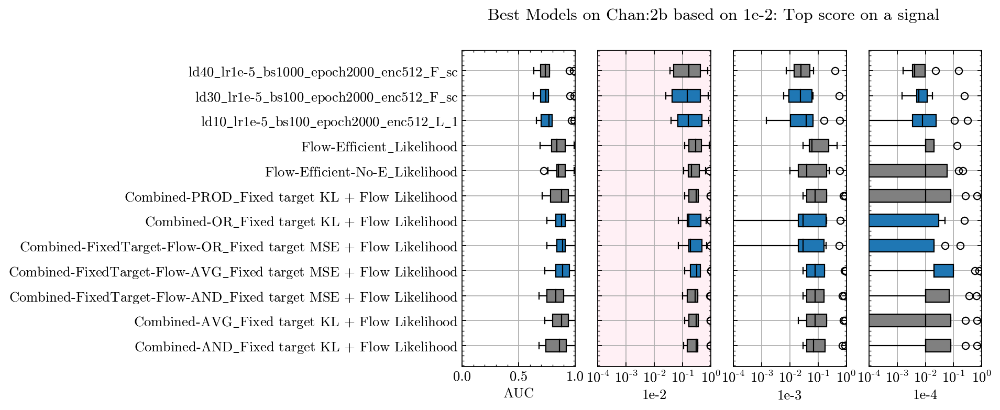

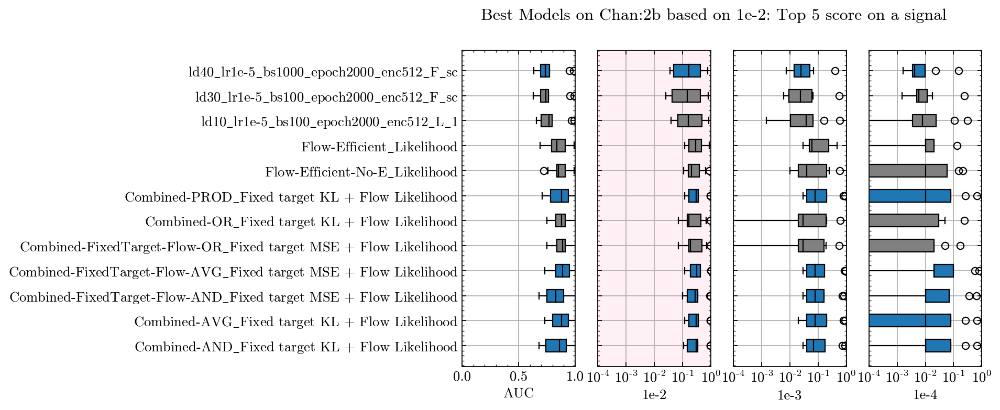

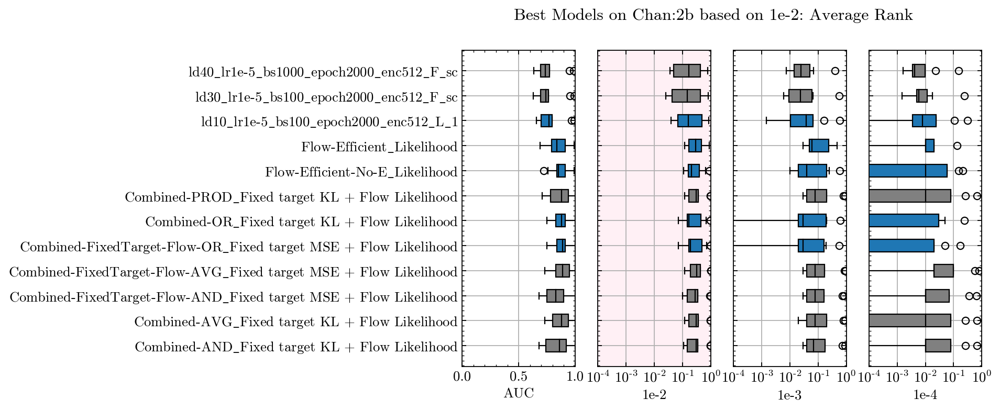

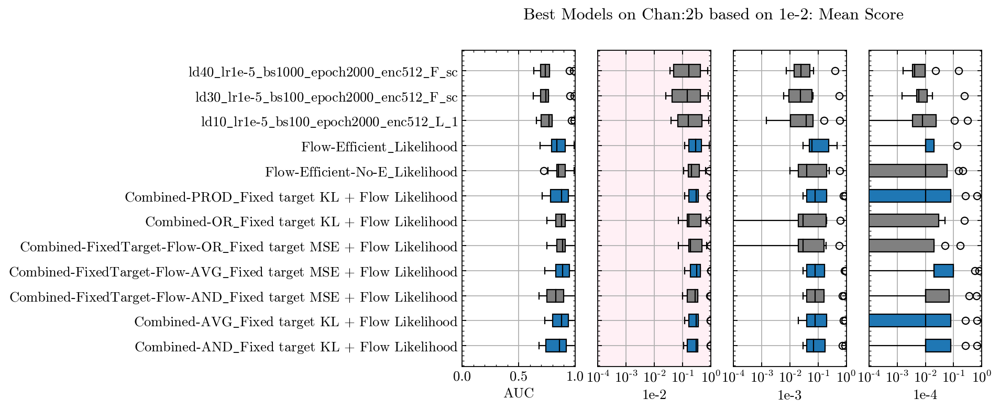

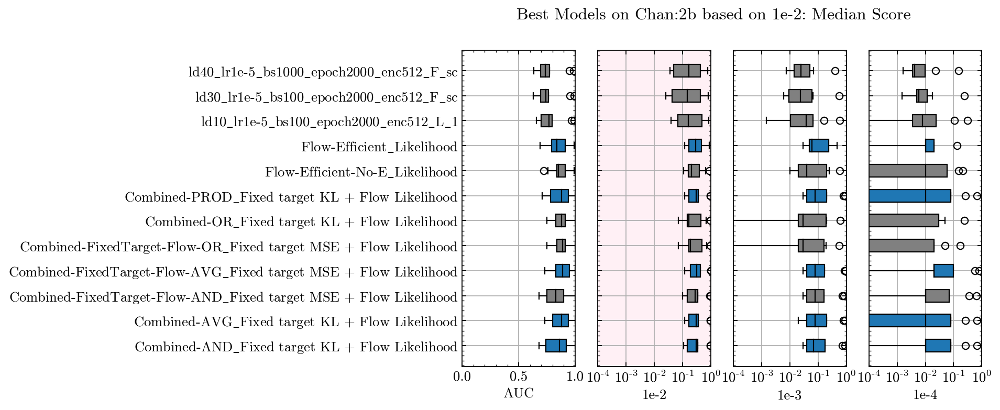

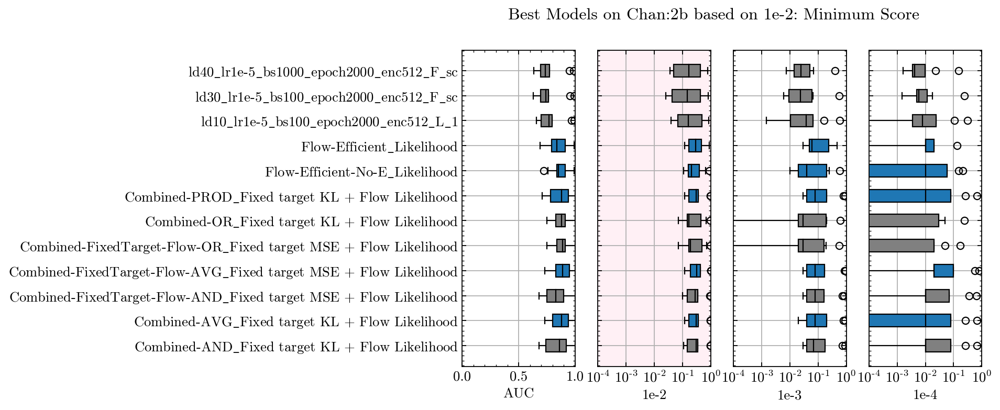

In [43]:
Analyze(AllCombined, 
        Chan='2b', 
        Metric='1e-2',
        MetricNumberDict = {'top1': 5,
                            'top5': 6,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-3

2b chacha_cha300_neut140
2b chacha_cha400_neut60
2b chacha_cha600_neut200
2b chaneut_cha200_neut50
2b chaneut_cha250_neut150
2b gluino_1000.0_neutralino_1.0
2b pp23mt_50
2b pp24mt_50
2b stlp_st1000
****************************************
Models from chan=2b ranked by metric=1e-3 sorted by top1
                                                 Model  top1
481  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     3
555                DeepSet Fixed target KL weight_10.0     2
341                       VAE-dynamic-beta1e-06-z13_RL     2
353                        VAE-dynamic-beta0.001-z5_RL     1
478  Combined-FixedTarget-Flow-AND_Fixed target MSE...     1
****************************************

****************************************
Models from chan=2b ranked by metric=1e-3 sorted by top5
                                                 Model  top5
481  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     5
478  Combined-FixedTarget-Flow-AND_Fixed target MSE...     5
474     Combine

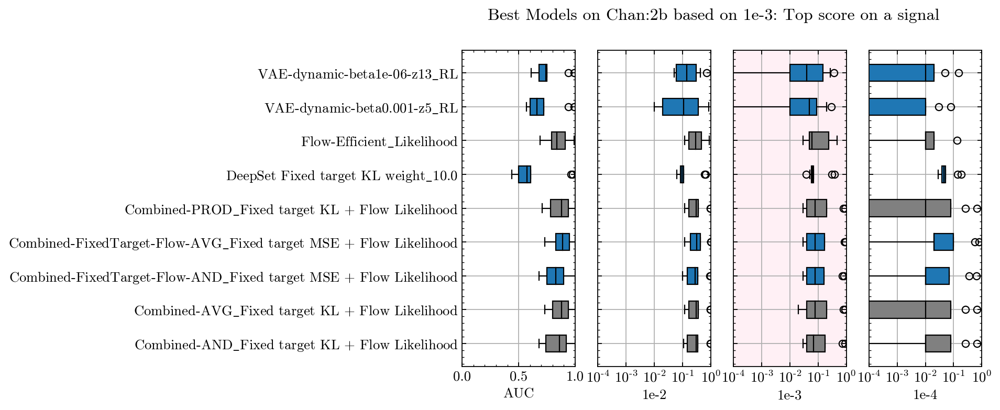

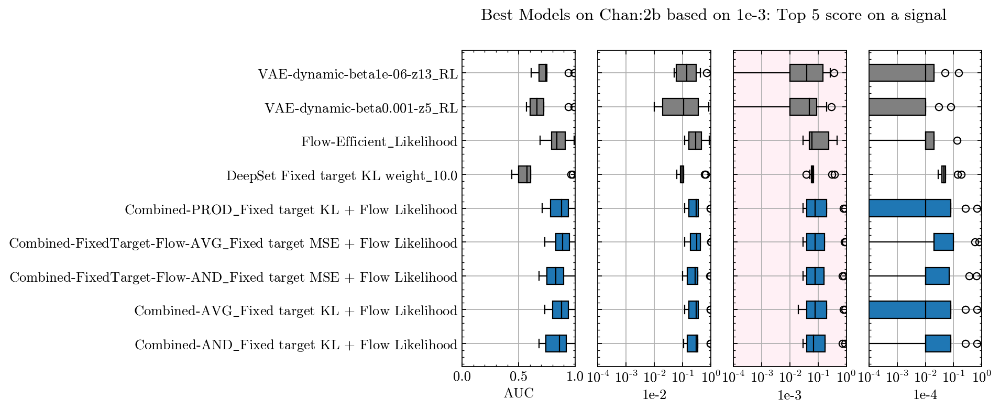

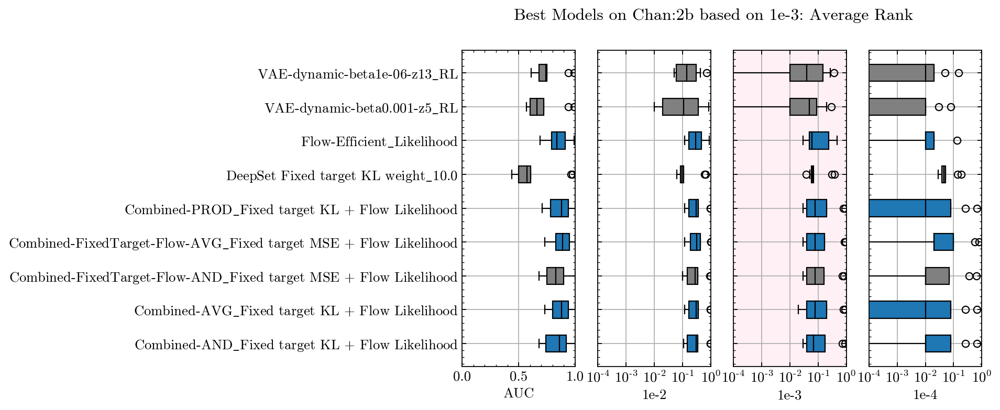

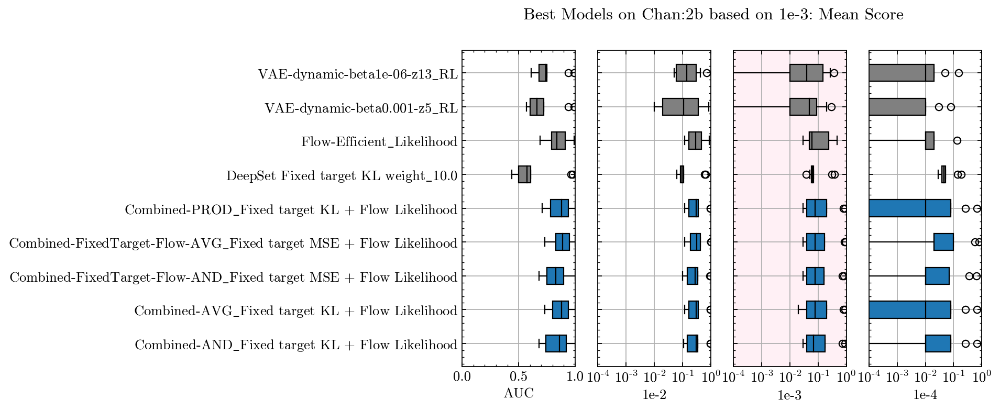

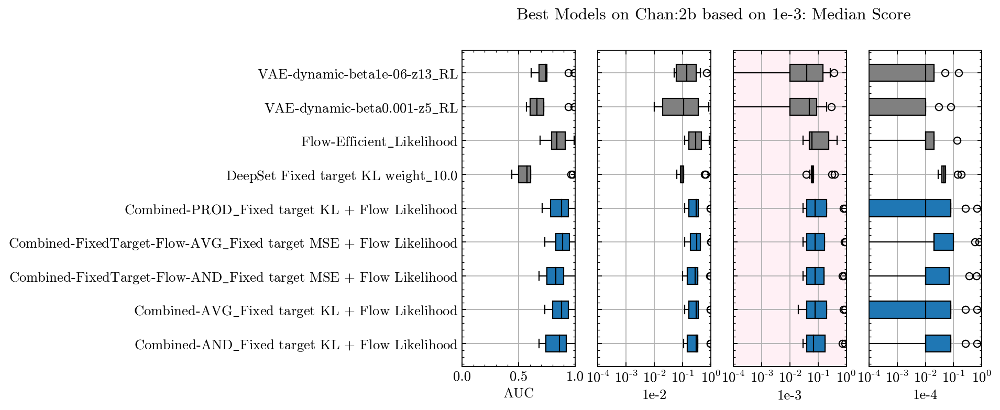

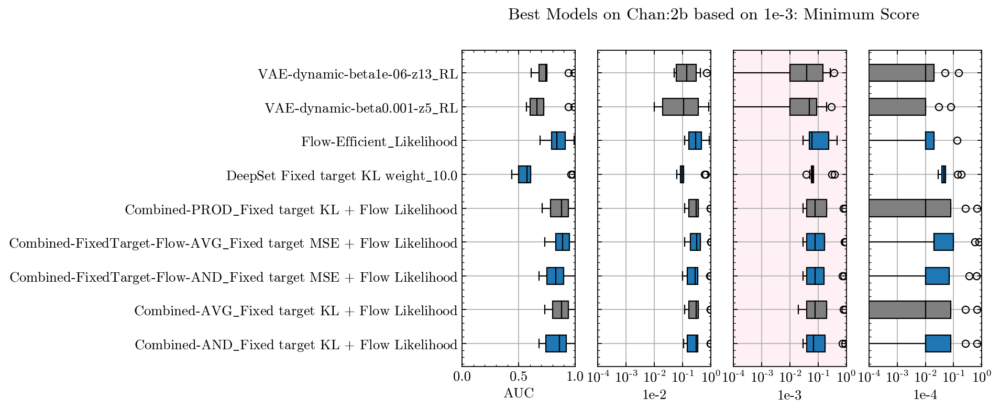

In [44]:
Analyze(AllCombined, 
        Chan='2b', 
        Metric='1e-3',
        MetricNumberDict = {'top1': 5,
                            'top5': 5,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-4

2b chacha_cha300_neut140
2b chacha_cha400_neut60
2b chacha_cha600_neut200
2b chaneut_cha200_neut50
2b chaneut_cha250_neut150
2b gluino_1000.0_neutralino_1.0
2b pp23mt_50
2b pp24mt_50
2b stlp_st1000
****************************************
Models from chan=2b ranked by metric=1e-4 sorted by top1
                                                 Model  top1
555                DeepSet Fixed target KL weight_10.0     5
481  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     2
570           ld40_lr1e-5_bs10000_epoch2000_enc512_L_1     1
586            ld30_lr1e-5_bs1000_epoch2000_enc512_L_1     1
****************************************

****************************************
Models from chan=2b ranked by metric=1e-4 sorted by top5
                                   Model  top5
555  DeepSet Fixed target KL weight_10.0     6
554   DeepSet Fixed target KL weight_1.0     4
****************************************

****************************************
Models from chan=2b ranked by metri

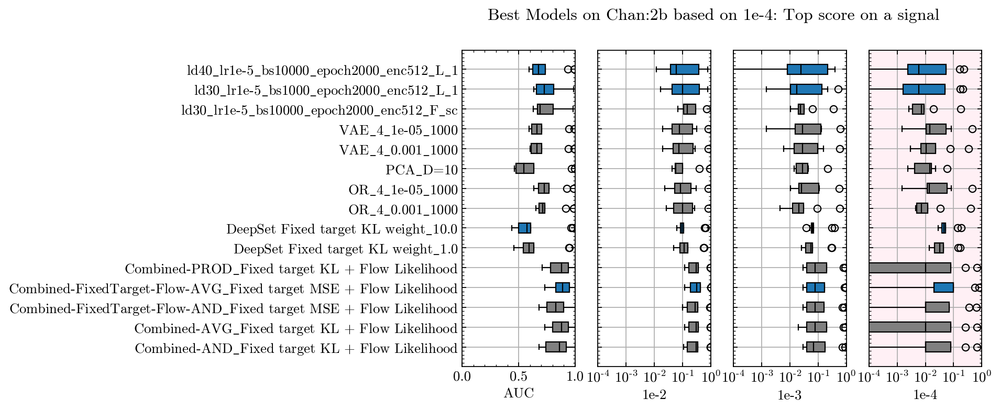

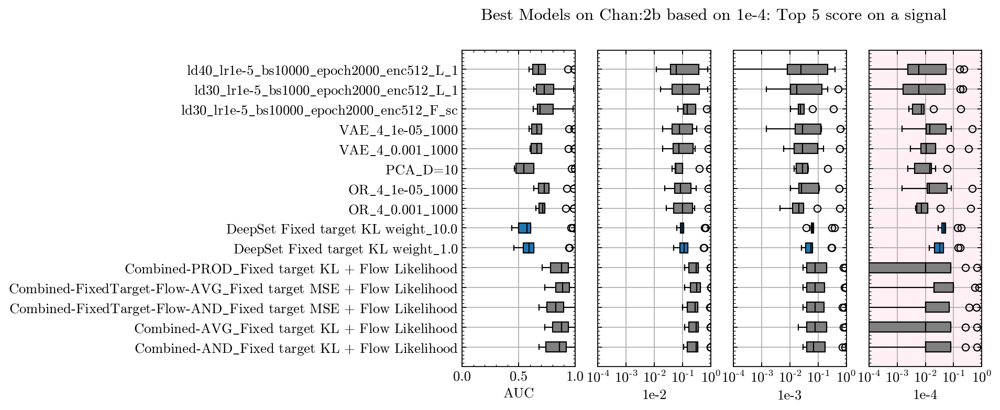

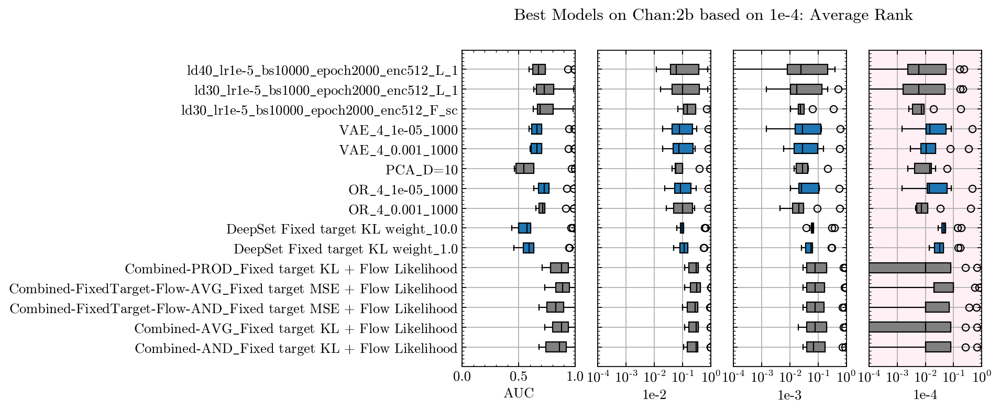

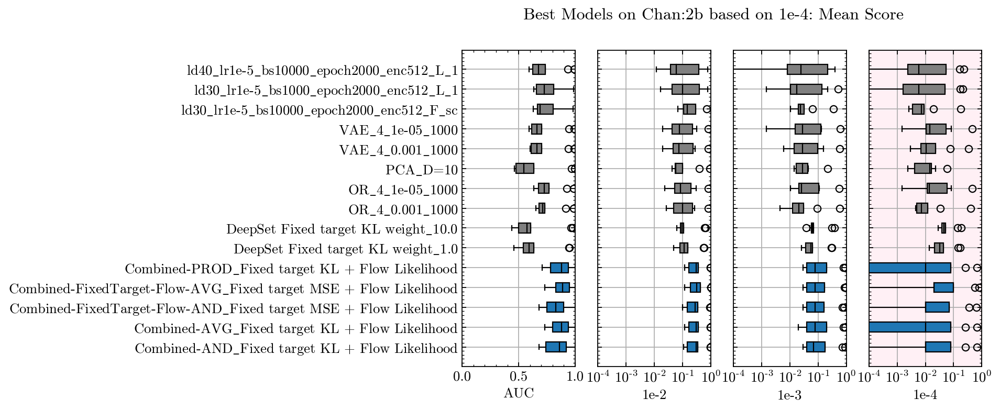

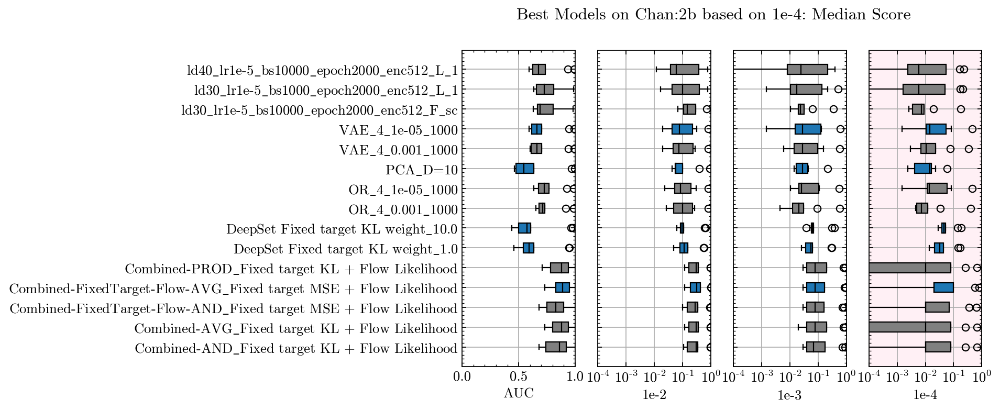

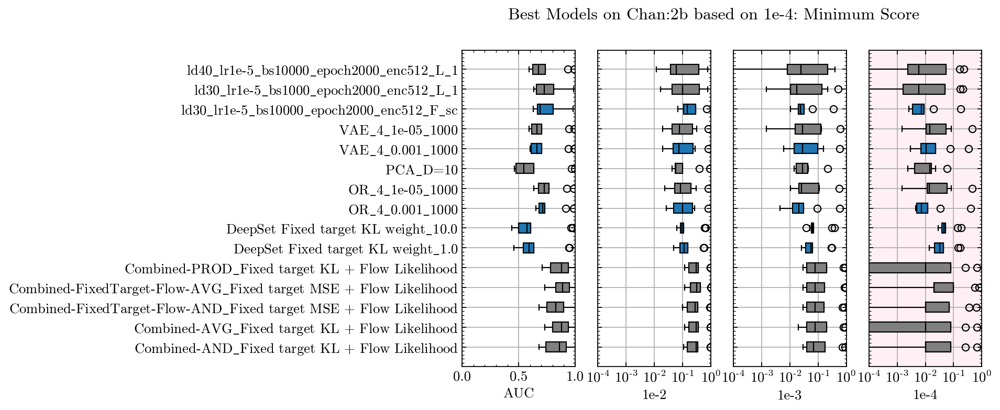

In [45]:
Analyze(AllCombined, 
        Chan='2b', 
        Metric='1e-4',
        MetricNumberDict = {'top1': 4,
                            'top5': 2,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

## Chan 3
### AUC

3 glgl1400_neutralino1100
3 glgl1600_neutralino800
3 gluino_1000.0_neutralino_1.0
3 monoV_Zp2000.0_DM_1.0
3 monojet_Zp2000.0_DM_50.0
3 monotop_200_A
3 sqsq1_sq1400_neut800
3 sqsq_sq1800_neut800
3 stlp_st1000
3 stop2b1000_neutralino300
****************************************
Models from chan=3 ranked by metric=AUC sorted by top1
                  Model  top1
290  VAE_HouseholderSNF     6
****************************************

****************************************
Models from chan=3 ranked by metric=AUC sorted by top5
                                                 Model  top5
290                                 VAE_HouseholderSNF     8
289                                     VAE_PlanarFlow     7
481  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     6
292                                  VAE_TriangularSNF     5
477     Combined-AVG_Fixed target KL + Flow Likelihood     4
291                                  VAE_OrthogonalSNF     4
479  Combined-FixedTarget-Flow-OR_Fixed targ

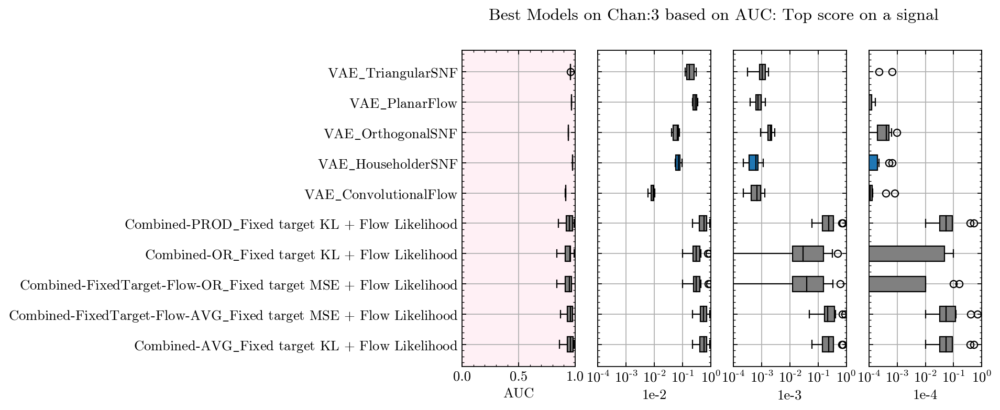

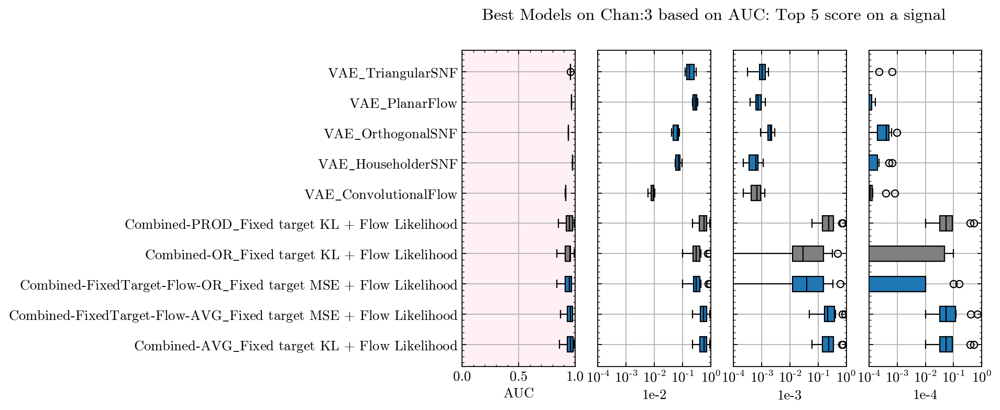

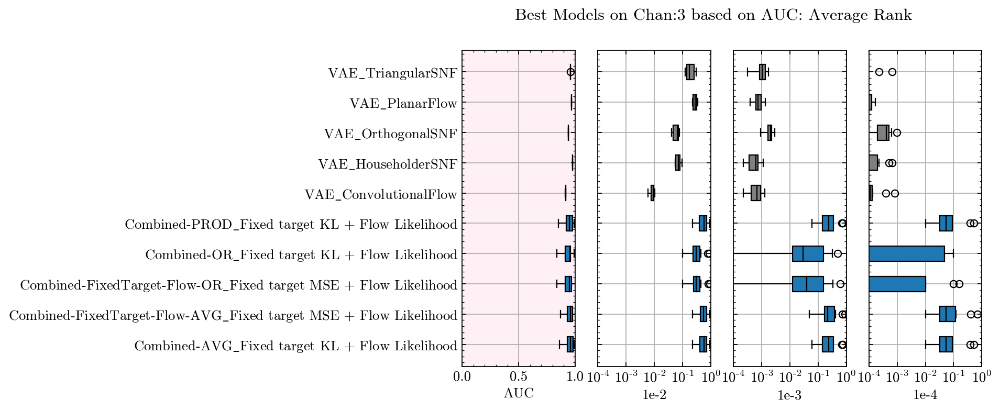

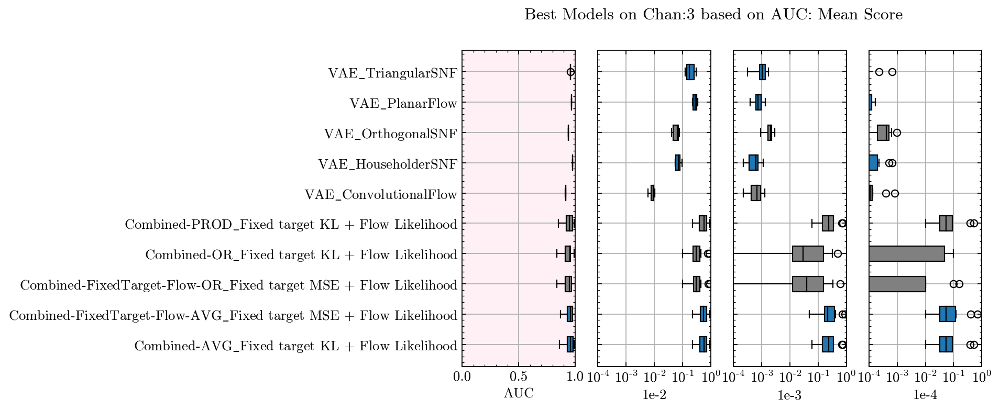

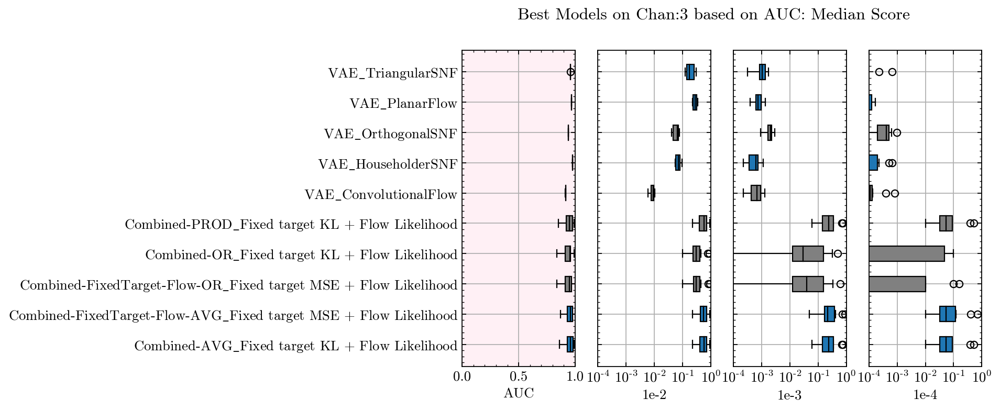

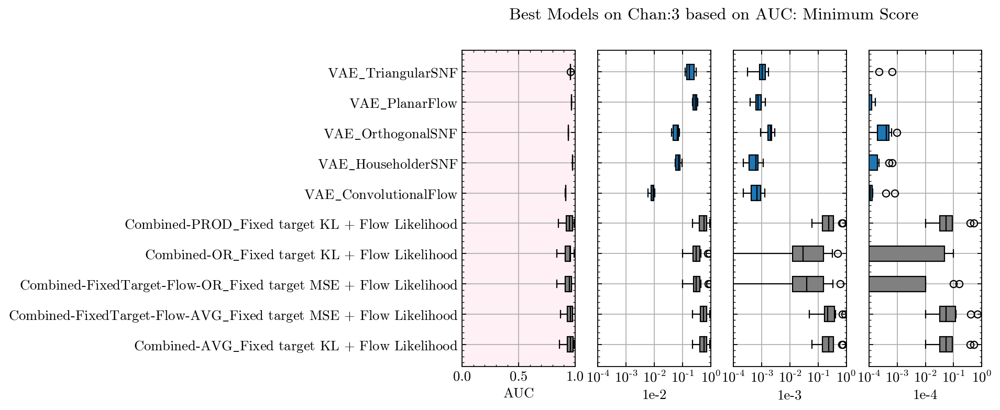

In [46]:
Analyze(AllCombined, 
        Chan='3', 
        Metric='AUC',
        MetricNumberDict = {'top1': 1,
                            'top5': 7,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-2

3 glgl1400_neutralino1100
3 glgl1600_neutralino800
3 gluino_1000.0_neutralino_1.0
3 monoV_Zp2000.0_DM_1.0
3 monojet_Zp2000.0_DM_50.0
3 monotop_200_A
3 sqsq1_sq1400_neut800
3 sqsq_sq1800_neut800
3 stlp_st1000
3 stop2b1000_neutralino300
****************************************
Models from chan=3 ranked by metric=1e-2 sorted by top1
                                                 Model  top1
481  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     5
997                   10_1e-06_5000_0.001_0.01_50_10_8     3
476    Combined-PROD_Fixed target KL + Flow Likelihood     1
****************************************

****************************************
Models from chan=3 ranked by metric=1e-2 sorted by top5
                                                 Model  top5
477     Combined-AVG_Fixed target KL + Flow Likelihood     9
476    Combined-PROD_Fixed target KL + Flow Likelihood     9
481  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     7
****************************************


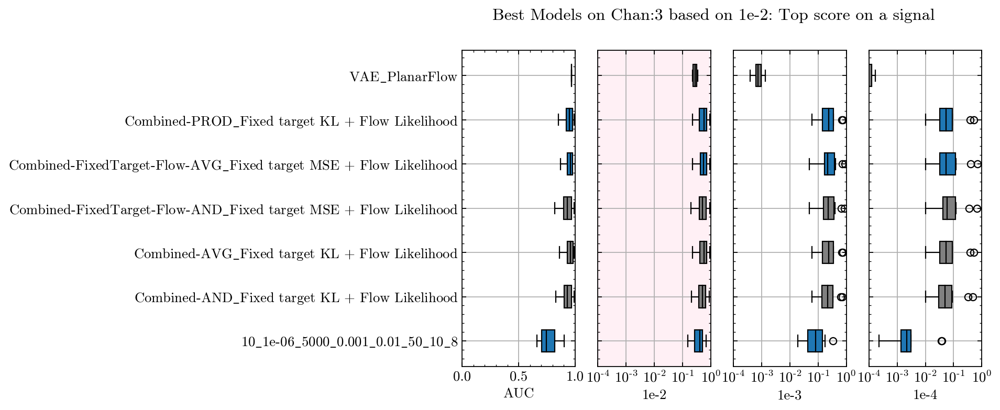

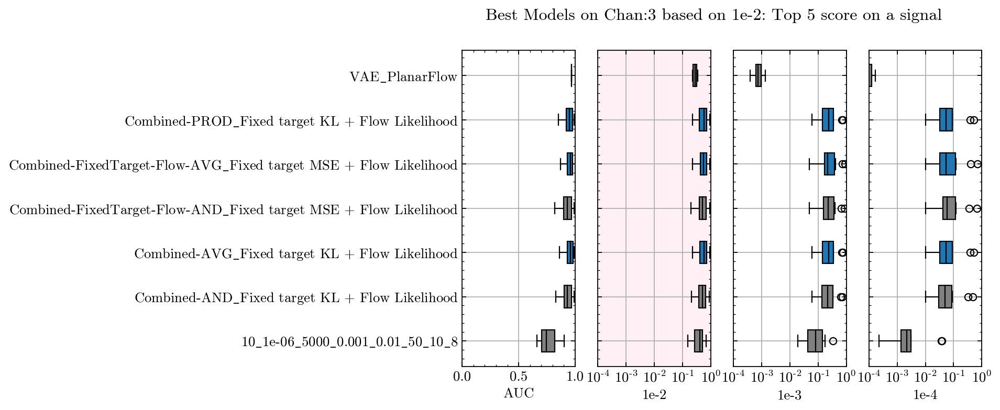

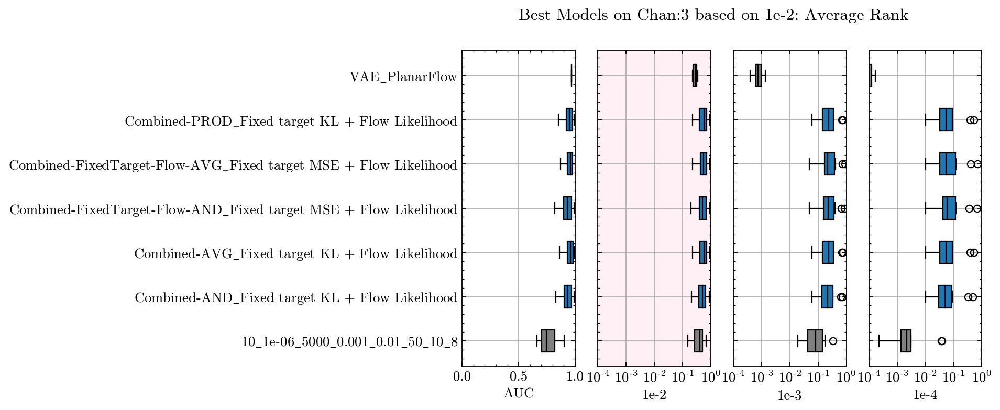

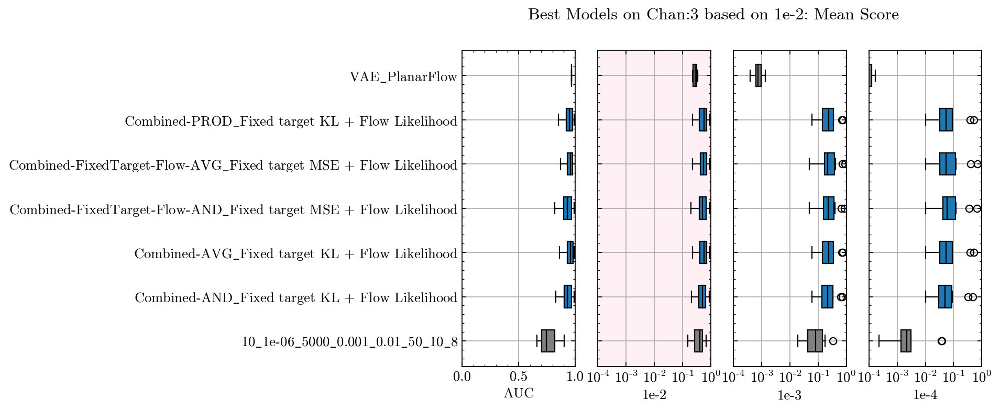

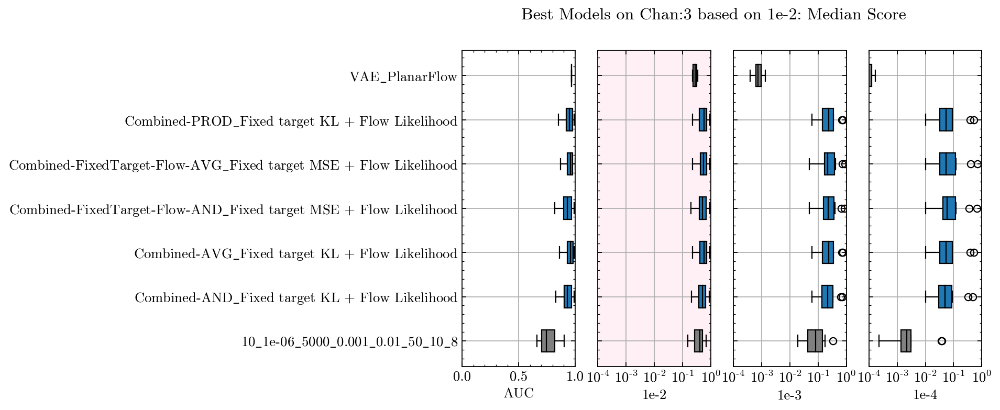

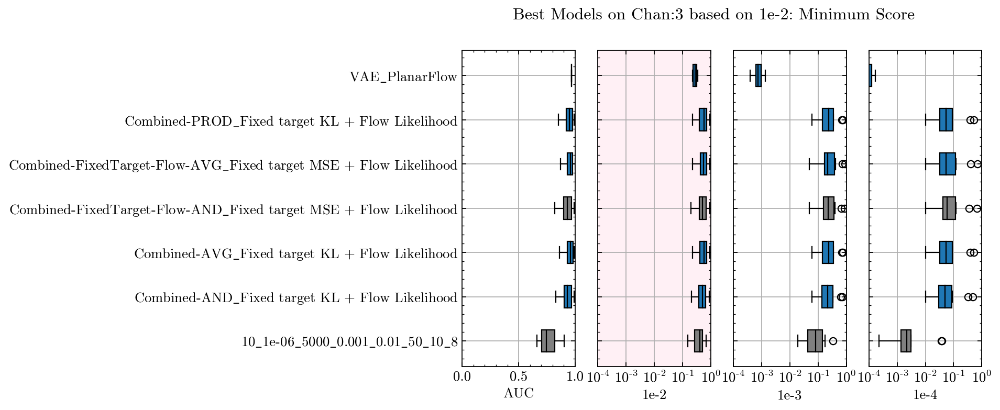

In [47]:
Analyze(AllCombined, 
        Chan='3', 
        Metric='1e-2',
        MetricNumberDict = {'top1': 3,
                            'top5': 3,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-3

3 glgl1400_neutralino1100
3 glgl1600_neutralino800
3 gluino_1000.0_neutralino_1.0
3 monoV_Zp2000.0_DM_1.0
3 monojet_Zp2000.0_DM_50.0
3 monotop_200_A
3 sqsq1_sq1400_neut800
3 sqsq_sq1800_neut800
3 stlp_st1000
3 stop2b1000_neutralino300
****************************************
Models from chan=3 ranked by metric=1e-3 sorted by top1
                                                  Model  top1
481   Combined-FixedTarget-Flow-AVG_Fixed target MSE...     5
1038                                           crude_AE     2
****************************************

****************************************
Models from chan=3 ranked by metric=1e-3 sorted by top5
                                               Model  top5
474   Combined-AND_Fixed target KL + Flow Likelihood    10
476  Combined-PROD_Fixed target KL + Flow Likelihood    10
477   Combined-AVG_Fixed target KL + Flow Likelihood    10
****************************************

****************************************
Models from chan=3 ranke

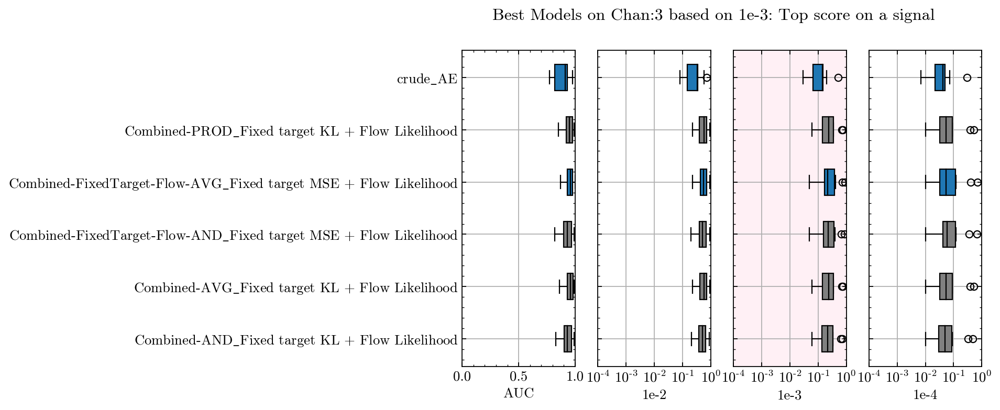

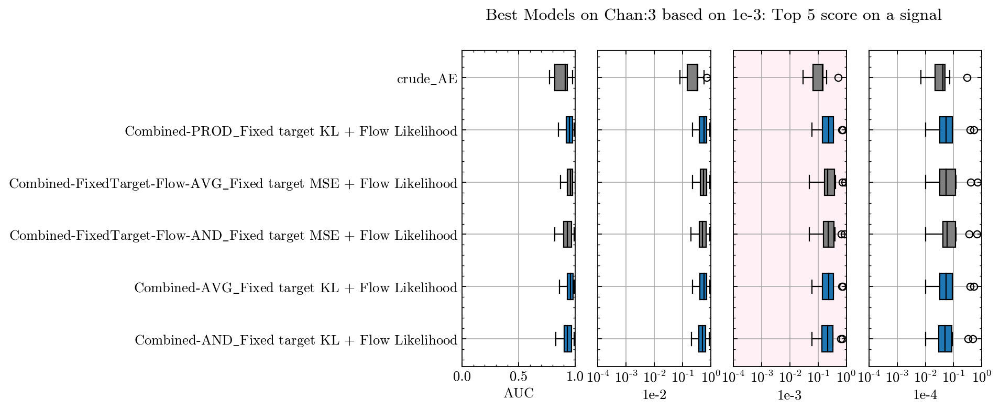

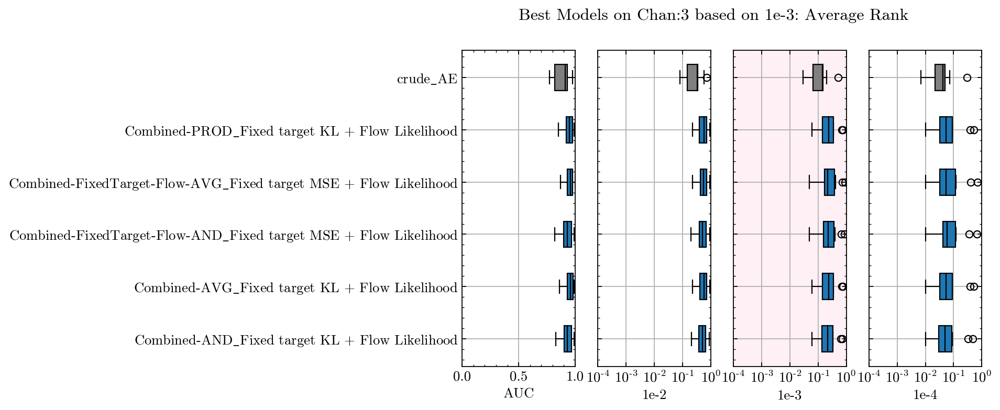

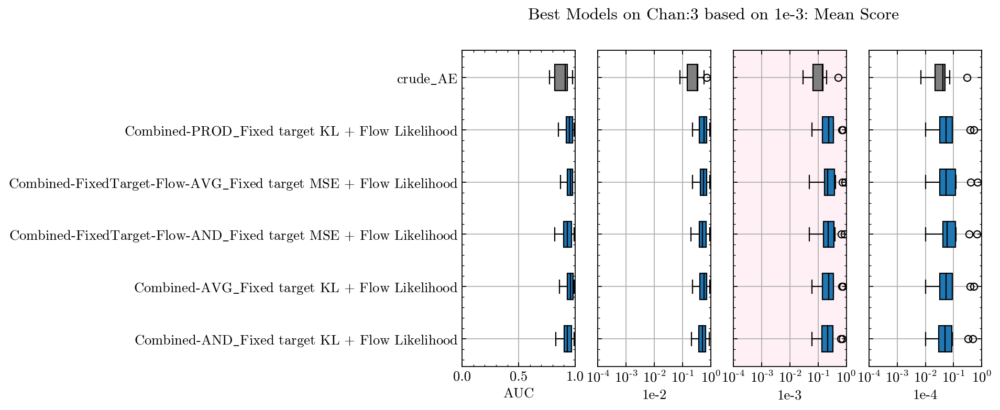

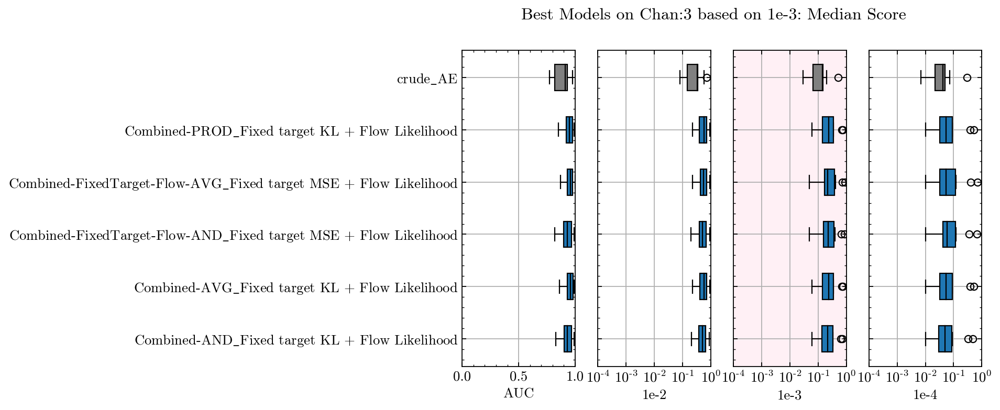

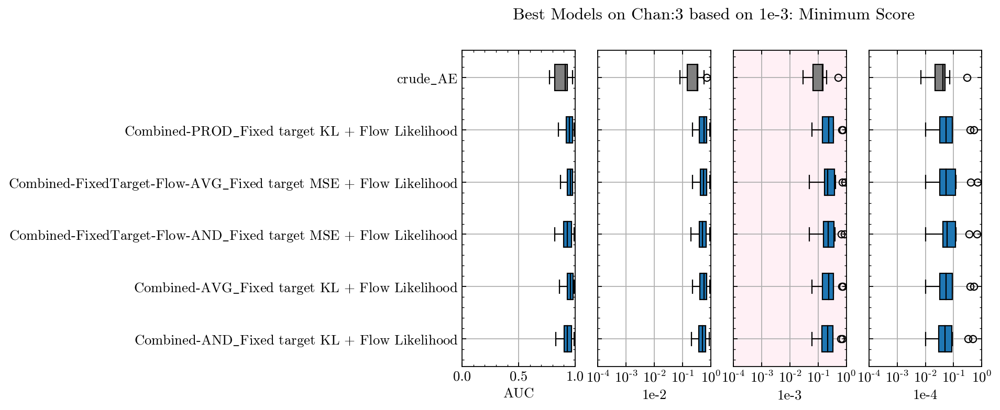

In [48]:
Analyze(AllCombined, 
        Chan='3', 
        Metric='1e-3',
        MetricNumberDict = {'top1': 2,
                            'top5': 3,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-4

3 glgl1400_neutralino1100
3 glgl1600_neutralino800
3 gluino_1000.0_neutralino_1.0
3 monoV_Zp2000.0_DM_1.0
3 monojet_Zp2000.0_DM_50.0
3 monotop_200_A
3 sqsq1_sq1400_neut800
3 sqsq_sq1800_neut800
3 stlp_st1000
3 stop2b1000_neutralino300
****************************************
Models from chan=3 ranked by metric=1e-4 sorted by top1
                                                  Model  top1
481   Combined-FixedTarget-Flow-AVG_Fixed target MSE...     3
554                  DeepSet Fixed target KL weight_1.0     2
1038                                           crude_AE     2
478   Combined-FixedTarget-Flow-AND_Fixed target MSE...     2
****************************************

****************************************
Models from chan=3 ranked by metric=1e-4 sorted by top5
                                                 Model  top5
478  Combined-FixedTarget-Flow-AND_Fixed target MSE...     8
481  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     7
477     Combined-AVG_Fixed target KL

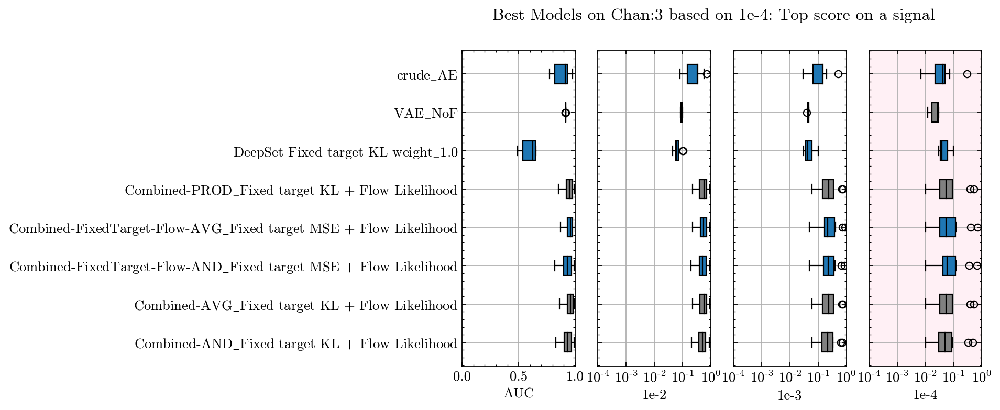

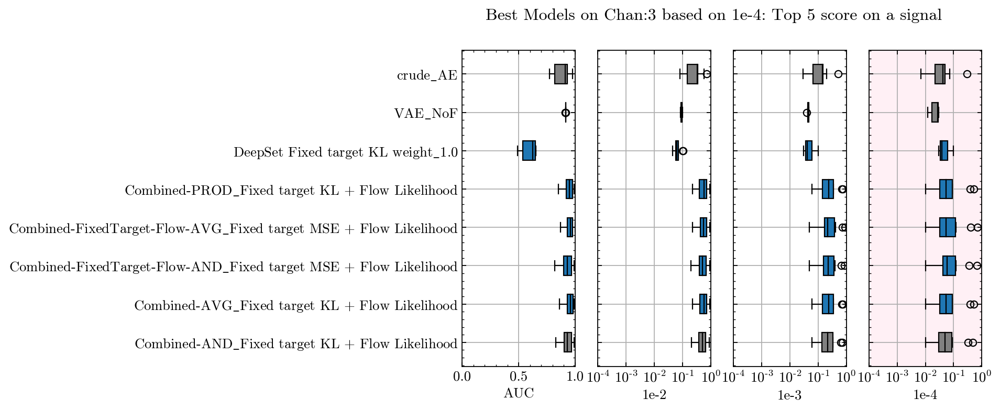

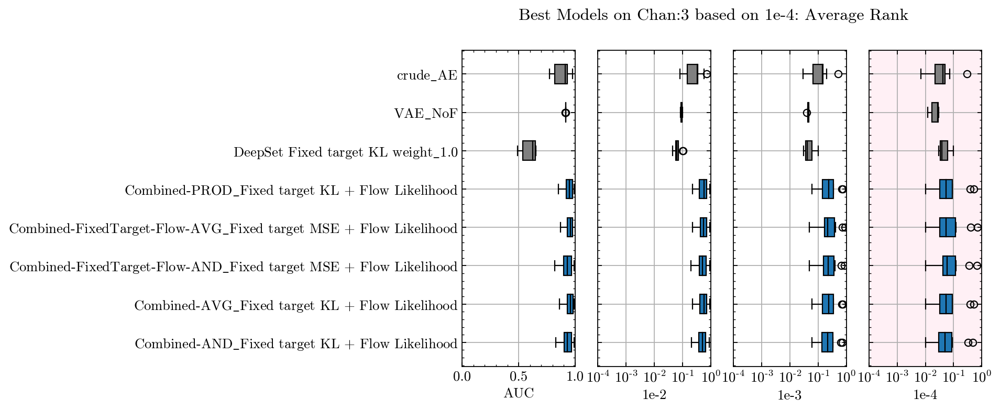

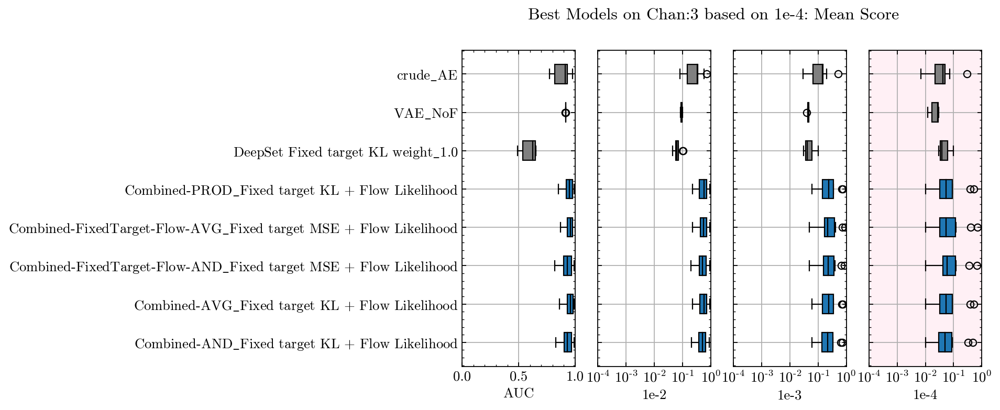

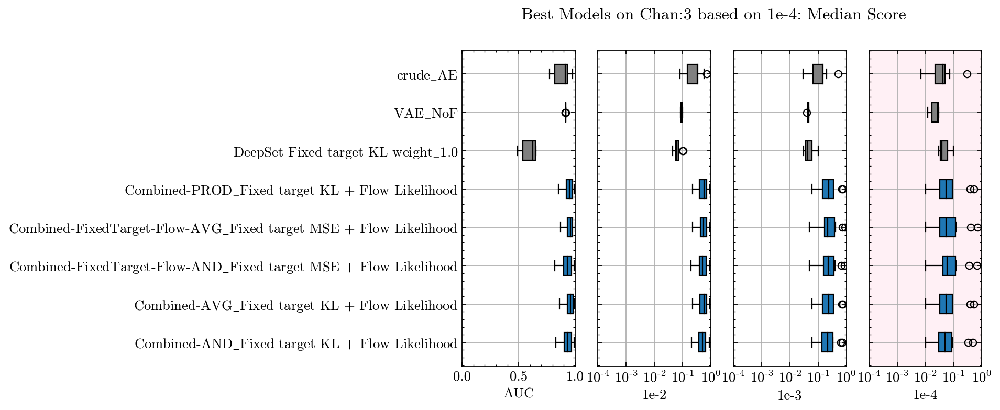

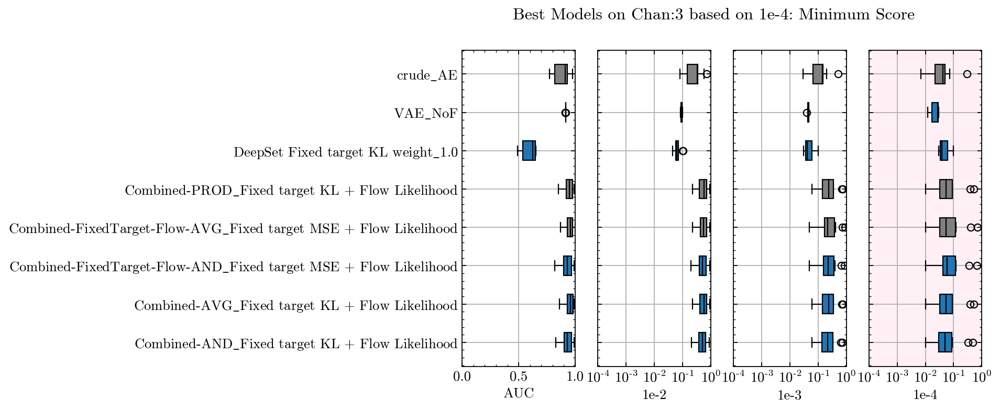

In [49]:
Analyze(AllCombined, 
        Chan='3', 
        Metric='1e-4',
        MetricNumberDict = {'top1': 4,
                            'top5': 5,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

## All Channels combined
### AUC

1 glgl1400_neutralino1100
1 glgl1600_neutralino800
1 monojet_Zp2000.0_DM_50.0
1 monotop_200_A
1 sqsq1_sq1400_neut800
1 sqsq_sq1800_neut800
1 stlp_st1000
1 stop2b1000_neutralino300
2a chaneut_cha200_neut50
2a chaneut_cha250_neut150
2a chaneut_cha300_neut100
2a chaneut_cha400_neut200
2a gluino_1000.0_neutralino_1.0
2a pp23mt_50
2a pp24mt_50
2b chacha_cha300_neut140
2b chacha_cha400_neut60
2b chacha_cha600_neut200
2b chaneut_cha200_neut50
2b chaneut_cha250_neut150
2b gluino_1000.0_neutralino_1.0
2b pp23mt_50
2b pp24mt_50
2b stlp_st1000
3 glgl1400_neutralino1100
3 glgl1600_neutralino800
3 gluino_1000.0_neutralino_1.0
3 monoV_Zp2000.0_DM_1.0
3 monojet_Zp2000.0_DM_50.0
3 monotop_200_A
3 sqsq1_sq1400_neut800
3 sqsq_sq1800_neut800
3 stlp_st1000
3 stop2b1000_neutralino300
****************************************
Models from chan=All ranked by metric=AUC sorted by top1
                                                 Model  top1
290                                 VAE_HouseholderSNF     6
481  C

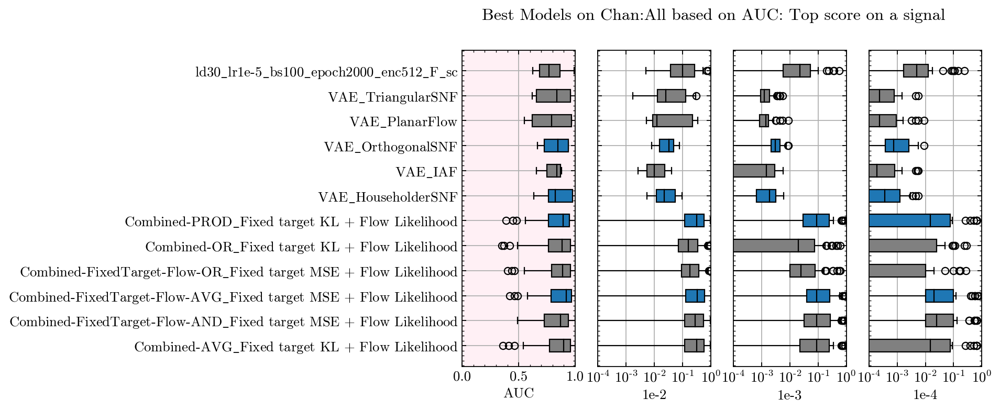

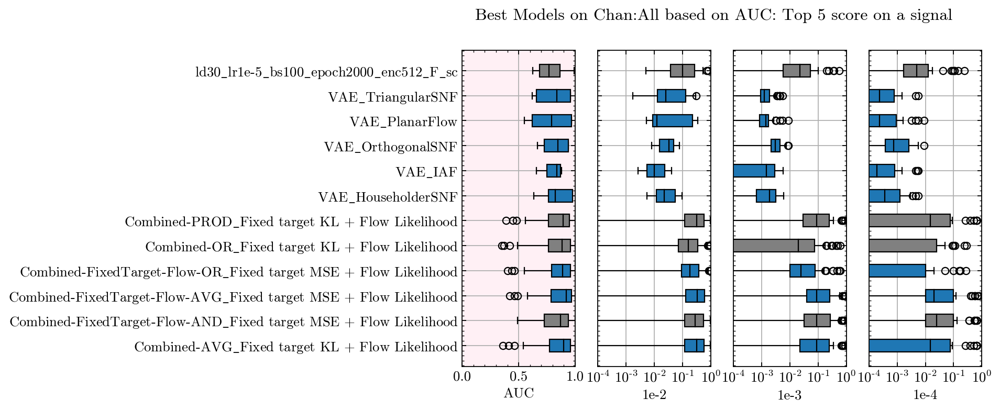

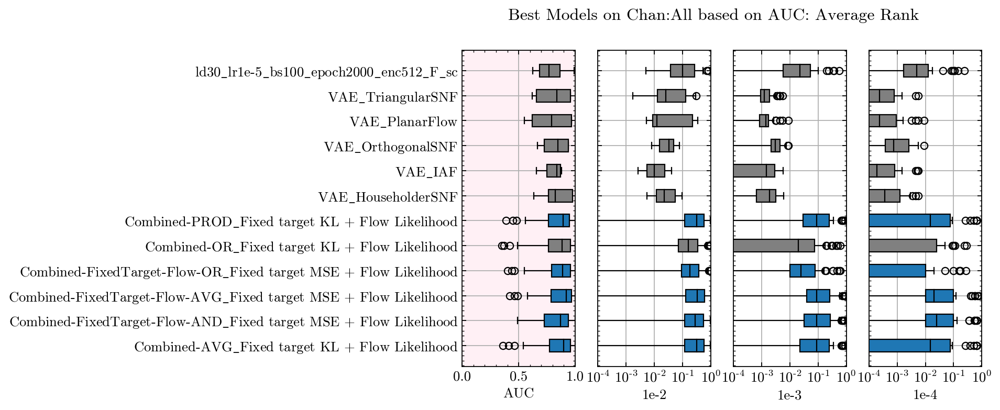

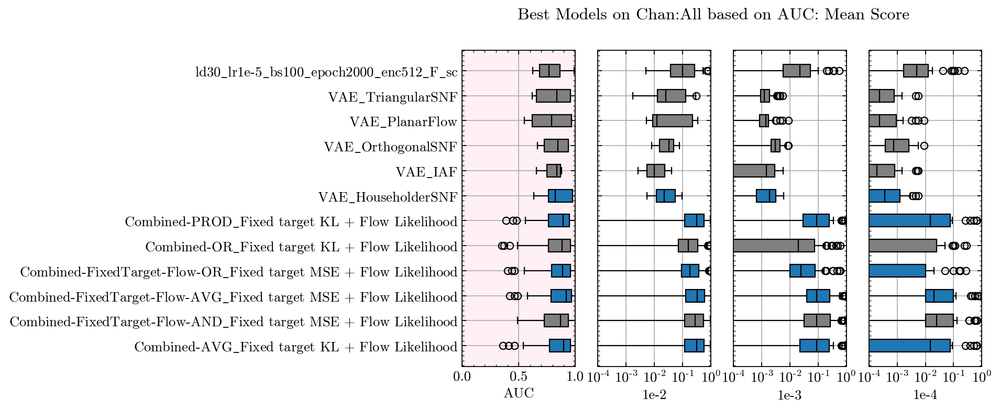

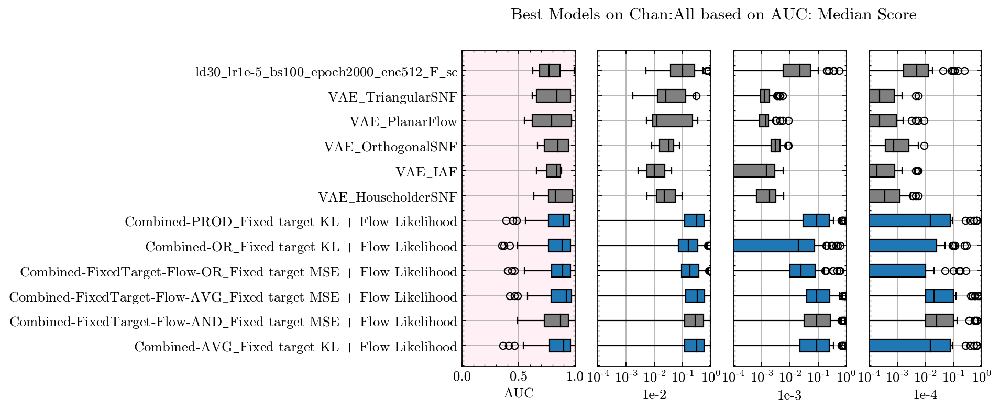

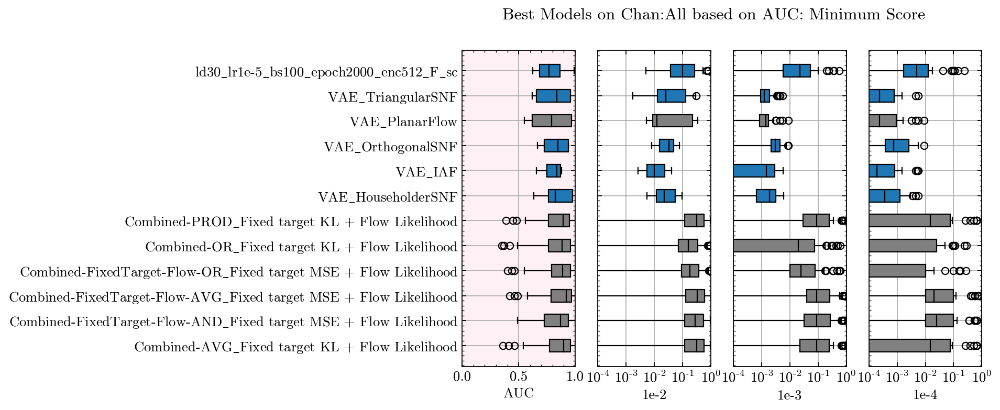

In [50]:
Analyze(AllCombined, 
        Chan='All', 
        Metric='AUC',
        MetricNumberDict = {'top1': 4,
                            'top5': 8,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-2

1 glgl1400_neutralino1100
1 glgl1600_neutralino800
1 monojet_Zp2000.0_DM_50.0
1 monotop_200_A
1 sqsq1_sq1400_neut800
1 sqsq_sq1800_neut800
1 stlp_st1000
1 stop2b1000_neutralino300
2a chaneut_cha200_neut50
2a chaneut_cha250_neut150
2a chaneut_cha300_neut100
2a chaneut_cha400_neut200
2a gluino_1000.0_neutralino_1.0
2a pp23mt_50
2a pp24mt_50
2b chacha_cha300_neut140
2b chacha_cha400_neut60
2b chacha_cha600_neut200
2b chaneut_cha200_neut50
2b chaneut_cha250_neut150
2b gluino_1000.0_neutralino_1.0
2b pp23mt_50
2b pp24mt_50
2b stlp_st1000
3 glgl1400_neutralino1100
3 glgl1600_neutralino800
3 gluino_1000.0_neutralino_1.0
3 monoV_Zp2000.0_DM_1.0
3 monojet_Zp2000.0_DM_50.0
3 monotop_200_A
3 sqsq1_sq1400_neut800
3 sqsq_sq1800_neut800
3 stlp_st1000
3 stop2b1000_neutralino300
****************************************
Models from chan=All ranked by metric=1e-2 sorted by top1
                                                 Model  top1
481  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     8
997  

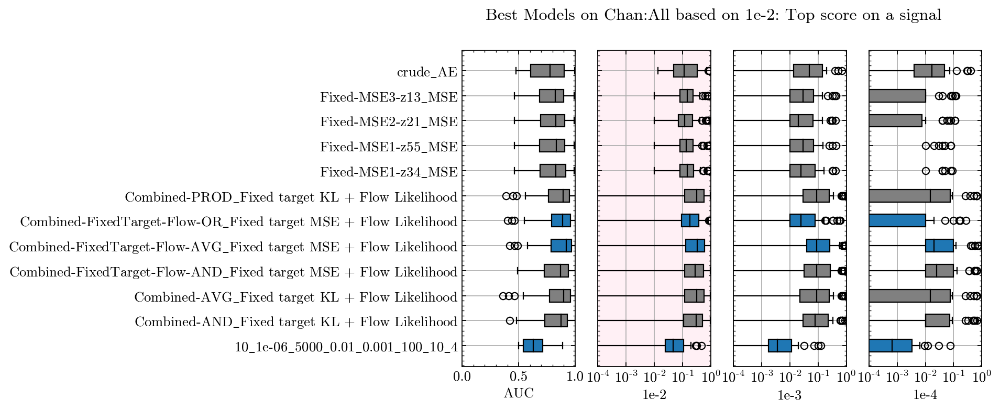

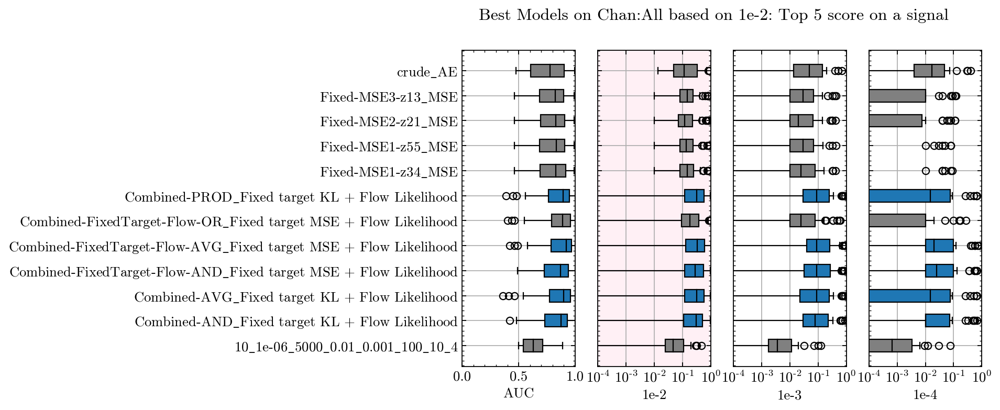

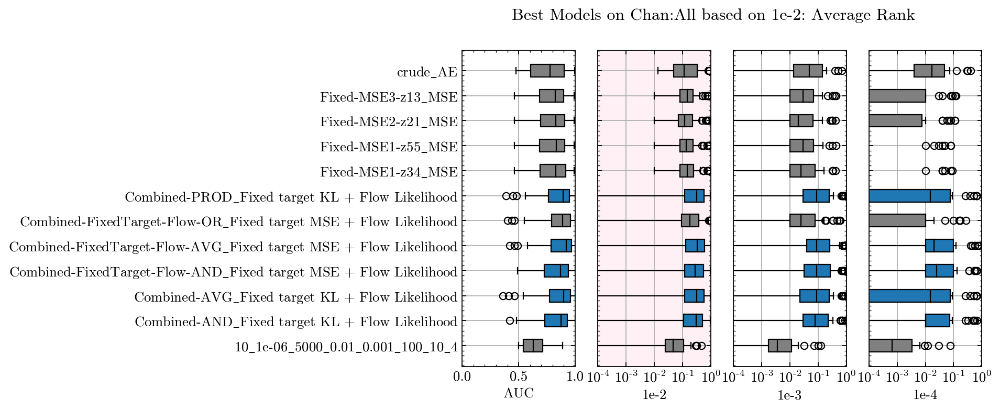

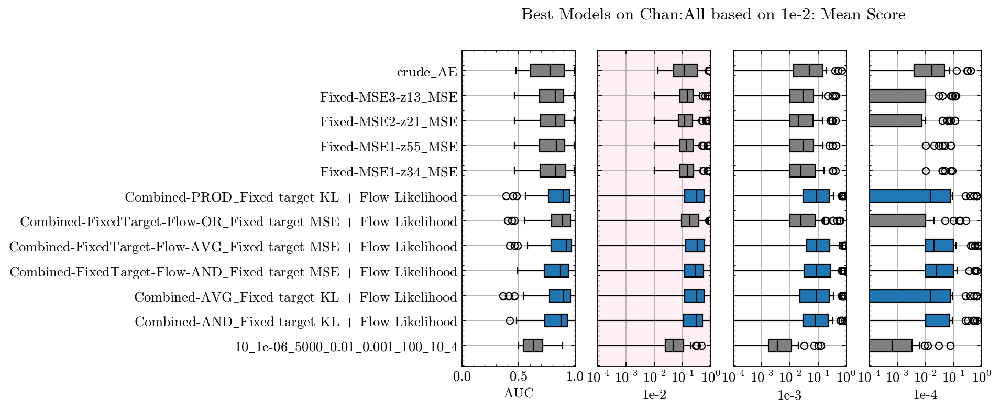

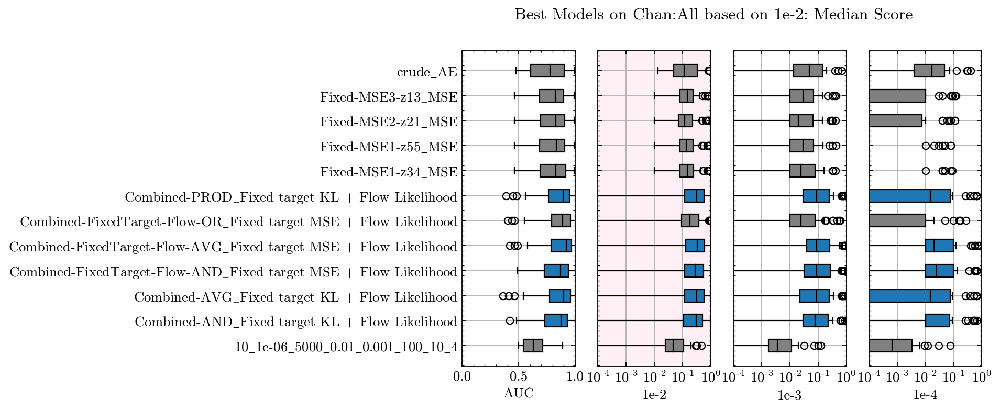

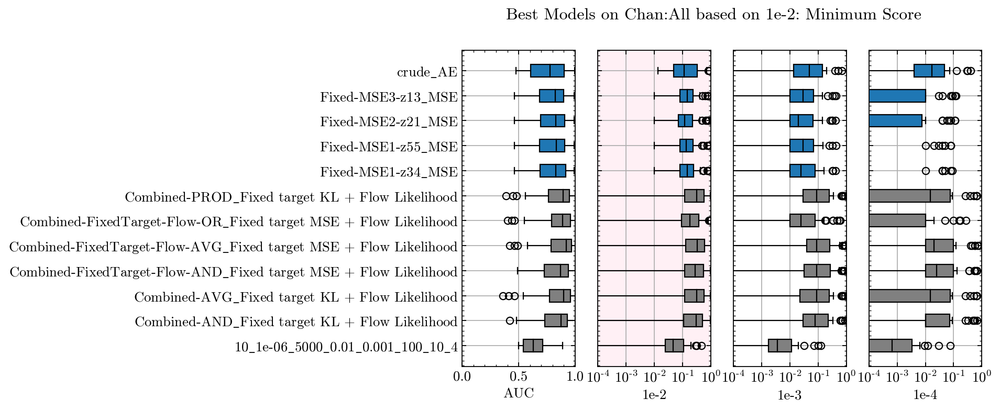

In [51]:
Analyze(AllCombined, 
        Chan='All', 
        Metric='1e-2',
        MetricNumberDict = {'top1': 3,
                            'top5': 5,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-3

1 glgl1400_neutralino1100
1 glgl1600_neutralino800
1 monojet_Zp2000.0_DM_50.0
1 monotop_200_A
1 sqsq1_sq1400_neut800
1 sqsq_sq1800_neut800
1 stlp_st1000
1 stop2b1000_neutralino300
2a chaneut_cha200_neut50
2a chaneut_cha250_neut150
2a chaneut_cha300_neut100
2a chaneut_cha400_neut200
2a gluino_1000.0_neutralino_1.0
2a pp23mt_50
2a pp24mt_50
2b chacha_cha300_neut140
2b chacha_cha400_neut60
2b chacha_cha600_neut200
2b chaneut_cha200_neut50
2b chaneut_cha250_neut150
2b gluino_1000.0_neutralino_1.0
2b pp23mt_50
2b pp24mt_50
2b stlp_st1000
3 glgl1400_neutralino1100
3 glgl1600_neutralino800
3 gluino_1000.0_neutralino_1.0
3 monoV_Zp2000.0_DM_1.0
3 monojet_Zp2000.0_DM_50.0
3 monotop_200_A
3 sqsq1_sq1400_neut800
3 sqsq_sq1800_neut800
3 stlp_st1000
3 stop2b1000_neutralino300
****************************************
Models from chan=All ranked by metric=1e-3 sorted by top1
                                                  Model  top1
481   Combined-FixedTarget-Flow-AVG_Fixed target MSE...     6
103

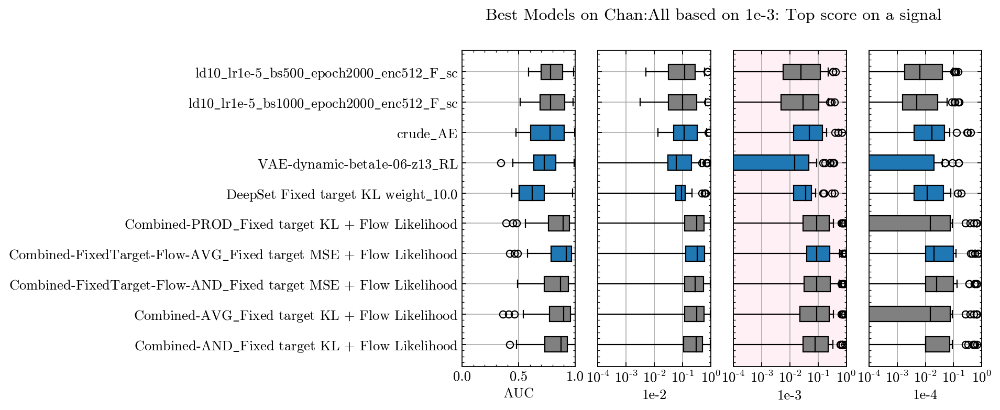

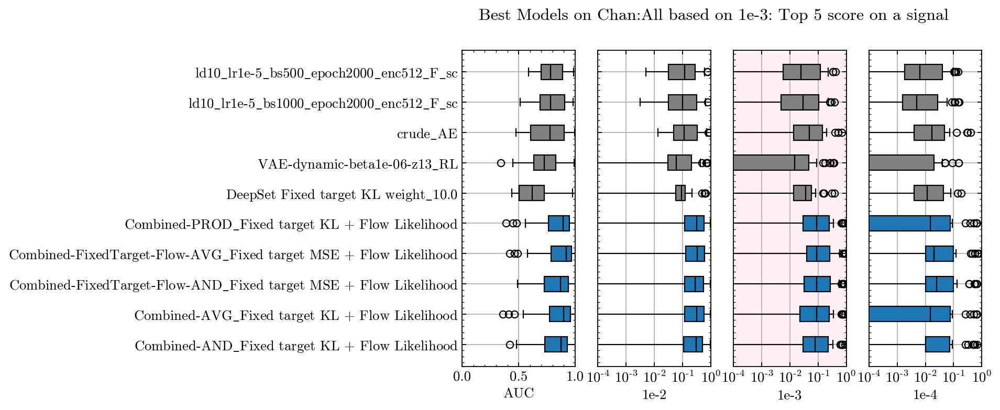

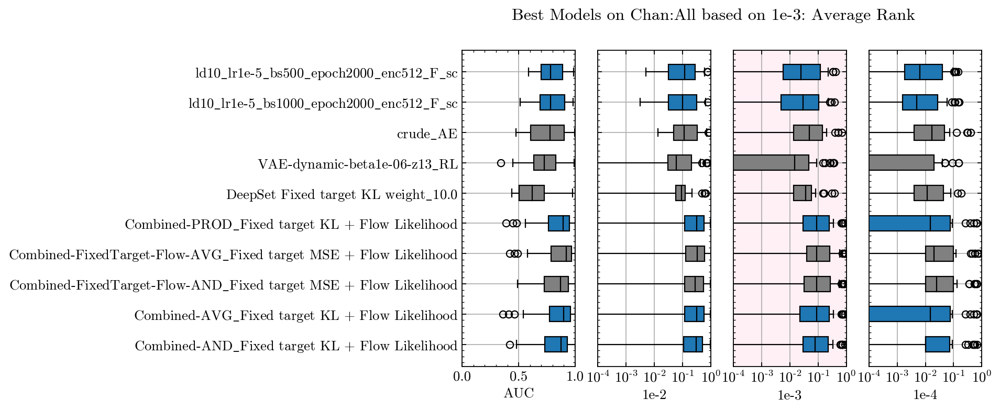

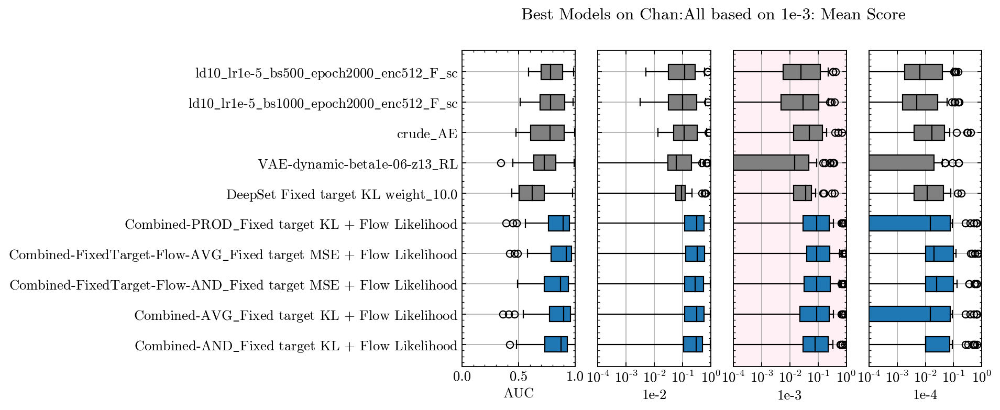

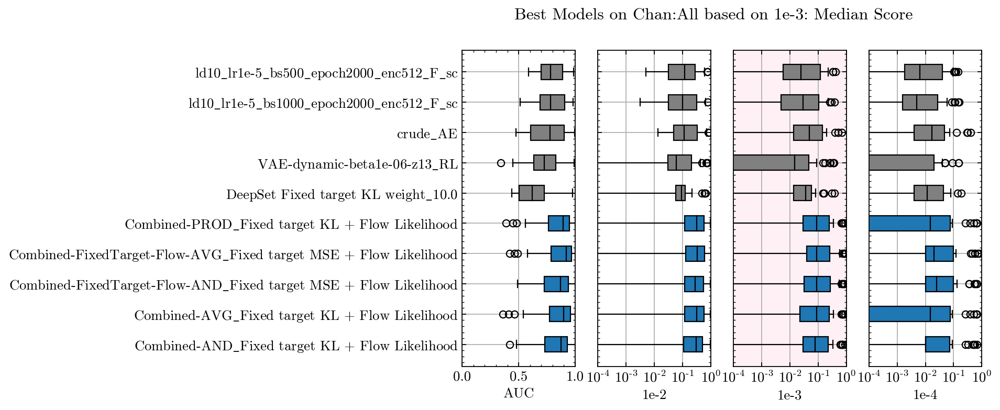

In [52]:
Analyze(AllCombined, 
        Chan='All', 
        Metric='1e-3',
        MetricNumberDict = {'top1': 4,
                            'top5': 5,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 0},
        Plot=True
       )

### 1e-4

1 glgl1400_neutralino1100
1 glgl1600_neutralino800
1 monojet_Zp2000.0_DM_50.0
1 monotop_200_A
1 sqsq1_sq1400_neut800
1 sqsq_sq1800_neut800
1 stlp_st1000
1 stop2b1000_neutralino300
2a chaneut_cha200_neut50
2a chaneut_cha250_neut150
2a chaneut_cha300_neut100
2a chaneut_cha400_neut200
2a gluino_1000.0_neutralino_1.0
2a pp23mt_50
2a pp24mt_50
2b chacha_cha300_neut140
2b chacha_cha400_neut60
2b chacha_cha600_neut200
2b chaneut_cha200_neut50
2b chaneut_cha250_neut150
2b gluino_1000.0_neutralino_1.0
2b pp23mt_50
2b pp24mt_50
2b stlp_st1000
3 glgl1400_neutralino1100
3 glgl1600_neutralino800
3 gluino_1000.0_neutralino_1.0
3 monoV_Zp2000.0_DM_1.0
3 monojet_Zp2000.0_DM_50.0
3 monotop_200_A
3 sqsq1_sq1400_neut800
3 sqsq_sq1800_neut800
3 stlp_st1000
3 stop2b1000_neutralino300
****************************************
Models from chan=All ranked by metric=1e-4 sorted by top1
                                                 Model  top1
555                DeepSet Fixed target KL weight_10.0     5
481  

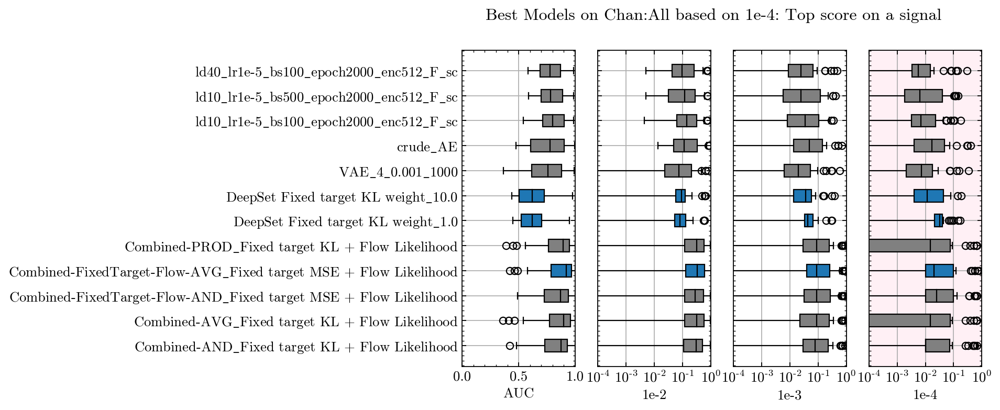

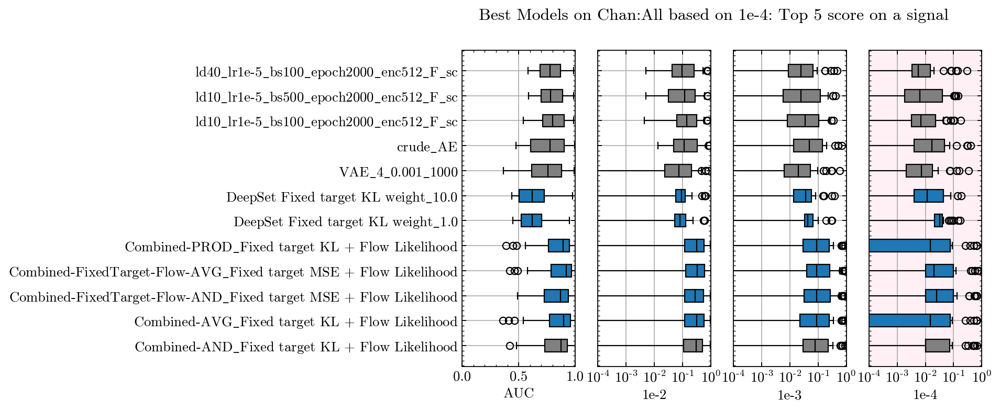

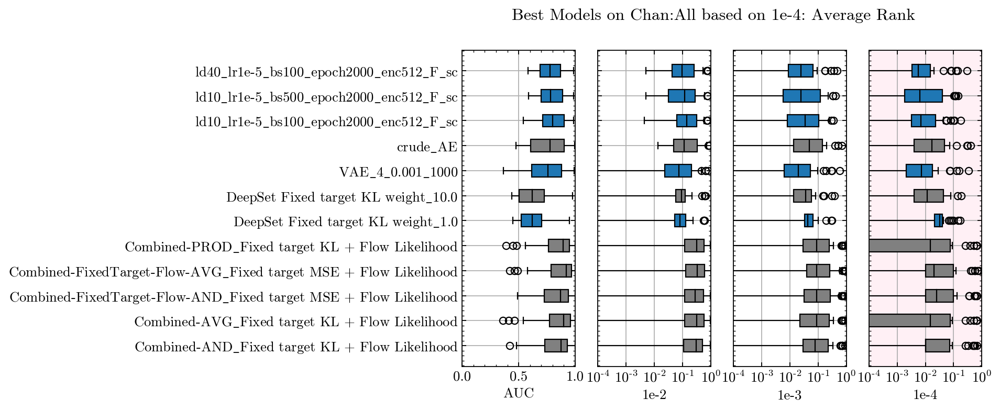

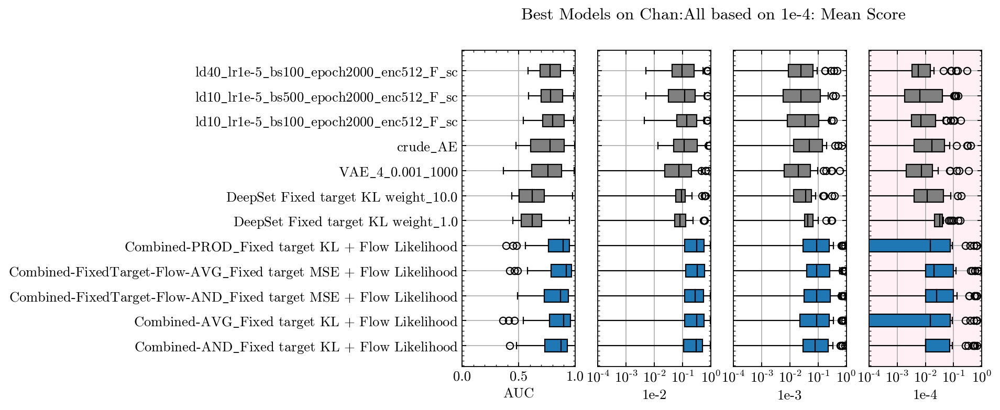

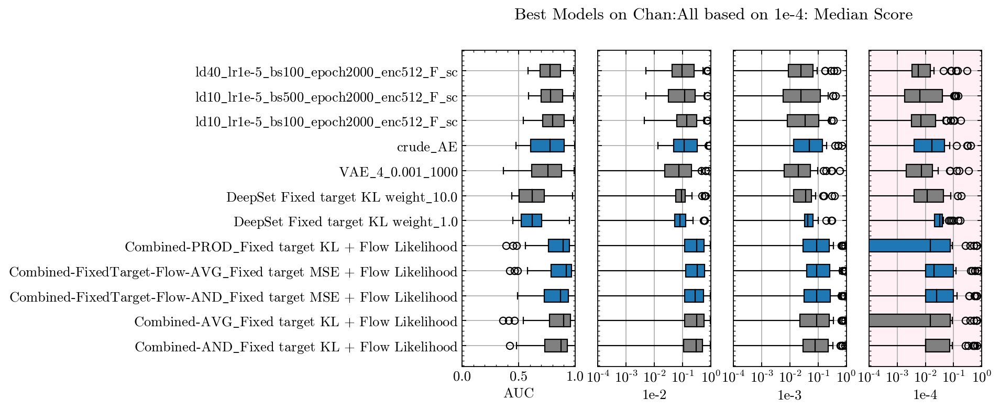

In [53]:
Analyze(AllCombined, 
        Chan='All', 
        Metric='1e-4',
        MetricNumberDict = {'top1': 3,
                            'top5': 6,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 0},
        Plot=True
       )

# Second combination
In the previous analysis, the models were grouped by how they did on the same metric, i.e. AUC or 1e-2. Each plot was then looking at a different ways of determining which models are best by that metric.

In the next analysis, the rolls will be flipped. The models will be grouped by the method of determining which does best, i.e. having the highest minimum or the highest average. The models which do best by this method for each metric will be shown on the same plot.

In [54]:
def AnalyzeByMethod(CombinedDataFrame, Chan, Method, MetricNumberDict, Plot):
    """
    Inputs:
        CombineedDataFrame: Pandas dataframe with columns ['Model', 'Signal', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
        Chan: String with which signal chanel is being analyzed. Must be one of ['1', '2a', '2b', '3', 'All']
        Method: String indicating the metric to use, must be one of ['top1', 'top5', 'AverageRank', 'MeanScore', 'MedianScore', 'MinScore']
        MetricNumberDict: The number of models to include for each sorting. Will usually include 5, 
            but some of the rankings need different numbers.
            example: MetricNumberDict = {'AUC': 5, 
                                         '1e-2': 5,
                                         '1e-3': 5,
                                         '1e-4': 5}
        Plot: Boolean if to make bar plots or not
        
    """
    for col in ['Model', 'Signal', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']:
        if col not in CombinedDataFrame.columns:
            print(f'CombinedDataFrame is missing column {col}')
            return 0
    if Chan not in ['1', '2a', '2b', '3', 'All']:
        print(f'Invalid "Chan" selection: {Chan}')
        return 0
    if Method not in ['top1', 'top5', 'AverageRank', 'MeanScore', 'MedianScore', 'MinScore']:
        print(f'Invalid "Method" selection: {Method}')
        return 0
    
    if Chan != 'All':
        AnalyzeFrame = CombinedDataFrame[CombinedDataFrame['Chan'] == Chan]
    else:
        AnalyzeFrame = CombinedDataFrame
    
    # This helper variable combines the channel and signal since some signals appear in multiple channels
    chansig = AnalyzeFrame['Chan'] + '/' + AnalyzeFrame['Signal']
    chansig = np.unique(chansig)
    sigs = AnalyzeFrame.Signal.unique()
    mods = AnalyzeFrame.Model.unique()
    SortedScores = pd.DataFrame()
    SortedScores['Model'] = mods
    
    SortedScores = {}
    BestC = []
    TopDict = {}
    for Metric in ['AUC', '1e-2', '1e-3', '1e-4']:
        SortedScores[Metric] = pd.DataFrame()
        SortedScores[Metric]['Model'] = mods
        
        # Go through each of the signals to find the ranking of the models for AUC

        for sig in chansig:
            chan, sig = sig.split('/')
            cs = AnalyzeFrame[(AnalyzeFrame['Signal'] == sig) & (AnalyzeFrame['Chan']==chan)]
            scorelist = cs[Metric]
            score_ranking = np.zeros_like(scorelist)
            for i, score in enumerate(np.argsort(-scorelist)):  # argsort gives the ordering to sort them, we want the orthogonal information
                score_ranking[score] = i
            SortedScores[Metric][sig] = score_ranking
        SortedScores[Metric]['AverageRank'] = SortedScores[Metric][[col for col in SortedScores[Metric].columns if 'Model' not in col]].mean(axis=1)
        SortedScores[Metric]['top1'] = (SortedScores[Metric][[col for col in SortedScores[Metric].columns if (('AverageRank' not in col)
                                                                                      and ('Model' not in col)
                                                                                     )]] < 1).sum(axis=1)
        SortedScores[Metric]['top5'] = (SortedScores[Metric][[col for col in SortedScores[Metric].columns if (('AverageRank' not in col) and 
                                                                                      ('top1' not in col) and
                                                                                      ('Model' not in col)
                                                                                     )]] < 5).sum(axis=1)

        meanscore = []
        medianscore = []
        minscore = []
        for m in mods:
            tmpdf = AnalyzeFrame[AnalyzeFrame['Model'] == m]
            tmpscores = tmpdf[Metric]
            meanscore.append(tmpscores.mean())
            medianscore.append(tmpscores.median())
            minscore.append(tmpscores.min())
        SortedScores[Metric]['MeanScore'] = meanscore
        SortedScores[Metric]['MedianScore'] = medianscore
        SortedScores[Metric]['MinScore'] = minscore
    
        num = MetricNumberDict[Metric]
        if num == 0: continue
        TopDict[Metric] = SortedScores[Metric].sort_values(by=Method,ascending=True if Method =='AverageRank' else False)[['Model']][:num].to_numpy().reshape(num)
        BestC += list(TopDict[Metric])
        print('*'*40)
        print(f'Models from chan={Chan} ranked by metric={Metric} sorted by {Method}')
        print(SortedScores[Metric].sort_values(by=Method,ascending=True if Method =='AverageRank' else False)[['Model', Method]][:num])
        print('*'*40)
        print()
        
    if Plot:
        nameddict = {'top1': 'Top score on a signal',
                     'top5': 'Top 5 score on a signal',
                     'AverageRank': 'Average Rank',
                     'MeanScore': 'Mean Score',
                     'MedianScore': 'Median Score',
                     'MinScore': 'Minimum Score'
                    }
        name = nameddict[Method]
        BestC = np.array(BestC).flatten()
        BestCU = np.unique(BestC)
        
        plt.figure(figsize=(8, 5))

        for colnum, col in enumerate(['AUC', '1e-2', '1e-3', '1e-4']):
            colors = ['grey' for m in BestCU]
            
            if col in TopDict:
                for bestnum, m in enumerate(TopDict[col]):
                    for mnum, mtop in enumerate(BestCU):
                        if m == mtop:
                            colors[mnum] = f'C{bestnum}'
            ax = plt.subplot(1, 4, colnum + 1)
            yvs=[]
            names = []
            data_all = []
            for i,m in enumerate(BestCU):
                tmp_data = []
                tmpdf = AnalyzeFrame[AnalyzeFrame['Model']==m].copy()
                for s in chansig:
                    chan, s = s.split('/')
                    tmpauc = tmpdf[(tmpdf['Signal'] == s) & (tmpdf['Chan']==chan)][col]
                    tmp_data.append(tmpauc)
                data_all.append(np.array(tmp_data).reshape(len(chansig)))
                yvs.append(i)
                names.append(m)
            databp = np.array(data_all).reshape(len(BestCU), len(chansig))
            databp[databp == 0] = 1e-10
            bbox1 = plt.boxplot(databp.T,
                        vert=False,
                        manage_ticks=False,
                        patch_artist=True,
                        medianprops={'color':'k'},
                        positions=yvs
                       )

            if colnum == 0:
                plt.yticks(yvs, [n.replace('_', r'$\_$') for n in names])
                plt.xlim(0, 1)
            else:
                plt.yticks(yvs, [])
                plt.xscale('log')
                plt.xlim(1e-4, 1)
                plt.xticks([1e-4, 1e-3, 1e-2, 1e-1, 1e0])


            for patch, color, flier in zip(bbox1['boxes'], colors, bbox1['fliers']):
                patch.set_facecolor(color)
                flier.set_markerfacecolor(color)
                flier.set_markerfacecolor(color)
                flier.set_markeredgecolor(color)
            plt.minorticks_on()
            plt.grid()
            
            if col == 'AUC':
                plt.xlabel(col)
            elif col == '1e-2':
                plt.xlabel(r'$\epsilon_S(\epsilon_B=10^{-2})$')
            elif col == '1e-3':
                plt.xlabel(r'$\epsilon_S(\epsilon_B=10^{-3})$')
            elif col == '1e-4':
                plt.xlabel(r'$\epsilon_S(\epsilon_B=10^{-4})$')
            
        legend_elements = [Patch(facecolor='C0', edgecolor='k',
                         label='Best'),
                   Patch(facecolor='C1', edgecolor='k',
                         label='2nd'),
                   Patch(facecolor='C2', edgecolor='k',
                         label='3rd'),
                   Patch(facecolor='C3', edgecolor='k',
                         label='4th'),
                   Patch(facecolor='C4', edgecolor='k',
                         label='5th')
                  ]
        plt.legend(handles=legend_elements, 
                   loc=(1.05,0.3), 
                   labelspacing=1,
#                    ncol=5,
                   facecolor='white',
                   framealpha=1,
        #            markerscale=100,
                   frameon=True)

        plt.suptitle(f'Best models on all channels combined based on {name.lower()}')
        plt.savefig(f'../reports/Plots/TopChan{Chan}_{name.replace(" ", "_")}_boxplot.pdf', bbox_inches='tight')  
        plt.close()

## All Channels
### Top 1

In [55]:
AnalyzeByMethod(AllCombined, 
                Chan='All', 
                Method='top1', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

****************************************
Models from chan=All ranked by metric=AUC sorted by top1
                                                 Model  top1
290                                 VAE_HouseholderSNF     6
481  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     4
291                                  VAE_OrthogonalSNF     4
476    Combined-PROD_Fixed target KL + Flow Likelihood     1
477     Combined-AVG_Fixed target KL + Flow Likelihood     1
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by top1
                                                 Model  top1
481  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     8
997                  10_1e-06_5000_0.01_0.001_100_10_4     3
479  Combined-FixedTarget-Flow-OR_Fixed target MSE ...     1
574             ld10_lr1e-5_bs100_epoch2000_enc512_L_1     1
609            ld30_lr1e-5_bs100_epoch2000_enc512_F_sc     1
*****************************

### Top 5

In [56]:
AnalyzeByMethod(AllCombined, 
                Chan='All', 
                Method='top5', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

****************************************
Models from chan=All ranked by metric=AUC sorted by top5
                                                 Model  top5
290                                 VAE_HouseholderSNF    10
292                                  VAE_TriangularSNF    10
291                                  VAE_OrthogonalSNF     9
481  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     9
289                                     VAE_PlanarFlow     8
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by top5
                                                 Model  top5
477     Combined-AVG_Fixed target KL + Flow Likelihood    12
476    Combined-PROD_Fixed target KL + Flow Likelihood    12
481  Combined-FixedTarget-Flow-AVG_Fixed target MSE...    10
478  Combined-FixedTarget-Flow-AND_Fixed target MSE...     9
474     Combined-AND_Fixed target KL + Flow Likelihood     7
*****************************

### Average Rank

In [57]:
AnalyzeByMethod(AllCombined, 
                Chan='All', 
                Method='AverageRank', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

****************************************
Models from chan=All ranked by metric=AUC sorted by AverageRank
                                                 Model  AverageRank
481  Combined-FixedTarget-Flow-AVG_Fixed target MSE...    19.105263
476    Combined-PROD_Fixed target KL + Flow Likelihood    26.526316
479  Combined-FixedTarget-Flow-OR_Fixed target MSE ...    29.578947
478  Combined-FixedTarget-Flow-AND_Fixed target MSE...    33.421053
477     Combined-AVG_Fixed target KL + Flow Likelihood    33.526316
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by AverageRank
                                                 Model  AverageRank
481  Combined-FixedTarget-Flow-AVG_Fixed target MSE...    56.210526
477     Combined-AVG_Fixed target KL + Flow Likelihood    62.000000
476    Combined-PROD_Fixed target KL + Flow Likelihood    64.263158
474     Combined-AND_Fixed target KL + Flow Likelihood    76.684211

### Mean Score

In [58]:
AnalyzeByMethod(AllCombined, 
                Chan='All', 
                Method='MeanScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

****************************************
Models from chan=All ranked by metric=AUC sorted by MeanScore
                                                 Model  MeanScore
481  Combined-FixedTarget-Flow-AVG_Fixed target MSE...   0.845000
479  Combined-FixedTarget-Flow-OR_Fixed target MSE ...   0.833529
477     Combined-AVG_Fixed target KL + Flow Likelihood   0.831471
476    Combined-PROD_Fixed target KL + Flow Likelihood   0.827941
290                                 VAE_HouseholderSNF   0.820322
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by MeanScore
                                                 Model  MeanScore
481  Combined-FixedTarget-Flow-AVG_Fixed target MSE...   0.398235
477     Combined-AVG_Fixed target KL + Flow Likelihood   0.372941
476    Combined-PROD_Fixed target KL + Flow Likelihood   0.371471
478  Combined-FixedTarget-Flow-AND_Fixed target MSE...   0.367941
474     Combined-AND_Fixe

### Median Score

In [59]:
AnalyzeByMethod(AllCombined, 
                Chan='All', 
                Method='MedianScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

****************************************
Models from chan=All ranked by metric=AUC sorted by MedianScore
                                                 Model  MedianScore
481  Combined-FixedTarget-Flow-AVG_Fixed target MSE...        0.920
477     Combined-AVG_Fixed target KL + Flow Likelihood        0.900
476    Combined-PROD_Fixed target KL + Flow Likelihood        0.895
479  Combined-FixedTarget-Flow-OR_Fixed target MSE ...        0.890
475      Combined-OR_Fixed target KL + Flow Likelihood        0.885
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by MedianScore
                                                 Model  MedianScore
481  Combined-FixedTarget-Flow-AVG_Fixed target MSE...        0.330
476    Combined-PROD_Fixed target KL + Flow Likelihood        0.315
477     Combined-AVG_Fixed target KL + Flow Likelihood        0.315
474     Combined-AND_Fixed target KL + Flow Likelihood        0.300

### Best Minimum Score

In [60]:
AnalyzeByMethod(AllCombined, 
                Chan='All', 
                Method='MinScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 0,
                                  '1e-4': 0}, 
                Plot=True
               )

****************************************
Models from chan=All ranked by metric=AUC sorted by MinScore
                                       Model  MinScore
291                        VAE_OrthogonalSNF  0.666274
293                                  VAE_IAF  0.655265
290                       VAE_HouseholderSNF  0.634438
609  ld30_lr1e-5_bs100_epoch2000_enc512_F_sc  0.624528
292                        VAE_TriangularSNF  0.617532
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by MinScore
                   Model  MinScore
1038            crude_AE  0.013274
520   Fixed-MSE3-z13_MSE  0.010000
512   Fixed-MSE2-z21_MSE  0.010000
504   Fixed-MSE1-z34_MSE  0.010000
505   Fixed-MSE1-z55_MSE  0.010000
****************************************



## Scan through individual channels
### Chan 1

In [61]:
AnalyzeByMethod(AllCombined, 
                Chan='1', 
                Method='MinScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

****************************************
Models from chan=1 ranked by metric=AUC sorted by MinScore
                                       Model  MinScore
294                    VAE_ConvolutionalFlow  0.770178
290                       VAE_HouseholderSNF  0.746779
577  ld10_lr1e-5_bs100_epoch2000_enc512_F_sc  0.732137
293                                  VAE_IAF  0.731834
470             VAE-dynamic-beta1-z34_Radius  0.730000
****************************************

****************************************
Models from chan=1 ranked by metric=1e-2 sorted by MinScore
                                                  Model  MinScore
303                                            PCA_D=10  0.111111
1038                                           crude_AE  0.106000
302                                             PCA_D=9  0.098765
481   Combined-FixedTarget-Flow-AVG_Fixed target MSE...  0.090000
874                    10_1e-06_1000_0.01_0.01_100_10_4  0.084473
*******************************

### Chan 2a

In [62]:
AnalyzeByMethod(AllCombined, 
                Chan='2a', 
                Method='MinScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 1,
                                  '1e-4': 0}, 
                Plot=True
               )

****************************************
Models from chan=2a ranked by metric=AUC sorted by MinScore
                  Model  MinScore
291   VAE_OrthogonalSNF  0.666274
292   VAE_TriangularSNF  0.655265
293             VAE_IAF  0.655265
290  VAE_HouseholderSNF  0.634438
288             VAE_NoF  0.632343
****************************************

****************************************
Models from chan=2a ranked by metric=1e-2 sorted by MinScore
                  Model  MinScore
1039            CNN_VAE  0.015097
291   VAE_OrthogonalSNF  0.013410
1038           crude_AE  0.013274
292   VAE_TriangularSNF  0.012903
293             VAE_IAF  0.012903
****************************************

****************************************
Models from chan=2a ranked by metric=1e-3 sorted by MinScore
        Model  MinScore
1039  CNN_VAE  0.003623
****************************************



### Chan 2b

In [63]:
AnalyzeByMethod(AllCombined, 
                Chan='2b', 
                Method='MinScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

****************************************
Models from chan=2b ranked by metric=AUC sorted by MinScore
                  Model  MinScore
291   VAE_OrthogonalSNF  0.845863
293             VAE_IAF  0.836889
292   VAE_TriangularSNF  0.836889
290  VAE_HouseholderSNF  0.822277
289      VAE_PlanarFlow  0.787935
****************************************

****************************************
Models from chan=2b ranked by metric=1e-2 sorted by MinScore
                                                 Model  MinScore
471                          Flow-Efficient_Likelihood      0.12
476    Combined-PROD_Fixed target KL + Flow Likelihood      0.12
477     Combined-AVG_Fixed target KL + Flow Likelihood      0.12
481  Combined-FixedTarget-Flow-AVG_Fixed target MSE...      0.12
472                     Flow-Efficient-No-E_Likelihood      0.11
****************************************

****************************************
Models from chan=2b ranked by metric=1e-3 sorted by MinScore
                 

### Chan 3

In [64]:
AnalyzeByMethod(AllCombined, 
                Chan='3', 
                Method='MinScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

****************************************
Models from chan=3 ranked by metric=AUC sorted by MinScore
                     Model  MinScore
290     VAE_HouseholderSNF  0.974891
289         VAE_PlanarFlow  0.966551
292      VAE_TriangularSNF  0.956197
291      VAE_OrthogonalSNF  0.938686
294  VAE_ConvolutionalFlow  0.914184
****************************************

****************************************
Models from chan=3 ranked by metric=1e-2 sorted by MinScore
                                                 Model  MinScore
476    Combined-PROD_Fixed target KL + Flow Likelihood  0.230000
481  Combined-FixedTarget-Flow-AVG_Fixed target MSE...  0.230000
477     Combined-AVG_Fixed target KL + Flow Likelihood  0.230000
289                                     VAE_PlanarFlow  0.228353
474     Combined-AND_Fixed target KL + Flow Likelihood  0.210000
****************************************

****************************************
Models from chan=3 ranked by metric=1e-3 sorted by MinScore
  

# Analysis of the Physics Signals

The goal of this part of the analysis is to determine which signals are easy for _most_ models to get and which ones are the most challenging for the unsupervised methods.

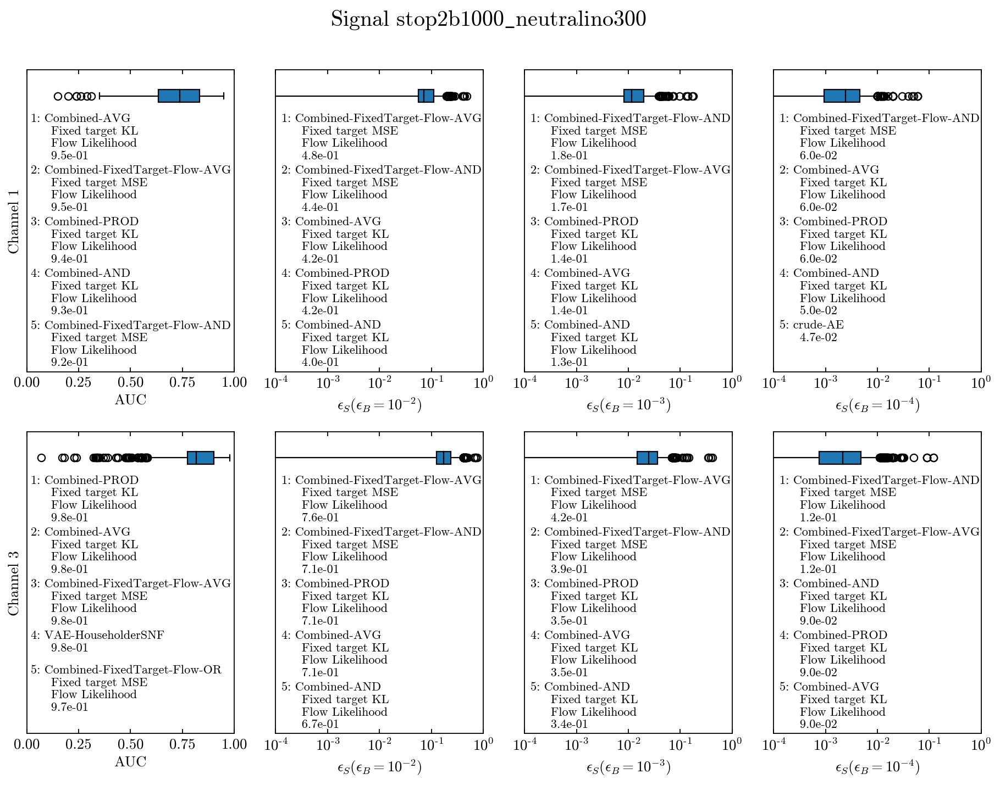

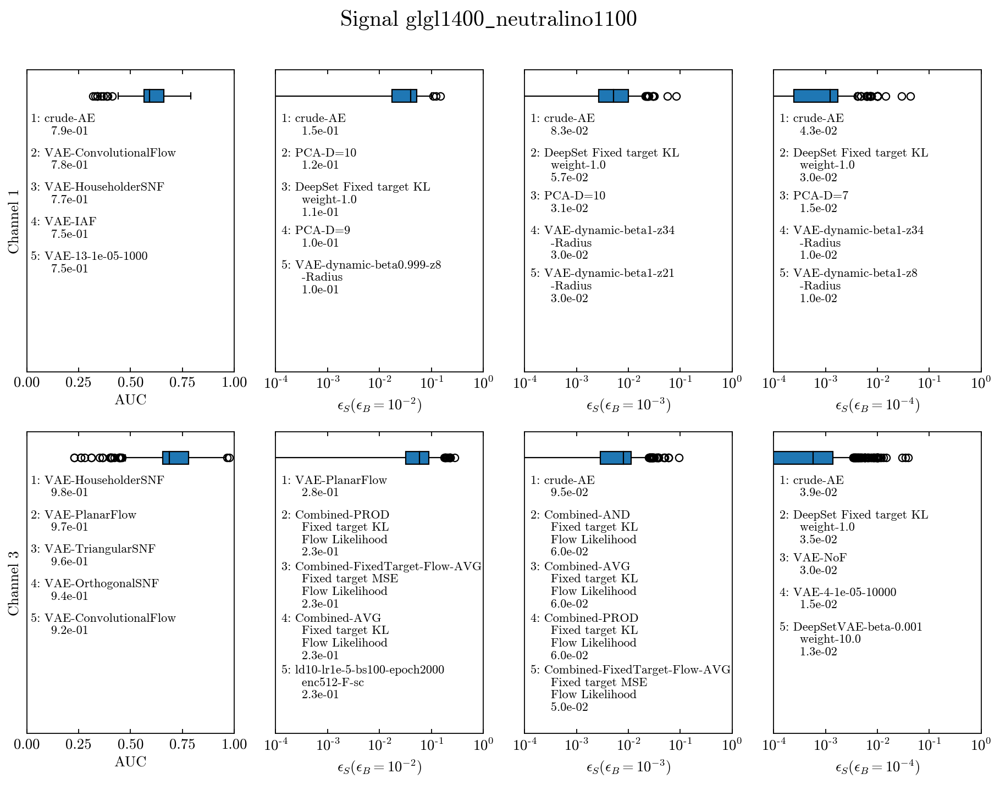

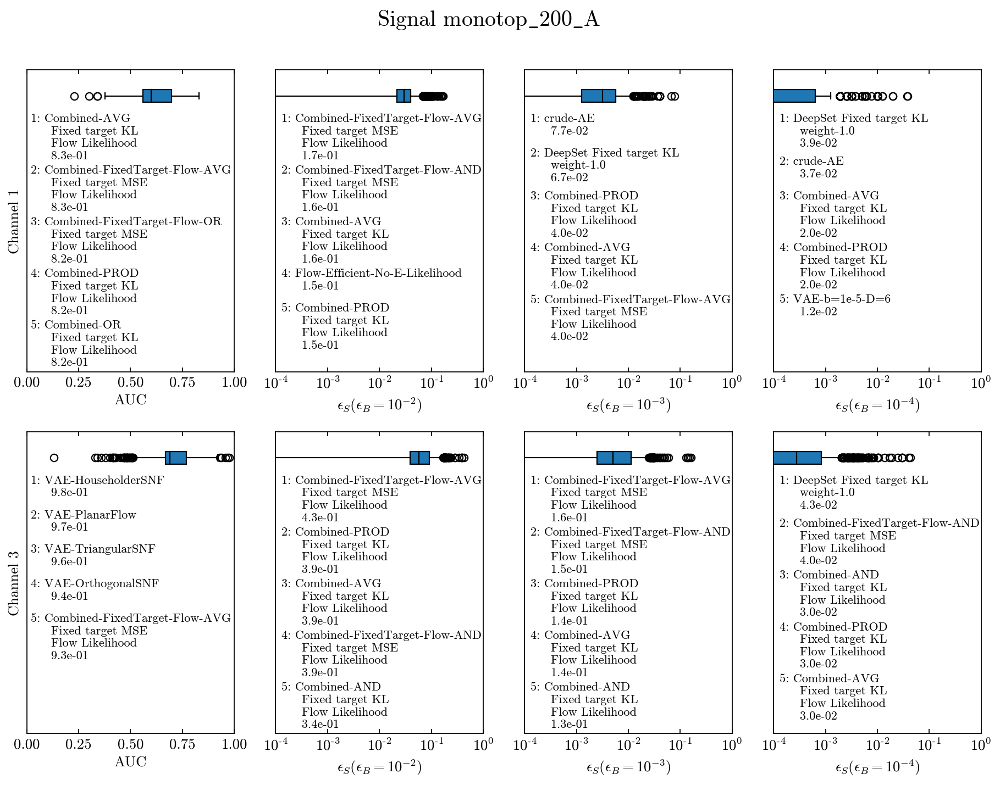

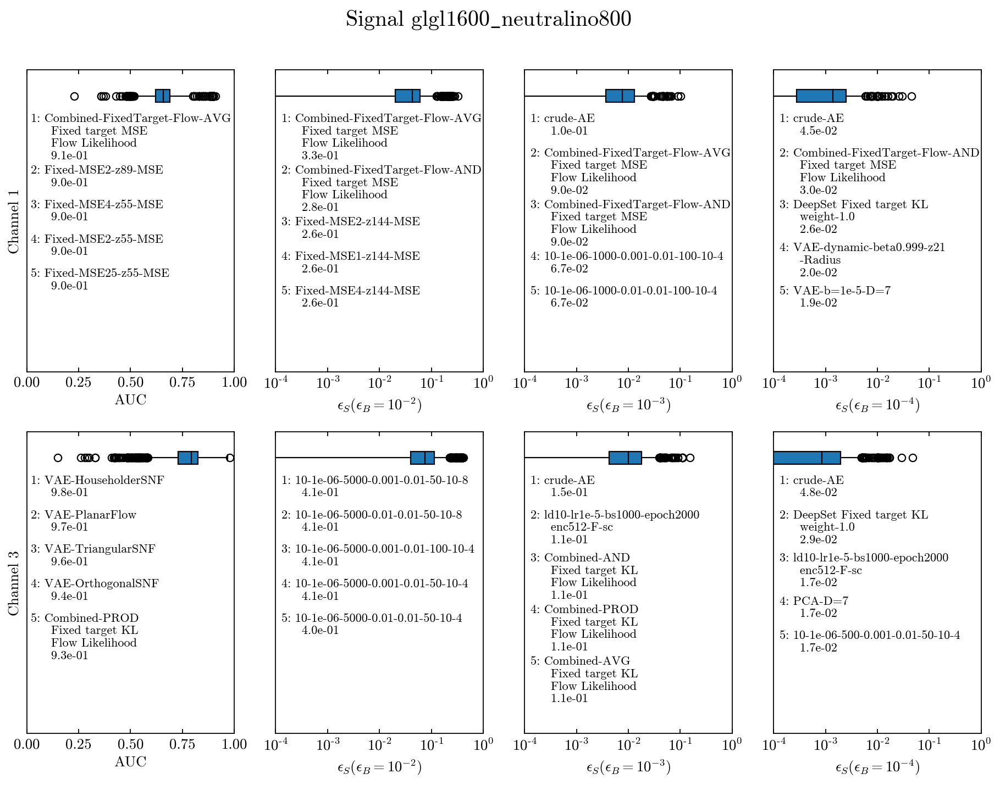

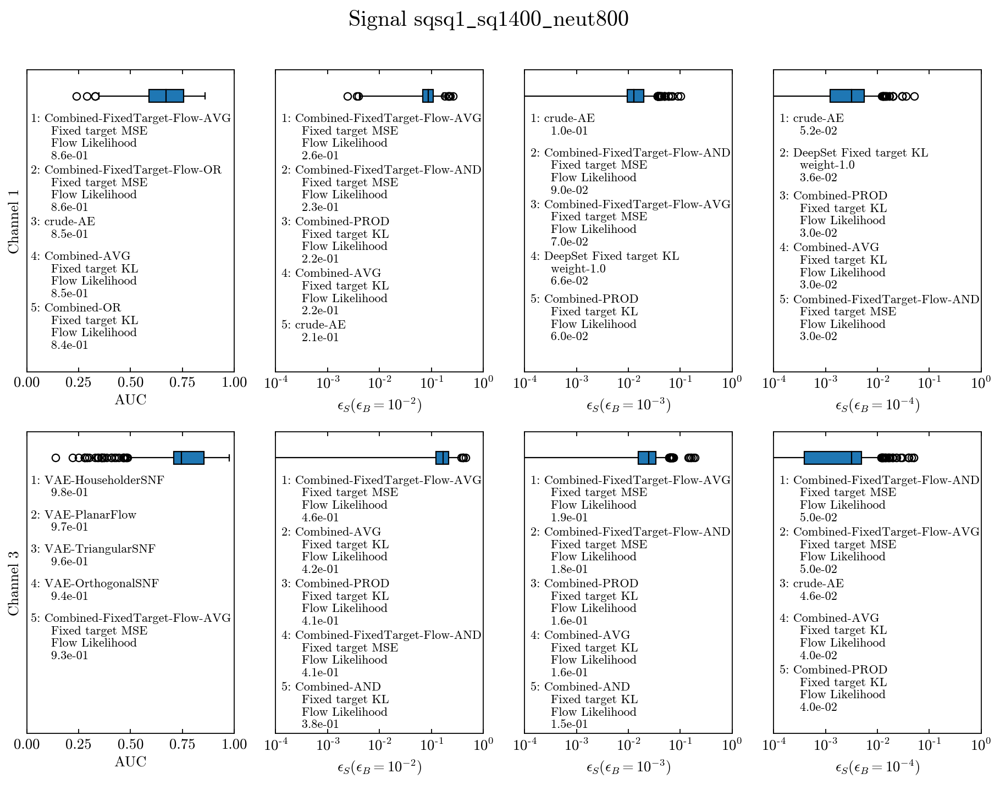

...

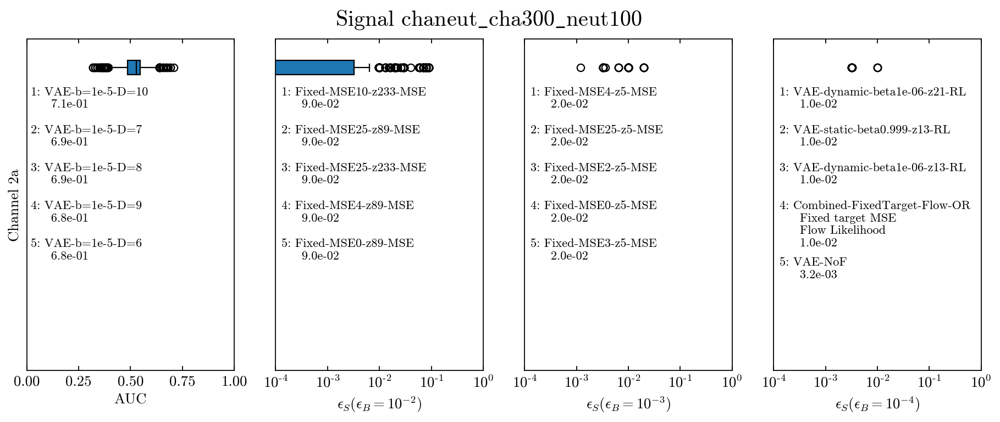

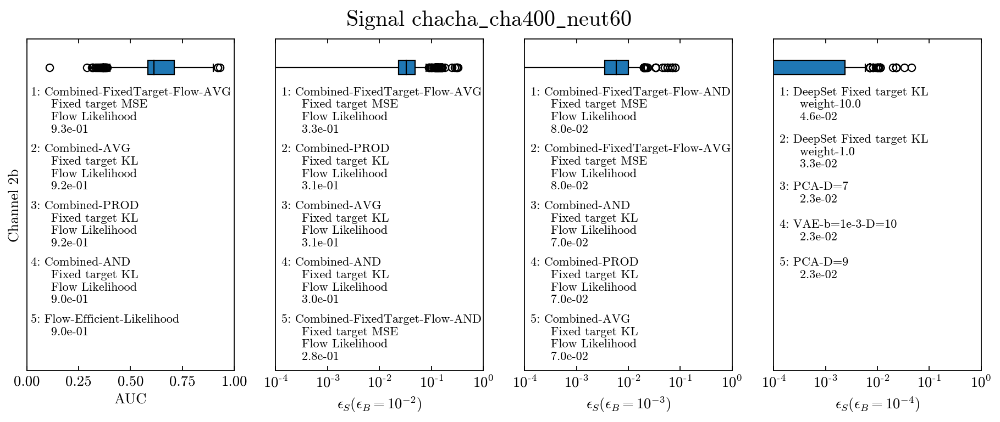

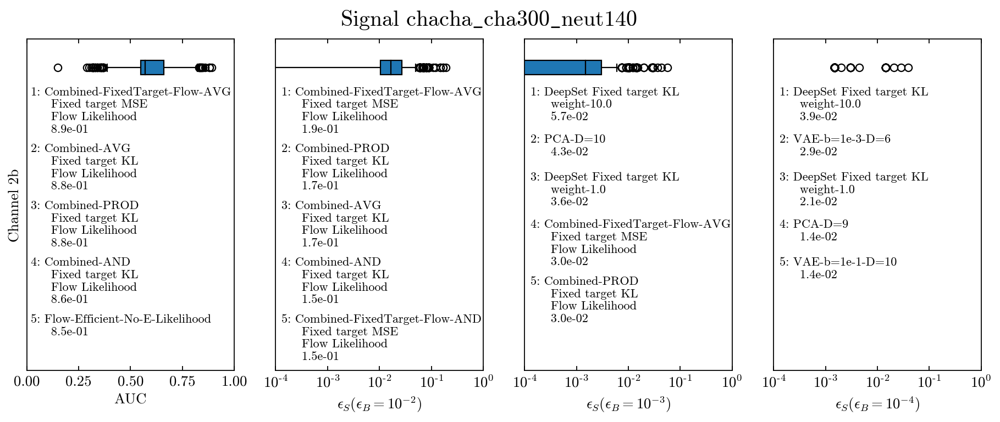

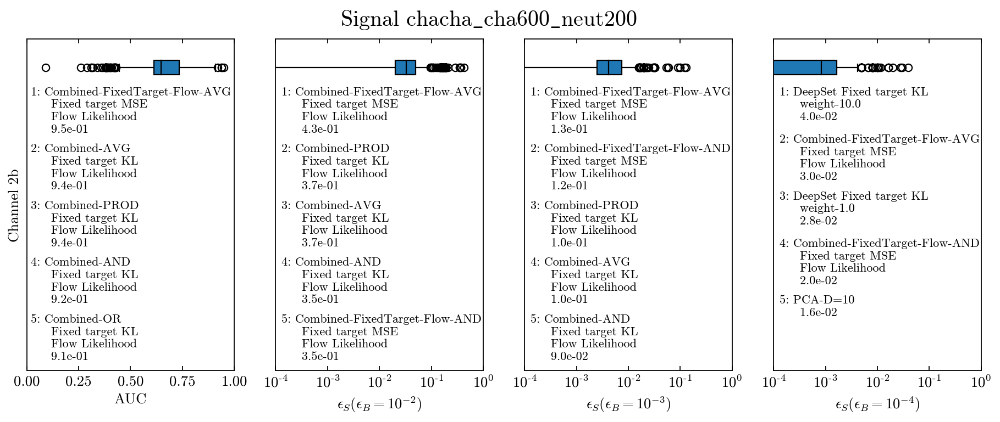

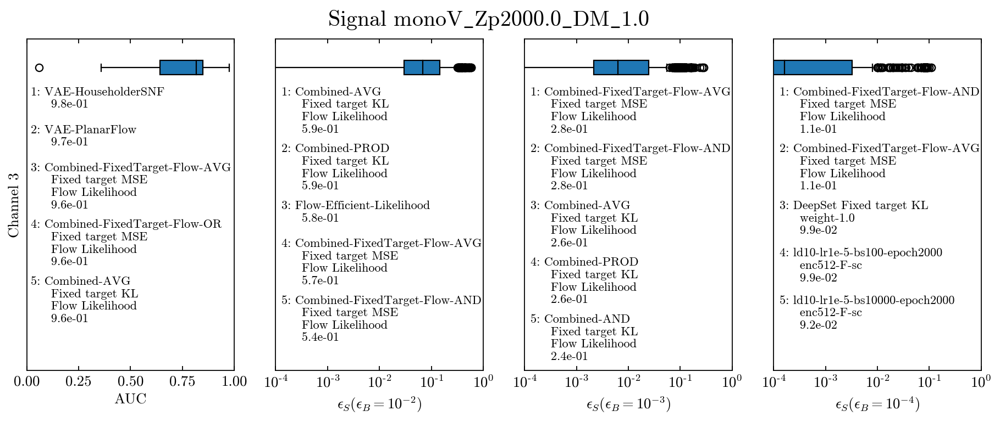

In [65]:
AllSigs = list(AllCombined['Signal'].unique())
for sig in AllSigs:
    tmp_df = AllCombined[AllCombined['Signal'] == sig]
    channels = list(tmp_df.Chan.unique())
    lc = len(channels)
    plt.figure(figsize=(3.5*4, 5.*lc))
    gs0 = gs.GridSpec(lc, 4, hspace=0.2)
    
    for i, chan in enumerate(channels):
        tmp_df = AllCombined[(AllCombined['Signal'] == sig) & (AllCombined['Chan'] == chan)]
        for j, metric in enumerate(['AUC', '1e-2', '1e-3', '1e-4']):
            plt.subplot(gs0[(i*4)+j])
            myones = np.ones(len(tmp_df))
#             plt.scatter(tmp_df[metric], myones, rasterized=True)
            plt.boxplot(np.array(tmp_df[metric]).reshape(-1, 1),
                        vert=False,
                        manage_ticks=False,
                        patch_artist=True,
                        medianprops={'color':'k'},
                        positions=[1.2]
                       )
            top_models = list(tmp_df.sort_values(by=metric, ascending=False)['Model'][:5])
            plt.ylim(-2, 1.5)
            base = 1
            for mn in range(5):
                change = 0.4
                mod = top_models[mn]
                if len(mod.split('+')) == 2:
                    change+=0.2
                elif 'enc' in mod:
                    change+=0.1
                elif 'DeepSet' in mod:
                    change+=0.1
                elif 'Radius' in mod:
                    change+=0.1
                    
                plt.text(0.02 if metric == 'AUC' else (np.log10(20))*1e-4,
                         base,
                         (f'{mn + 1}: {top_models[mn]}'.replace('+', '\n    ').replace('_','-')).replace('-Fixed target','\n     Fixed target').replace('-enc', '\n     enc').replace(' weight-', '\n     weight-').replace('-weight-', '\n     weight-').replace('-Radius', '\n     -Radius') + '\n    ' f" {float(tmp_df[tmp_df['Model']==top_models[mn]][metric]):.1e}",
                         fontsize=10,
                         ha='left',
                         va='top'
                        )
                base -= change
            if metric == 'AUC':
                plt.xlim(0, 1)
                plt.ylabel(f'Channel {chan}')
                plt.xlabel('AUC')
            else:
                plt.xlim(1e-4, 1)
                plt.xscale('log')
                plt.xticks([1e-4, 1e-3, 1e-2, 1e-1, 1])
                if metric == '1e-2':
                    plt.xlabel(r'$\epsilon_S(\epsilon_B = 10^{-2})$')
                if metric == '1e-3':
                    plt.xlabel(r'$\epsilon_S(\epsilon_B = 10^{-3})$')
                if metric == '1e-4':
                    plt.xlabel(r'$\epsilon_S(\epsilon_B = 10^{-4})$')
            plt.yticks([])
            
    plt.suptitle(f'Signal {sig}'.replace("_", r"$\_$"), fontsize=18, y=0.95)
#     plt.tight_layout()
    
    plt.savefig(f'IndividualSignal_{sig}.pdf', bbox_inches='tight')
    plt.show()



Combine into a single plot

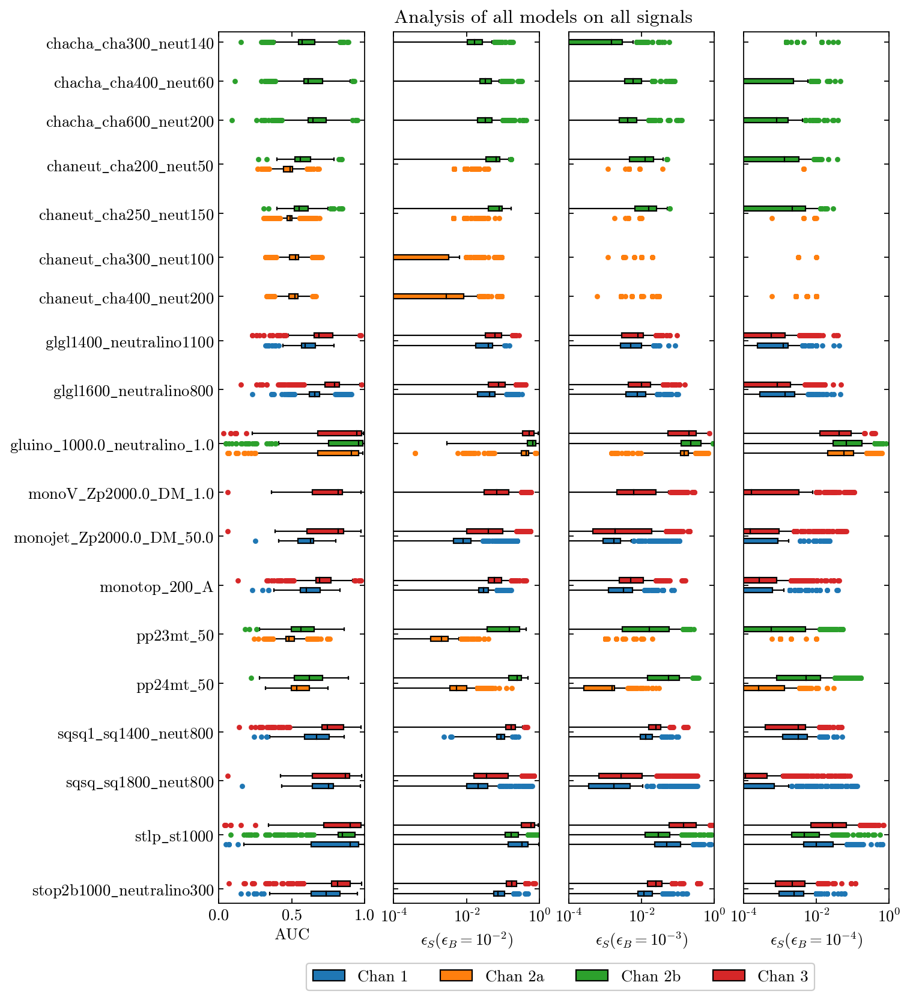

In [67]:
counter = 0
yvs = []
ListAUC = []
List1m2 = []
List1m3 = []
List1m4 = []
my_yticks = []
my_ynames = []
mycolors = []
colordict = {'1': 'C0', '2a': 'C1', '2b': 'C2', '3': 'C3'}
plt.figure(figsize=(9, 12))
for sig in np.sort(AllSigs)[::-1]:
    tmp_df = AllCombined[AllCombined['Signal'] == sig]
    channels = list(tmp_df.Chan.unique())
    lc = len(channels)
    
    tmp_yn = []
    for i, chan in enumerate(channels):
        tmp_df = AllCombined[(AllCombined['Signal'] == sig) & (AllCombined['Chan'] == chan)]
        
        ListAUC.append(tmp_df['AUC'])
        List1m2.append(tmp_df['1e-2'])
        List1m3.append(tmp_df['1e-3'])
        List1m4.append(tmp_df['1e-4'])
        yvs.append(counter)
        tmp_yn.append(counter)
        counter += 1
        mycolors.append(colordict[chan])
    counter += 3
    my_yticks.append(np.mean(tmp_yn))
    my_ynames.append(sig.replace('_', '$\_$'))
plt.subplot(1, 4, 1)    
bbox1 = plt.boxplot(np.array(ListAUC).T,
            vert=False,
            manage_ticks=False,
            patch_artist=True,
            medianprops={'color':'k'},
            positions=yvs
           )
plt.xlim(0, 1)
plt.yticks(my_yticks, my_ynames)
plt.xlabel('AUC')
for patch, flier, color in zip(bbox1['boxes'], bbox1['fliers'], mycolors):
    patch.set_facecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markersize(3)
    flier.set_markeredgecolor(color)
plt.ylim(min(yvs)-1, max(yvs)+1)

plt.subplot(1, 4, 2)    
bbox1 = plt.boxplot(np.array(List1m2).T,
            vert=False,
            manage_ticks=False,
            patch_artist=True,
            medianprops={'color':'k'},
            positions=yvs
           )
plt.xscale('log')
plt.xlim(1e-4, 1)
plt.yticks(my_yticks, [])
plt.xlabel(r'$\epsilon_S(\epsilon_B = 10^{-2})$')
for patch, flier, color in zip(bbox1['boxes'], bbox1['fliers'], mycolors):
    patch.set_facecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markersize(3)
    flier.set_markeredgecolor(color)
plt.ylim(min(yvs)-1, max(yvs)+1)

plt.subplot(1, 4, 3)    
bbox1 = plt.boxplot(np.array(List1m3).T,
            vert=False,
            manage_ticks=False,
            patch_artist=True,
            medianprops={'color':'k'},
            positions=yvs
           )
plt.xscale('log')
plt.xlim(1e-4, 1)
plt.yticks(my_yticks, [])
plt.xlabel(r'$\epsilon_S(\epsilon_B = 10^{-3})$')
for patch, flier, color in zip(bbox1['boxes'], bbox1['fliers'], mycolors):
    patch.set_facecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markersize(3)
    flier.set_markeredgecolor(color)
plt.ylim(min(yvs)-1, max(yvs)+1)

plt.subplot(1, 4, 4)    
bbox1 = plt.boxplot(np.array(List1m4).T,
            vert=False,
            manage_ticks=False,
            patch_artist=True,
            medianprops={'color':'k'},
            positions=yvs
           )
plt.xscale('log')
plt.xlim(1e-4, 1)
plt.yticks(my_yticks, [])
for patch, flier, color in zip(bbox1['boxes'], bbox1['fliers'], mycolors):
    patch.set_facecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markersize(3)
    flier.set_markeredgecolor(color)
plt.xlabel(r'$\epsilon_S(\epsilon_B = 10^{-4})$')
plt.ylim(min(yvs)-1, max(yvs)+1)
    
    
legend_elements = [Patch(facecolor='C0', edgecolor='k',
                         label='Chan 1'),
                   Patch(facecolor='C1', edgecolor='k',
                         label='Chan 2a'),
                   Patch(facecolor='C2', edgecolor='k',
                         label='Chan 2b'),
                   Patch(facecolor='C3', edgecolor='k',
                         label='Chan 3')
                  ]
plt.legend(handles=legend_elements, 
           loc=(-3, -0.1), 
           labelspacing=1,
           ncol=4,
           facecolor='white',
           framealpha=1,
#            markerscale=100,
           frameon=True)
    
plt.suptitle('Analysis of all models on all signals', y=0.9)
plt.savefig('../reports/Plots/AllModelsAllSignals.pdf', bbox_inches='tight')
plt.show()


# Summary of the summaries
To this point, it is still not obvious what the best model or metric is. To this end, we now define the significance improvement as 

$\rm{Base~Significance} = \frac{N_S }{N_B} = \frac{\sigma_S}{\sqrt{\sigma_B}}$

$\rm{Significance} = \rm{Significance~Improvement}\times\rm{Base~Significance} = \frac{N_S^{\rm{cut}}}{N_B^{\rm{cut}}} = \frac{\epsilon_S * \sigma_S}{\sqrt{\epsilon_B * \sigma_B}} = \frac{\epsilon_S }{\sqrt{\epsilon_B }} \times \rm{Base~Significance}$

In [68]:
AllCombined['SI_1e-2'] = AllCombined['1e-2'] / np.sqrt(1e-2)
AllCombined['SI_1e-3'] = AllCombined['1e-3'] / np.sqrt(1e-3)
AllCombined['SI_1e-4'] = AllCombined['1e-4'] / np.sqrt(1e-4)

AllCombined['SI_All'] = AllCombined[['SI_1e-2', 'SI_1e-3', 'SI_1e-4']].max(axis=1)

In [69]:
AllCombined.sort_values(by='SI_All', ascending=False)

,Signal,Model,Chan,AUC,1e-2,1e-3,1e-4,SI_1e-2,SI_1e-3,SI_1e-4,SI_All
16343,gluino_1000.0_neutralino_1.0,Combined-FixedTarget-Flow-AVG_Fixed target MSE...,2b,1,0.99,0.93,0.81,9.9,29.4092,81,81.0
16379,stlp_st1000,Combined-FixedTarget-Flow-AVG_Fixed target MSE...,3,1,0.94,0.88,0.7,9.4,27.828,70,70.0
16207,gluino_1000.0_neutralino_1.0,Combined-AVG_Fixed target KL + Flow Likelihood,2b,1,0.98,0.91,0.68,9.8,28.7767,68,68.0
16206,gluino_1000.0_neutralino_1.0,Combined-PROD_Fixed target KL + Flow Likelihood,2b,1,0.98,0.91,0.68,9.8,28.7767,68,68.0
16376,stlp_st1000,Combined-FixedTarget-Flow-AND_Fixed target MSE...,3,0.99,0.93,0.85,0.68,9.3,26.8794,68,68.0
...,...,...,...,...,...,...,...,...,...,...,...
26439,chaneut_cha400_neut200,20_1e-06_1000_0.001_0.001_100_10_8,2a,0.532612,0,0,0,0,0,0,0.0
26438,chaneut_cha250_neut150,20_1e-06_1000_0.001_0.001_100_10_8,2a,0.486814,0,0,0,0,0,0,0.0
26437,chaneut_cha300_neut100,20_1e-07_500_0.001_0.01_50_10_4,2a,0.537387,0,0,0,0,0,0,0.0
26436,chaneut_cha200_neut50,20_1e-07_500_0.001_0.01_50_10_4,2a,0.509986,0,0,0,0,0,0,0.0


In [70]:
AllMods = list(AllCombined['Model'].unique())
SI_DF = pd.DataFrame()
SI_DF['Model'] = AllMods

for sig in AllSigs:
    si_list = []
    for mod in AllMods:
        tmp_df = AllCombined[(AllCombined['Model'] == mod)]
        si_list.append(tmp_df[tmp_df['Signal'] == sig]['SI_All'].max())
    SI_DF[sig] = si_list
#     plt.scatter(np.min(si_list), np.max(si_list))
# plt.show()

In [71]:
SI_DF['MinSigI'] = SI_DF[[col for col in SI_DF if 'Model' not in col]].min(axis=1)
SI_DF['MaxSigI'] = SI_DF[[col for col in SI_DF if (('Model' not in col) and ('MinSigI' not in col))]].max(axis=1)
SI_DF['MedianSigI'] = SI_DF[[col for col in SI_DF if (('Model' not in col) and ('MinSigI' not in col) and ('MaxSigI' not in col))]].median(axis=1)

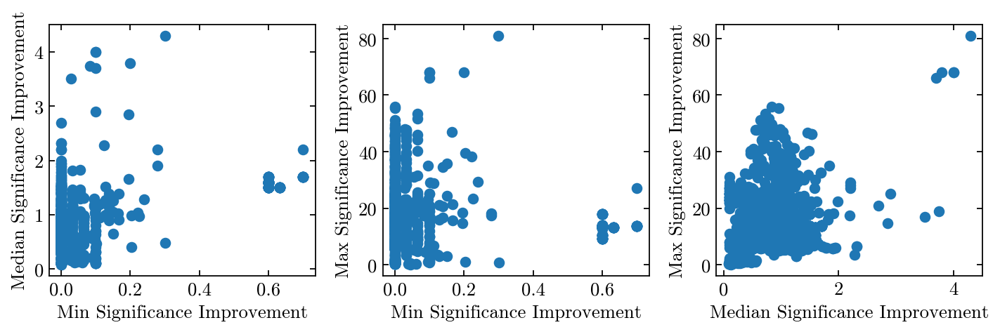

In [72]:
plt.figure(figsize=(9, 3))

plt.subplot(1, 3, 1)
plt.scatter(SI_DF['MinSigI'], SI_DF['MedianSigI'])
plt.xlabel('Min Significance Improvement')
plt.ylabel('Median Significance Improvement')

plt.subplot(1, 3, 2)
plt.scatter(SI_DF['MinSigI'], SI_DF['MaxSigI'])
plt.xlabel('Min Significance Improvement')
plt.ylabel('Max Significance Improvement')

plt.subplot(1, 3, 3)
plt.scatter(SI_DF['MedianSigI'], SI_DF['MaxSigI'])
plt.xlabel('Median Significance Improvement')
plt.ylabel('Max Significance Improvement')

plt.tight_layout()

In [73]:
from sklearn.cluster import KMeans, DBSCAN
from sklearn.preprocessing import MinMaxScaler

In [77]:
normed_data=SI_DF[['MinSigI', 'MedianSigI', 'MaxSigI']].copy()
mms = MinMaxScaler()
normed_data = mms.fit_transform(normed_data)

In [78]:
kmint = 6
km = KMeans(n_clusters=kmint, random_state=0)

In [79]:
SI_DF['km6'] = km.fit_predict(normed_data)

In [80]:
kmlist = np.argsort([np.sum(SI_DF['km6'] == i) for i in range(6)])
for i, k in enumerate(kmlist):
    SI_DF.loc[SI_DF['km6'] == i,'km'] = k

In [81]:
list(SI_DF[SI_DF['km']==5]['Model'])

['IF_13_0.001_1000',
 'IF_13_0.1_10000',
 'IF_13_1.0_10000',
 'IF_13_1e-05_10000',
 'IF_20_0.001_1000',
 'IF_20_1.0_10000',
 'IF_20_1e-05_1000',
 'IF_30_0.001_1000',
 'IF_30_0.001_10000',
 'IF_30_0.1_1000',
 'IF_30_1.0_1000',
 'IF_30_1e-05_1000',
 'IF_30_1e-05_10000',
 'IF_4_0.001_1000',
 'IF_4_0.1_1000',
 'IF_4_0.1_10000',
 'GMM_13_0.001_1000',
 'GMM_13_0.001_10000',
 'GMM_13_0.1_10000',
 'GMM_13_1.0_1000',
 'GMM_13_1.0_10000',
 'GMM_13_1e-05_1000',
 'GMM_20_0.001_1000',
 'GMM_20_0.1_1000',
 'GMM_20_0.1_10000',
 'GMM_20_1.0_1000',
 'GMM_20_1.0_10000',
 'GMM_20_1e-05_1000',
 'GMM_30_0.001_1000',
 'GMM_30_0.001_10000',
 'GMM_30_0.1_10000',
 'GMM_30_1.0_1000',
 'GMM_30_1.0_10000',
 'GMM_30_1e-05_1000',
 'GMM_4_0.001_1000',
 'GMM_4_0.001_10000',
 'GMM_4_0.1_1000',
 'GMM_4_1.0_1000',
 'GMM_4_1.0_10000',
 'GMM_4_1e-05_10000',
 'AE_13_0.001_1000',
 'AE_13_0.001_10000',
 'AE_13_0.1_10000',
 'AE_13_1.0_1000',
 'AE_13_1.0_10000',
 'AE_13_1e-05_1000',
 'AE_13_1e-05_10000',
 'AE_20_0.001_1000',
 

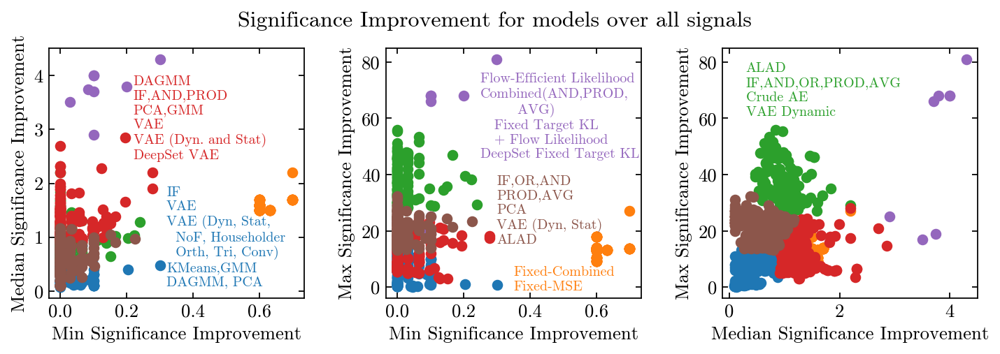

In [82]:
plt.figure(figsize=(9, 3))

plt.subplot(1, 3, 1)
for i in range(kmint):
    tmpdf=SI_DF[SI_DF['km']==i]
    plt.scatter(tmpdf['MinSigI'], tmpdf['MedianSigI'], color=f'C{i}', rasterized=True)
plt.xlabel('Min Significance Improvement')
plt.ylabel('Median Significance Improvement')

plt.text(0.32, 0.05, 'IF\nVAE\nVAE (Dyn, Stat,\n  NoF, Householder\n  Orth, Tri, Conv)\nKMeans,GMM\nDAGMM, PCA', ha='left', va='bottom', fontsize=9, color='C0')
plt.text(0.22 , 2.4, 'DAGMM\nIF,AND,PROD\nPCA,GMM\nVAE\nVAE (Dyn. and Stat)\nDeepSet VAE', ha='left', va='bottom', fontsize=9, color='C3')

plt.subplot(1, 3, 2)
for i in range(kmint):
    tmpdf=SI_DF[SI_DF['km']==i]
    plt.scatter(tmpdf['MinSigI'], tmpdf['MaxSigI'], color=f'C{i}', rasterized=True)
plt.xlabel('Min Significance Improvement')
plt.ylabel('Max Significance Improvement')
plt.text(0.25, 45, 'Flow-Efficient Likelihood\nCombined(AND,PROD,\n        AVG)\n   Fixed Target KL\n   + Flow Likelihood'+\
         '\nDeepSet Fixed Target KL', ha='left', va='bottom', fontsize=9, color='C4')
plt.text(0.35, 7.5, 'Fixed-Combined\nFixed-MSE', ha='left', va='top', fontsize=9, color='C1')

plt.text(0.3, 40, 'IF,OR,AND\nPROD,AVG\nPCA\nVAE (Dyn, Stat)\nALAD', ha='left', va='top', fontsize=9, color='C5')



plt.subplot(1, 3, 3)
for i in range(kmint):
    tmpdf=SI_DF[SI_DF['km']==i]
    plt.scatter(tmpdf['MedianSigI'], tmpdf['MaxSigI'], color=f'C{i}', rasterized=True)
plt.xlabel('Median Significance Improvement')
plt.ylabel('Max Significance Improvement')
plt.text(0.3, 60, 'ALAD\nIF,AND,OR,PROD,AVG\nCrude AE\nVAE Dynamic'
         , ha='left', va='bottom', fontsize=9, color='C2')


plt.tight_layout()
plt.suptitle('Significance Improvement for models over all signals' , y=1.05)  # ' + ' $(\epsilon_S / \sqrt{\epsilon_B})$' + '

plt.savefig('SummaryOfSummaries.pdf', bbox_inches='tight')
plt.show()

In [83]:
from mpl_toolkits.mplot3d import Axes3D 

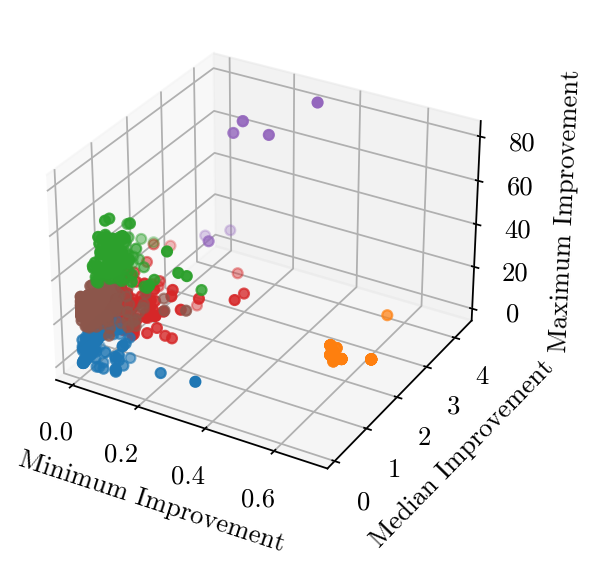

In [84]:
fig = plt.figure(figsize=(4, 4))
ax = plt.subplot(1, 1, 1, projection='3d')
for i in range(kmint):
    tmpdf=SI_DF[SI_DF['km']==i]
    ax.scatter(xs=tmpdf['MinSigI'], ys=tmpdf['MedianSigI'], zs=tmpdf['MaxSigI'], color=f'C{i}')

ax.set_xlabel('Minimum Improvement')
ax.set_ylabel('Median Improvement')
ax.set_zlabel('Maximum Improvement')
# ax.view_init(30, 90)
fig.canvas.toolbar_visible = True
display(fig.canvas)
plt.savefig('Summary_3d.pdf', bbox_inches='tight')

We now want to run the models which have a meidan improvement of at least 2.0 on the secret dataset. Find these models to alert those who need to analyze the next dataset.

In [85]:
highscores = list(SI_DF[SI_DF['MedianSigI'] > 2]['Model'])
BaseModels = [
    ['PJ', PJ['Model']],
    ['AM',  AM['Model']],
    ['LH_VAE', LH_VAE['Model']],
    ['LH_Flow', LH_Flow['Model']],
    ['LH_Combined', LH_Combined['Model']],
    ['LH_Combined2', LH_Combined2['Model']],
    ['LH_Fixed', LH_Fixed['Model']],
    ['BO', BO['Model']],
    ['RR_ALAD', RR_ALAD['Model']],
    ['RR_DAGM', RR_DAGM['Model']],
    ['BR', BR['Model']],
    ['JD_VAE', JD_VAE['Model']],
    ['JD_BVAE', JD_BVAE['Model']]
]

topmethods = []
for person, models in BaseModels:
    models = models.unique()
    for model in models:
        for hs in highscores:
            if hs == model:
                print(person, hs, SI_DF[SI_DF['Model']==model]['MedianSigI'])
                topmethods.append([person, hs, float(SI_DF[SI_DF['Model']==model]['MedianSigI'])])

PJ VAE_PlanarFlow 289    2.283526
Name: MedianSigI, dtype: float64
LH_VAE VAE-dynamic-beta1-z13_Radius 462    2.2
Name: MedianSigI, dtype: float64
LH_Flow Flow-Efficient_Likelihood 471    2.9
Name: MedianSigI, dtype: float64
LH_Flow Flow-Efficient-No-E_Likelihood 472    2.7
Name: MedianSigI, dtype: float64
LH_Combined Combined-AND_Fixed target KL + Flow Likelihood 474    3.7
Name: MedianSigI, dtype: float64
LH_Combined Combined-OR_Fixed target KL + Flow Likelihood 475    2.2
Name: MedianSigI, dtype: float64
LH_Combined Combined-PROD_Fixed target KL + Flow Likelihood 476    4.0
Name: MedianSigI, dtype: float64
LH_Combined Combined-AVG_Fixed target KL + Flow Likelihood 477    4.0
Name: MedianSigI, dtype: float64
LH_Combined2 Combined-FixedTarget-Flow-AND_Fixed target MSE + Flow Likelihood 478    3.794733
Name: MedianSigI, dtype: float64
LH_Combined2 Combined-FixedTarget-Flow-OR_Fixed target MSE + Flow Likelihood 479    2.2
Name: MedianSigI, dtype: float64
LH_Combined2 Combined-FixedTarge

In [86]:
sortedargs = np.argsort(np.array(topmethods)[:, 2].astype(float))

In [87]:
with open('HighMedianScores.txt', 'w') as f:
    f.write('File, Model, MedianSignificanceImprovement\n')
    for arg in sortedargs:
        print(', '.join(np.array(topmethods[arg])))
        f.write(', '.join(np.array(topmethods[arg])))
        f.write('\n')


RR_ALAD, ld10_lr1e-5_bs5000_epoch2000_enc512_F_sc, 2.198706643151088
LH_VAE, VAE-dynamic-beta1-z13_Radius, 2.1999999999999997
LH_Combined2, Combined-FixedTarget-Flow-OR_Fixed target MSE + Flow Likelihood, 2.1999999999999997
LH_Combined, Combined-OR_Fixed target KL + Flow Likelihood, 2.1999999999999997
PJ, VAE_PlanarFlow, 2.283526101906846
RR_DAGM, 10_1e-07_1000_0.01_0.01_50_15_8, 2.314541850035057
RR_DAGM, 10_1e-07_1000_0.001_0.01_50_15_8, 2.314541850035057
LH_Flow, Flow-Efficient-No-E_Likelihood, 2.7
RR_ALAD, ld10_lr1e-5_bs500_epoch2000_enc512_F_sc, 2.8511530398322846
LH_Flow, Flow-Efficient_Likelihood, 2.8999999999999995
BO, DeepSet Fixed target KL weight_1.0, 3.503582933762497
LH_Combined, Combined-AND_Fixed target KL + Flow Likelihood, 3.6999999999999997
BO, DeepSet Fixed target KL weight_10.0, 3.74761070720423
LH_Combined2, Combined-FixedTarget-Flow-AND_Fixed target MSE + Flow Likelihood, 3.7947331922020555
LH_Combined, Combined-AVG_Fixed target KL + Flow Likelihood, 4.0
LH_Combin

Make a summary plot from the group with the highest improvements.

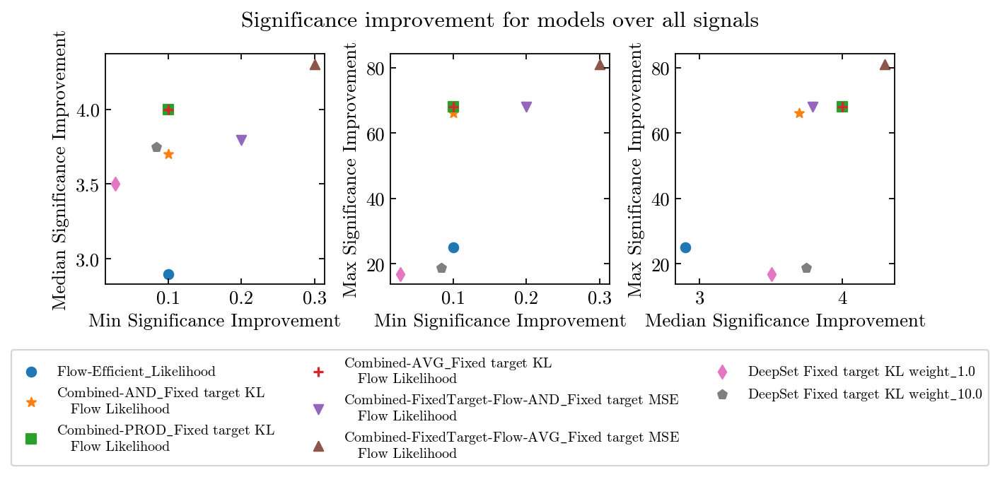

In [88]:
plt.figure(figsize=(9, 4))
gs0 = gs.GridSpec(2, 1, height_ratios=[3, 1])
gs00 = gs.GridSpecFromSubplotSpec(1, 3, gs0[0], wspace=0.3, hspace=5)
i=4
plt.subplot(gs00[0])
markerdict = {0: 'o',
              1: '*',
              2: 's',
              3: '+',
              4: 'v',
              5: '^',
              6: 'd',
              7: 'p'
             }

tmpdf=SI_DF[SI_DF['km']==i]
for kk, mod in enumerate(list(tmpdf['Model'])):
    tmpdf2=tmpdf[tmpdf['Model'] == mod]
    plt.scatter(tmpdf2['MinSigI'], tmpdf2['MedianSigI'], color=f'C{kk}',
                marker=markerdict[kk]
               )
#     plt.text(tmpdf2['MinSigI'], tmpdf2['MedianSigI'], mod.replace('VAE_beta_1.0', 'Fixed KL').replace('+', '\n'),
#              fontsize=8,
#              ha='left' if float(tmpdf2['MinSigI']) < 0.04 else 'right'
#             )
plt.xlabel('Min Significance Improvement')
plt.ylabel('Median Significance Improvement')

plt.subplot(gs00[1])

tmpdf=SI_DF[SI_DF['km']==i]
for kk, mod in enumerate(list(tmpdf['Model'])):
    tmpdf2=tmpdf[tmpdf['Model'] == mod]
    plt.scatter(tmpdf2['MinSigI'], tmpdf2['MaxSigI'], color=f'C{kk}', label=mod.replace('VAE_beta_1.0', '-Fixed KL').replace('_', r'$\_$').replace('+', '\n'),
               marker=markerdict[kk])
plt.xlabel('Min Significance Improvement')
plt.ylabel('Max Significance Improvement')

# legend_elements = [Patch(facecolor='C0', edgecolor='k',
#                          label=),
#                    Patch(facecolor='C1', edgecolor='k',
#                          label='Chan 2a'),
#                    Patch(facecolor='C2', edgecolor='k',
#                          label='Chan 2b'),
#                    Patch(facecolor='C3', edgecolor='k',
#                          label='Chan 3')
#                   ]
# plt.legend(labelspacing=1,
# #            ncol=1,
#            facecolor='white',
#            framealpha=1,
#            fontsize=9,
# #            markerscale=100,
#            frameon=True)

plt.subplot(gs00[2])

tmpdf=SI_DF[SI_DF['km']==i]
for kk, mod in enumerate(list(tmpdf['Model'])):
    tmpdf2=tmpdf[tmpdf['Model'] == mod]
    plt.scatter(tmpdf2['MedianSigI'], tmpdf2['MaxSigI'], 
                color=f'C{kk}',
                marker=markerdict[kk]
               )
plt.xlabel('Median Significance Improvement')
plt.ylabel('Max Significance Improvement')

plt.subplot(gs0[1])
for kk, mod in enumerate(list(tmpdf['Model'])):
    tmpdf2=tmpdf[tmpdf['Model'] == mod]
    plt.scatter([], [], color=f'C{kk}',
                marker=markerdict[kk],
                label=mod.replace('VAE_beta_1.0', '-Fixed KL').replace('_', r'$\_$').replace('+', '\n  '),
               )
plt.legend(fontsize=9,
           loc='center',
           ncol=3
          )
plt.axis('off')

plt.tight_layout(w_pad=10)
plt.suptitle('Significance improvement for models over all signals' , y=1.05)  # ' + ' $(\epsilon_S / \sqrt{\epsilon_B})$' + '

plt.savefig('SummaryOfSummaries_best.pdf', bbox_inches='tight')
plt.show()

Finally, make a summary plot for the physics models.

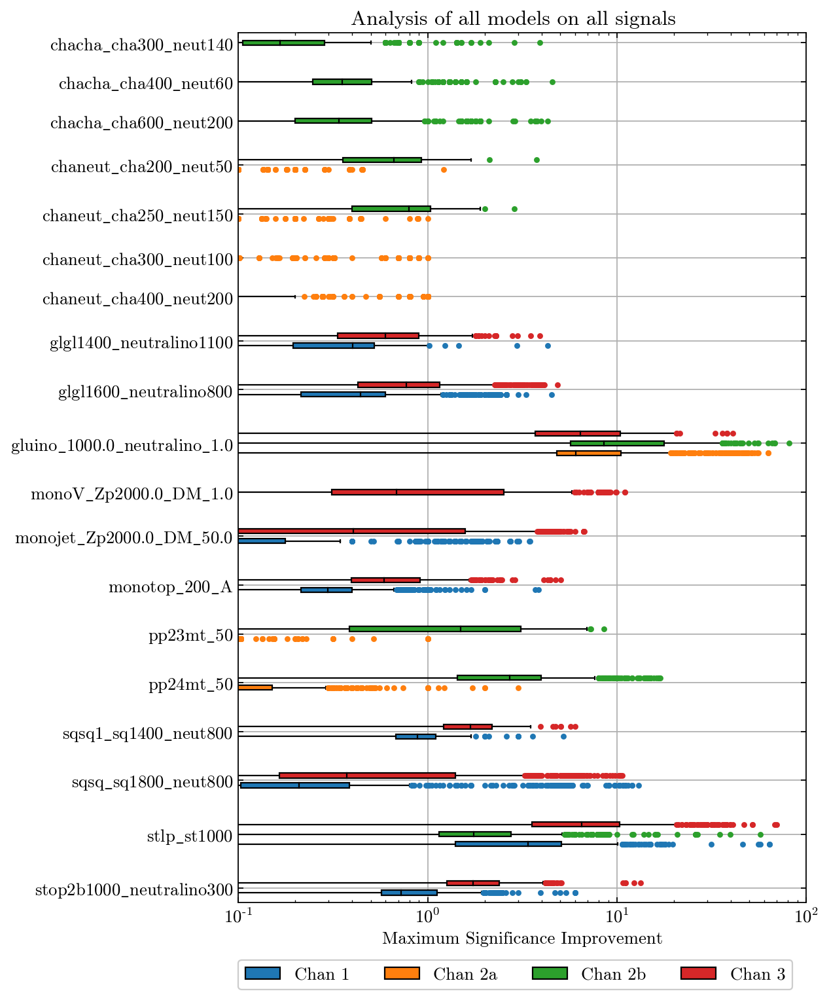

In [89]:
counter = 0
yvs = []
ListSigImp = []
my_yticks = []
my_ynames = []
mycolors = []
colordict = {'1': 'C0', '2a': 'C1', '2b': 'C2', '3': 'C3'}
plt.figure(figsize=(7, 11))
for sig in np.sort(AllSigs)[::-1]:
    tmp_df = AllCombined[AllCombined['Signal'] == sig]
    channels = list(tmp_df.Chan.unique())
    lc = len(channels)
    
    tmp_yn = []
    
    for i, chan in enumerate(channels):
        tmp_df = AllCombined[(AllCombined['Signal'] == sig) & (AllCombined['Chan'] == chan)]
        ListSigImp.append(tmp_df['SI_All'])
        yvs.append(counter)
        tmp_yn.append(counter)
        counter += 1
        mycolors.append(colordict[chan])
    counter += 3
    my_yticks.append(np.mean(tmp_yn))
    my_ynames.append(sig.replace('_', '$\_$'))
# plt.subplot(1, 4, 1)    
bbox1 = plt.boxplot(np.array(ListSigImp).T,
            vert=False,
            manage_ticks=False,
            patch_artist=True,
            medianprops={'color':'k'},
            positions=yvs
           )
plt.yticks(my_yticks, my_ynames)
plt.xlabel('Maximum Significance Improvement')
for patch, flier, color in zip(bbox1['boxes'], bbox1['fliers'], mycolors):
    patch.set_facecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markersize(3)
    flier.set_markeredgecolor(color)
plt.ylim(min(yvs)-1, max(yvs)+1)
plt.xscale('log')
plt.xlim(0.1, 100)
plt.grid()
    
    
legend_elements = [Patch(facecolor='C0', edgecolor='k',
                         label='Chan 1'),
                   Patch(facecolor='C1', edgecolor='k',
                         label='Chan 2a'),
                   Patch(facecolor='C2', edgecolor='k',
                         label='Chan 2b'),
                   Patch(facecolor='C3', edgecolor='k',
                         label='Chan 3')
                  ]
plt.legend(handles=legend_elements, 
           loc=(-0.0, -0.1), 
           labelspacing=1,
           ncol=4,
           facecolor='white',
           framealpha=1,
#            markerscale=100,
           frameon=True)
    
plt.suptitle('Analysis of all models on all signals', y=0.9)
plt.savefig('../reports/Plots/AllModelsAllSignals_SignificanceImprovement.pdf', bbox_inches='tight')
plt.show()
